<a href="https://colab.research.google.com/github/karasevdy/pet_projects/blob/main/Gorky_2024.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install natasha
!pip install gensim

  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 34.4/34.4 MB 44.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.7/46.7 kB 3.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 55.5/55.5 kB 3.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.2/8.2 MB 88.4 MB/s eta 0:00:00
  Created wheel for docopt: filename=docopt-0.6.2-py2.py3-none-any.whl size=13706 sha256=1aa33413b524a05645e033d0cfcd8e6745939c02e4aa57bdd7b5c329d4e3a4fa
  Stored in directory: /root/.cache/pip/wheels/fc/ab/d4/5da2067ac95b36618c629a5f93f809425700506f72c9732fac
  Created wheel for intervaltree: filename=intervaltree-3.1.0-py2.py3-none-any.whl size=26097 sha256=00493944409affdd3003de3aed407381ae8532866e41936200f8591b3f663ddf
  Stored in directory: /root/.cache/pip/wheels/fa/80/8c/43488a924a046b733b64de3fac99252674c892a4c3801c0a61
Successfully built docopt intervaltree


In [2]:
import random
import requests
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd
import time as t
import re # Регулярные выражения
# для рандомизации времени засыпания
from random import randint
from tqdm import tqdm_notebook
from wordcloud import WordCloud, STOPWORDS # облако слов
from sklearn.preprocessing import MultiLabelBinarizer # для dummy
from collections import Counter # счетчик для списков
from collections import defaultdict # как обычный словарь, только вызывает значения
import gensim # NLP библиотека (TFIDF, W2T, D2T, FastText, LSA, LDA и т.д.)
import pymorphy2 # лемматизатор
from nltk import word_tokenize # токенизатор
from nltk.corpus import stopwords # стоп-слова
from gensim.corpora import Dictionary # создания словаря частотности токенов в тексте
from tqdm import tqdm # индикатор выполнения
from nltk import word_tokenize # токенизатор
from nltk.corpus import stopwords # стоп-слова
from gensim.corpora import Dictionary # создания словаря частотности токенов в тексте


# fake_user + bs4

# импортировали  методов этой библиотеки
#from fake_useragent import UserAgent
# импортировали библиотеку
#from bs4 import BeautifulSoup

# selenium + ChromeDriverManager

#from selenium import webdriver
# A Service class that is responsible for the starting and stopping of chromedriver.
#from selenium.webdriver.chrome.service import Service
#from selenium.webdriver.chrome.options import Options
#from selenium.webdriver.common.by import By
#from selenium.webdriver.support.ui import WebDriverWait
#from selenium.webdriver.support import expected_conditions as EC

 #      имп ортировали ChromeDriverManager чтобы получить chromedriver path
#from webdriver_manager.chrome import ChromeDriverManager

# отключение предупреждений
import warnings
warnings.filterwarnings("ignore")

# Наташа и кишки
from natasha import (
    Segmenter,
    NewsEmbedding,
    NewsMorphTagger,
    NewsSyntaxParser,
    Doc,
    NewsNERTagger,
    MorphVocab,
    PER
)

segmenter = Segmenter()
morph_vocab = MorphVocab()

emb = NewsEmbedding()
morph_tagger = NewsMorphTagger(emb)
syntax_parser = NewsSyntaxParser(emb)
ner_tagger = NewsNERTagger(emb)

## EDA

In [ ]:
df = pd.read_csv(r'gorky_join_df.csv')

In [ ]:
len(df)

4253

In [ ]:
df.sample(10)

,Unnamed: 0,url,author,publ_date,title,subtitle,description,text,month_year,title_len,cl_text,text_len,rubric,year
1591,1624,https://gorky.media/context/goncharov-ploho-pi...,Мария Нестеренко,2018-07-18,"«Гончаров плохо писал, но хорошо вычеркивал»","Интервью с Алексеем Балакиным, специалистом по...","Кто такие пепиньерки, как была найдена неизвес...","Расскажите, пожалуйста, вкратце о вашей новой ...",2018-07,6,"Расскажите, пожалуйста, вкратце о вашей новой ...",2813,context,2018
2907,2948,https://gorky.media/reviews/katastrofa-sravnim...,Алеша Рогожин,2021-10-13,"Катастрофа, сравнимая с блокадой Ленинграда","О книге Елизаветы Хатанзейской, посвященной А...",Темой монографии Елизаветы Хатанзейской «Сове...,Елизавета Хатанзейская. Советский город в эк...,2021-10,5,Елизавета Хатанзейская. Советский город в эк...,1744,reviews,2021
2380,2419,https://gorky.media/reviews/hitraya-vodoplavay...,Виктор Ковалев,2023-10-02,Хитрая водоплавающая птица XVI века,О книге Натали Земон Дэвис «Путешествия трикст...,Книга Натали Дэвис «Путешествия трикстера. Мус...,\nНатали Земон Дэвис. Путешествия трикстера. ...,2023-10,5,Натали Земон Дэвис. Путешествия трикстера. М...,2480,reviews,2023
3223,3264,https://gorky.media/reviews/pohozhdeniya-yapon...,Александр Мещеряков,2020-12-24,Похождения японского Казановы,Александр Мещеряков — о веселом и нескромном р...,Япония второй половины XVII века — страна стро...,Ихара Сайкаку. Любовные похождения одинокого м...,2020-12,3,Ихара Сайкаку. Любовные похождения одинокого м...,1349,reviews,2020
1386,1418,https://gorky.media/context/voobrazhenie-sposo...,Incognito,2019-02-08,Воображение — способность унижать дела Бога,"Джон Рёскин об искусстве, таинственной природе...","Ровно 200 лет назад, 8 февраля 1819 года, в Ло...","***\nКартина, цель которой — истолкование прир...",2019-02,6,"*** Картина, цель которой — истолкование приро...",1580,context,2019
3249,3290,https://gorky.media/reviews/raskachaj-tantspol...,Артур Гранд,2020-12-02,"Раскачай танцпол, спаси мою жизнь: четыре важн...",Главные тексты об электронной музыке и клубной...,"Диджей в идеале не просто человек, ставящий пл...","Билл Брюстер, Фрэнк Броутон. История диджеев. ...",2020-12,10,"Билл Брюстер, Фрэнк Броутон. История диджеев. ...",2573,reviews,2020
2425,2464,https://gorky.media/reviews/sny-o-huane-ortiga...,Incognito,2023-07-21,Сны о Хуане Ортигане: книги недели,Что спрашивать в книжных,"Антиромантичная история пиратства, чрезвычайно...",\nПитер Лер. История пиратства: от викингов д...,2023-07,6,Питер Лер. История пиратства: от викингов до...,1040,reviews,2023
2922,2963,https://gorky.media/reviews/neveroyatnyj-trehg...,Раймонд Крумгольд,2021-09-29,Невероятный трехголовый Виктор Цой,О книге Дмитрия Мишенина «Реаниматор культовог...,В книгу художника Дмитрия Мишенина «Реаниматор...,Дмитрий Мишенин. Реаниматор культового кино. М...,2021-09,4,Дмитрий Мишенин. Реаниматор культового кино. М...,1681,reviews,2021
2494,2533,https://gorky.media/reviews/obedayas-razlagayu...,Incognito,2023-04-07,Объедаясь разлагающимися трупами: книги недели,Что спрашивать в книжных,"«Письма о литературе» Горького, еще одна истор...",\nМонастырь и тюрьма. Места заключения в Запа...,2023-04,5,Монастырь и тюрьма. Места заключения в Запад...,1398,reviews,2023
623,640,https://gorky.media/context/aleksandr-gabriche...,Константин Митрошенков,2021-06-01,Александр Габричевский и советский интеллектуа...,Сокращенная расшифровка выступления литературо...,Советский консерватизм обычно связывают с этат...,Александр Габричевский всю жизнь колебался меж...,2021-06,6,Александр Габричевский всю жизнь колебался меж...,1427,context,2021


In [ ]:
df = df.drop('Unnamed: 0', axis=1)

In [ ]:
# к формату даты
df['publ_date'] = pd.to_datetime(df['publ_date'], format='%Y-%m-%d')

In [ ]:
# сделали округление до месяца года
df['month_year'] = pd.to_datetime(df['publ_date']).dt.to_period('M')

In [ ]:
df.sample(5)

,url,author,publ_date,title,subtitle,description,text,month_year,title_len,cl_text,text_len,rubric,year
3567,https://gorky.media/reviews/puteshestvie-dalsh...,Дмитрий Петров,2019-12-03,Путешествие дальше смерти,Коллективный портрет Андрея Битова,Год назад не стало Андрея Битова — одного из к...,"Дмитрий Быков, Александр Генис, Виктор Ерофеев...",2019-12,3,"Дмитрий Быков, Александр Генис, Виктор Ерофеев...",1841,reviews,2019
2626,https://gorky.media/reviews/mir-glazami-podvod...,Эдуард Лукоянов,2022-10-17,Мир глазами подводного упыря,О графической версии бестселлера Харари «Sapiens»,Юваль Ной Харари выпустил графическую адаптаци...,"\nЮваль Ной Харари, Давид Вандермелен, Даниэл...",2022-10,4,"Юваль Ной Харари, Давид Вандермелен, Даниэль...",956,reviews,2022
4235,https://gorky.media/reviews/bespamyatnyj-vek/,Катя Морозова,2016-09-15,Беспамятный век,О двух типах отношения к памяти в романах Зеба...,В 1916 году в Италии началась детективная и во...,"В середине Первой мировой войны, в ноябре 1916...",2016-09,2,"В середине Первой мировой войны, в ноябре 1916...",1728,reviews,2016
3362,https://gorky.media/reviews/drevnetyurkskaya-k...,Владимир Малявин,2020-09-03,Древнетюркская Книга Перемен,Владимир Малявин — о попытке истолковать Ырк Б...,"Ырк Битиг — древнетюркская «Книга гаданий», ил...",Ырк Битиг. Книга знаков. Руническое руководств...,2020-09,3,Ырк Битиг. Книга знаков. Руническое руководств...,934,reviews,2020
577,https://gorky.media/context/kak-italyantsy-xvi...,Incognito,2021-07-22,Как итальянцы XVI века (и не только) сходили с...,6 разновидностей безумия из книги «Больница не...,Итальянский писатель XVI века Томазо Гарцони з...,Томазо Гарцони. Больница неизлечимо помешанных...,2021-07,10,Томазо Гарцони. Больница неизлечимо помешанных...,1765,context,2021


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4243 entries, 0 to 4252
Data columns (total 16 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   url          4243 non-null   object
 1   author       4243 non-null   object
 2   publ_date    4243 non-null   object
 3   title        4243 non-null   object
 4   subtitle     4243 non-null   object
 5   description  4243 non-null   object
 6   text         4243 non-null   object
 7   month_year   4243 non-null   object
 8   title_len    4243 non-null   int64 
 9   cl_text      4243 non-null   object
 10  text_len     4243 non-null   int64 
 11  rubric       4243 non-null   object
 12  year         4243 non-null   int64 
 13  lems         4243 non-null   object
 14  tit_1        4243 non-null   object
 15  tit_2        4243 non-null   object
dtypes: int64(3), object(13)
memory usage: 563.5+ KB


In [ ]:
# нужен список лишних символов, посмотрим, какие встречаются в текстах
for n in random.sample(range(0, 700), 5):
    display(df['cl_text'][n])

'1. В этом году самый точный прогноз о том, кто получит Нобелевскую премию по литературе, дал Алекс Шепард — в своей ежегодной юмореске о букмекерских раскладах и конъюнктуре в головах шведских академиков. Самые большие шансы победить, по словам Шепарда, были у «кого-то, не упомянутого в этом списке, из страны, не упомянутой в этом списке». Так и случилось: лауреатом объявлен живущий в Великобритании танзанийский прозаик Абдулразак Гурна — с формулировкой «За его бескомпромиссное и сострадательное проникновение в последствия колониализма и судьбу беженца в пучине между культурами и континентами». Гурна — писатель не слишком известный не только для «широкого читателя», но и для литературных обозревателей: не случайно в текстах о нем Галины Юзефович (здесь * ) и Константина Мильчина (здесь) обсуждается скорее логика такого решения Нобелевского комитета в целом, а творчество Гурны характеризуется в общих чертах: «Неуверенность, отсутствие твердой почвы под ногами, вечное странничество — в

'  Русский немец, профессор права, либерал Иван Александрович Ильин (1881—1954) оказался в странной ситуации. Его — человека, высланного большевиками из России, который не примирился с советской властью, писал методички по борьбе с советскими агентами и сочинил текст «Советский Союз — не Россия», — сегодня цитируют люди, пытающиеся сшить ткань исторической памяти так, будто между Российской империей и Советским Союзом не было ни единого разрыва. Теперь Ильин не только любимый писатель русских националистов, но и признанный идеолог режима Владимира Путина, а также икона русского фашизма — во многом из-за некорректных выводов американского историка Тимоти Снайдера и общей страсти к кликбейту. Насколько в этом виноват сам Ильин? Чтобы ответить на этот вопрос, я хочу обратиться к деятельности философа в 1920–1930-х, а также рассказать, что ей предшествовало. Между Гегелем и белогвардейцами Революция застает Ильина за преподаванием в Московском университете, где он готовит диссертацию «Фило

'  «Чорт» на «пероне»: словарный пролог Современная орфография русского языка привычна нам, но ее появление не так легко описать. Разумеется, ее основой была орфографическая реформа 1917—1918 годов. Однако после реформы сменилось еще несколько орфографических режимов, прежде чем был принят нынешний. В разговоре о публикации русской и зарубежной классики послевоенного времени это обстоятельство не играет особой роли. Но так как речь пойдет о различных нормативах, принятых в то время в книгоиздательстве, все же имеет смысл сказать об этом хотя бы в двух словах. Два эти слова — нечто вроде лакмусовой бумажки — «чорт» и «перон». В 1937 году советским лингвистам было спущено «сверху» распоряжение создать объемный нормативный толково-исторический словарь, и сейчас же встал вопрос о том, какой орфографии следует придерживаться при его публикации. Подобный словарь должен был, по мысли лингвистов Института языкознания АН СССР, завершить реформу, и полагали они так не напрасно. Уже существовал д

'  Глеб Стукалин, антрополог, востоковед Подготовка к отъезду была больше похожа на длящуюся художественную акцию под действием незнакомых доселе веществ. Огромная библиотека, собранная тремя поколениями, после переезда все еще хранилась в картонных коробках — и слава БГ, мы смогли быстро запихнуть ее в машину и отвезти туда, где она будет лежать еще несколько месяцев. Мы с моим другом, поэтом Дмитрием Григорьевым, и его коллегой прячем ящики с книгами на десятке языков мира в самой темной кладовке петербургской котельной — какая еще сцена могла стать более символичной? Только сдержитесь, умоляю, хватит шуток про белую эмиграцию. С собой я взял лишь средства производства — ноутбук и альпинистское снаряжение, вместо книг со мной поехала электронка, поэтому мне и рассказать-то по теме особо нечего. Заглядываю в электронку, смотрю, что я закачал перед отъездом. Две книги Партхи Чаттерджи, одного из основоположников Subaltern Studies — это я решил углубить свои знания после обескураживающе

'Мы выезжаем Ночным автобусом «Ночлежки» на точку у трех вокзалов, где работает бесплатная столовая. Здесь уже собрались люди. Многие с тележками и сумками, от которых не отходят — там вся их жизнь. Кто-то включил старый приемник на батарейках, по радио «Ретро FM» крутят хиты девяностых. Пока волонтеры собирают полевую кухню, самоорганизуется очередь. Сначала инвалиды, потом женщины, затем — все остальные. На улице тепло, настроение у собравшихся хорошее. Сергию около семидесяти лет. Раньше он пел в церковном хоре, а до того работал по технической специальности. Сергий: Из книжек нравится «Деловая Америка». Это не художественная, а публицистическая литература. Написал Николай Смеляков, бывший зам по внешней торговле. И его пустили туда, в США, посмотреть, что «там» делается. На фоне нашего беспорядка там откровенно все описано, что происходит у нашего главного конкурента. Откровенность подкупает, и еще есть много технических подробностей. Он инженер. Я сам техник. Там старая, давно заб

In [ ]:
# авторы написавшие больше всего рецензий
Counter(df['author']).most_common(15)

[('Incognito', 531),
 ('Лев Оборин', 299),
 ('Эдуард Лукоянов', 196),
 ('Иван Мартов', 138),
 ('Иван Напреенко', 138),
 ('Мария Нестеренко', 131),
 ('Константин Мильчин', 117),
 ('Василий Владимирский', 100),
 ('Игорь Перников', 79),
 ('Николай Проценко', 70),
 ('Дмитрий Борисов', 60),
 ('Борис Куприянов', 59),
 ('Константин Митрошенков', 59),
 ('Иван Козлов', 59),
 ('Стас Наранович', 49)]

In [ ]:
# Топ10 авторово обзоров на книги
Counter(df.loc[df['rubric']=='reviews']['author']).most_common(10)

[('Incognito', 217),
 ('Эдуард Лукоянов', 136),
 ('Иван Напреенко', 123),
 ('Константин Мильчин', 65),
 ('Игорь Перников', 64),
 ('Василий Владимирский', 57),
 ('Дмитрий Борисов', 53),
 ('Николай Проценко', 50),
 ('Лев Оборин', 41),
 ('Артём Роганов', 39)]

In [ ]:
# Топ10 авторово контекста
Counter(df.loc[df['rubric']=='context']['author']).most_common(10)

[('Incognito', 314),
 ('Лев Оборин', 258),
 ('Иван Мартов', 137),
 ('Мария Нестеренко', 107),
 ('Эдуард Лукоянов', 60),
 ('Константин Мильчин', 52),
 ('Василий Владимирский', 43),
 ('Владимир Харитонов', 40),
 ('Стас Наранович', 39),
 ('Мария Елифeрова', 36)]

- есть проблема Incognito
- есть авторы которые пишут больше контекста (Л. Оборин, И. Мартов, М. Нестеренко) и те, которые больше обзоров (И. Напреенко, Н. Проценко, И. Перников). Есть третья группа, которые пишут много и того, и другого (Э. Лукоянов, К. Мильчин, В. Владимирский)

In [ ]:
top_10 = [tup[0] for tup in Counter(df['author']).most_common(15)]
top_10

['Incognito',
 'Лев Оборин',
 'Эдуард Лукоянов',
 'Иван Мартов',
 'Иван Напреенко',
 'Мария Нестеренко',
 'Константин Мильчин',
 'Василий Владимирский',
 'Игорь Перников',
 'Николай Проценко',
 'Дмитрий Борисов',
 'Борис Куприянов',
 'Константин Митрошенков',
 'Иван Козлов',
 'Стас Наранович']

In [ ]:
# Incognito не можем включать, т.к. там могут быть разные авторы
top_10 = top_10[1:]

<Axes: title={'center': 'Количество слов в обзорах на книги Горького'}, ylabel='Frequency'>

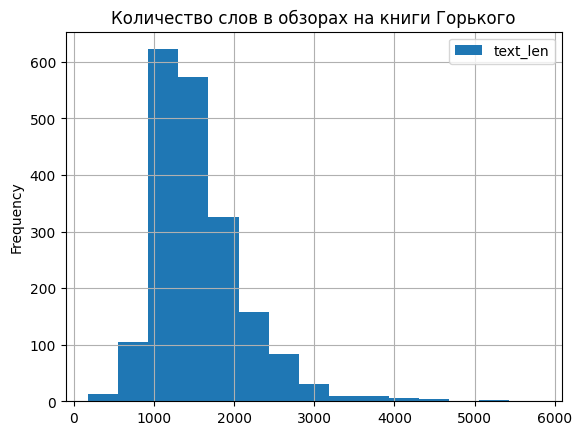

In [ ]:
df[df['rubric']=='reviews'].plot(kind='hist', y='text_len',
         bins=15, grid=True, legend=True,
         title = "Количество слов в обзорах на книги Горького" )

<Axes: title={'center': 'Количество слов в рубрике контекст Горького'}, ylabel='Frequency'>

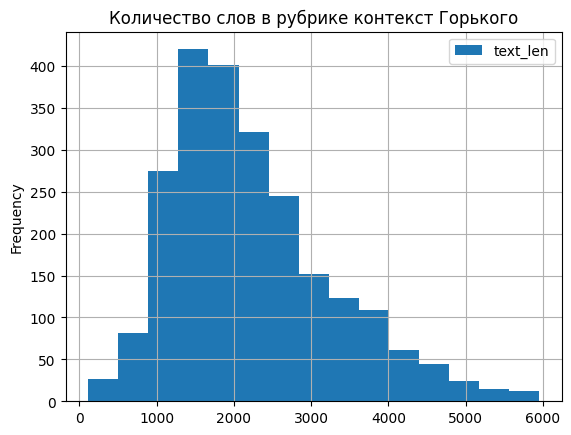

In [ ]:
df[df['rubric']=='context'].plot(kind='hist', y='text_len',
         bins=15, grid=True, legend=True,
         title = "Количество слов в рубрике контекст Горького" )

И в обзорах и в контексте чаще всего встречаются тексты длинной около 1500 пробельных слов. Но у контексты бывают и большей длинны. Например, есть по меньшей мере 100 текстов в рубрике контекст (если точно их 158) длинной от 4000 слов и более, тогда как обзоров такой длинные считанное количество (из 13, если быть точным).

In [ ]:
len(df.loc[(df['rubric']=='context')&
       (df['text_len']>=4000)])

158

Среди супер-длинных рецензий есть и моя рецензия на книгу Харриса о революции в Иране

<Axes: title={'center': 'Количество обзоров на книги в Горьком по годам'}, xlabel='year', ylabel='text'>

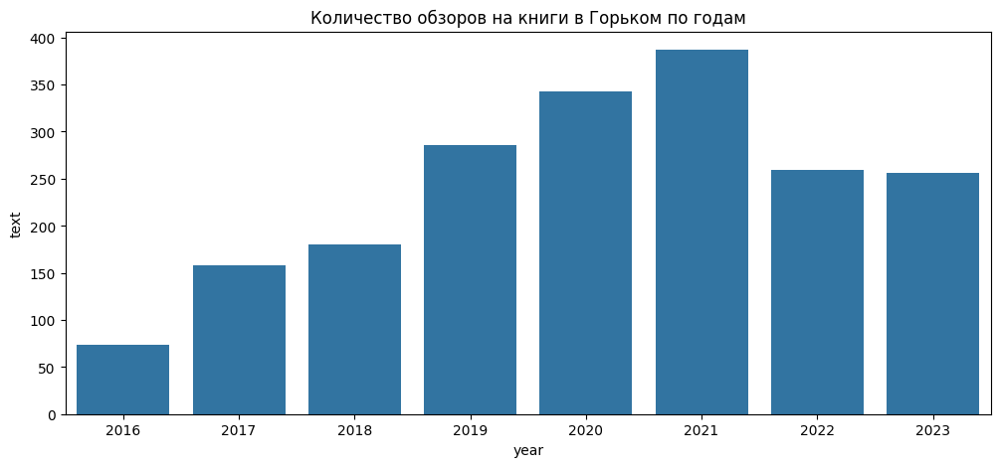

In [ ]:
plt.figure(figsize=(12,5))
# plt.xticks(rotation=70)
plt.title("Количество обзоров на книги в Горьком по годам")
boxplot_data = df[df['rubric']=='reviews'].groupby(['year'], as_index=False).agg({'text': 'count'})
sns.barplot(
    x='year',
    y='text',
    data=boxplot_data)

<Axes: title={'center': 'Количество текстов рубрики контекст на книги в Горьком по годам'}, xlabel='year', ylabel='text'>

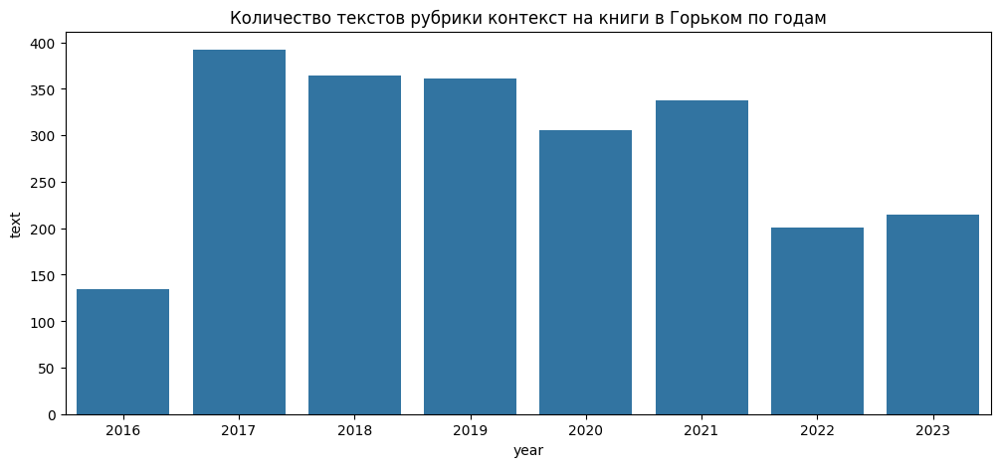

In [ ]:
plt.figure(figsize=(12,5))
# plt.xticks(rotation=70)
plt.title("Количество текстов рубрики контекст на книги в Горьком по годам")
boxplot_data = df[df['rubric']=='context'].groupby(['year'], as_index=False).agg({'text': 'count'})
sns.barplot(
    x='year',
    y='text',
    data=boxplot_data)

Количество текстов в рубрике контекст с 2017 по 2022 традиционно велико - ок 350 текстов в год. ТОгда как количество обзоров на книги вышло на аналогичный уровень только в 2020 и 2021, перед тем как рухнуть в 2022. При этом количество текстов в рубрике контекст упало сильнее.

<Axes: title={'center': 'Средняя длинна обзоров в Горьком по годам '}, xlabel='year', ylabel='text_len'>

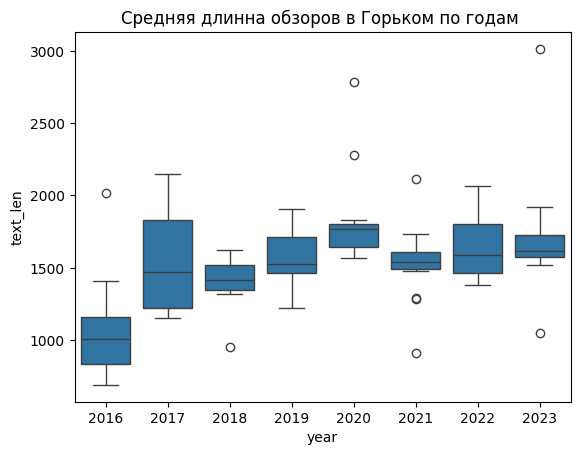

In [ ]:
plt.title("Средняя длинна обзоров в Горьком по годам ")
boxplot_data = df[df['rubric']=='reviews'].groupby(['title_len','year'], as_index=False).agg({'text_len': 'mean'})
sns.boxplot(
    x='year',
    y='text_len',
    data=boxplot_data)

<Axes: title={'center': 'Средняя длинна обзоров в Горьком по годам '}, xlabel='year', ylabel='text_len'>

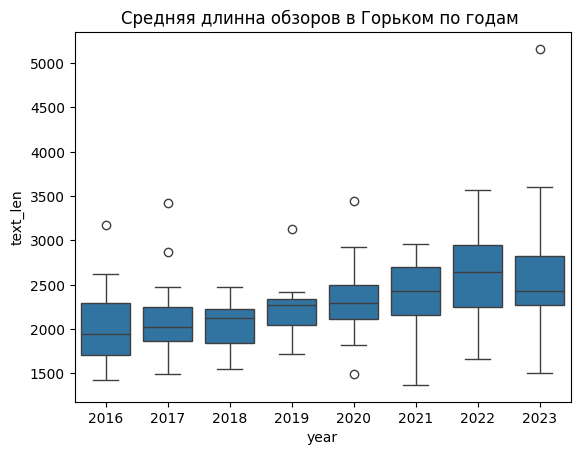

In [ ]:
plt.title("Средняя текстов рубрики контекст в Горьком по годам ")
boxplot_data = df[df['rubric']=='context'].groupby(['title_len','year'], as_index=False).agg({'text_len': 'mean'})
sns.boxplot(
    x='year',
    y='text_len',
    data=boxplot_data)

Средняя длинна обзоров на книги росла от ок. 1000 слов до 1800 (максимальная средняя длинна в 2020), затем вернулась к 1500 в 2021, т.е. еще до 2022. Авторы обзоров "предсказали" градущий упадок. <br>
Средняя длинна текстов рубрики контекст росла вплоть до 2022 г. от ок в среднем 2000 слов до в среднем 2500.


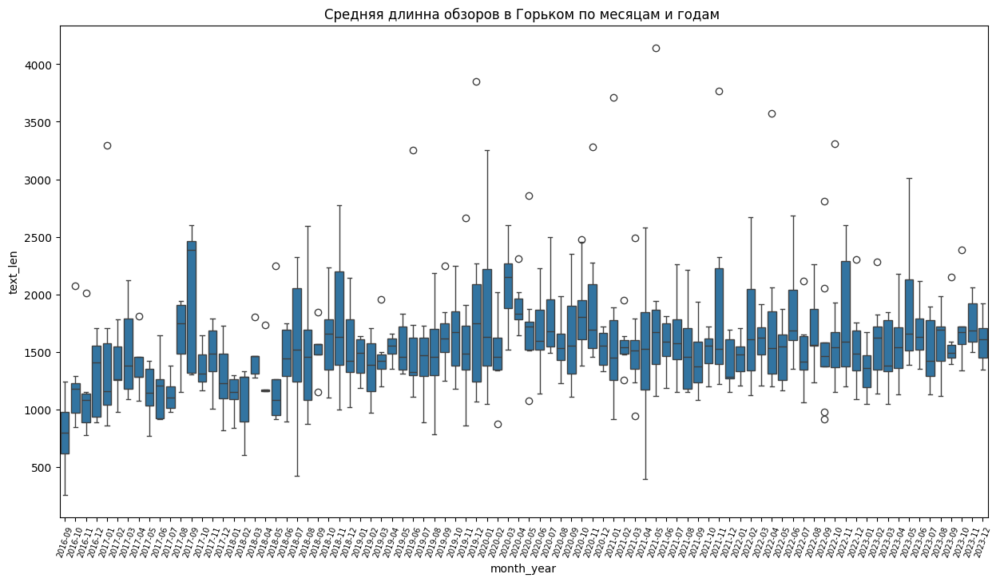

In [ ]:
plt.figure(figsize=(15,8))
plt.xticks(rotation=70)
plt.tick_params(axis='x', which='major', labelsize=7)
plt.title("Средняя длинна обзоров в Горьком по месяцам и годам ")
boxplot_data = df[df['rubric']=='reviews'].groupby(['month_year', 'title_len'], as_index=False).agg({'text_len': 'mean'})
sns.boxplot(
    x='month_year',
    y='text_len',
    data=boxplot_data);

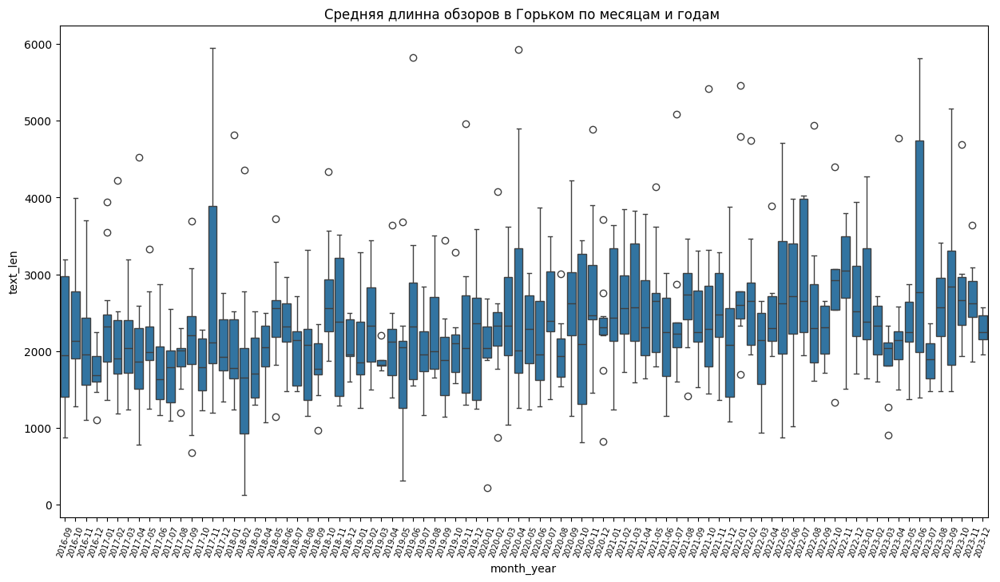

In [ ]:
plt.figure(figsize=(15,8))
plt.xticks(rotation=70)
plt.tick_params(axis='x', which='major', labelsize=7)
plt.title("Средняя длинна текстов рубрики Контекст в Горьком по месяцам и годам ")
boxplot_data = df[df['rubric']=='context'].groupby(['month_year', 'title_len'], as_index=False).agg({'text_len': 'mean'})
sns.boxplot(
    x='month_year',
    y='text_len',
    data=boxplot_data);

In [ ]:
top = df.query('author in @top_10')
ne_top = df.query('author not in @top_10')

In [ ]:
top.sample(10)

,url,author,publ_date,title,subtitle,description,text,month_year,title_len,cl_text,text_len,rubric,year
3220,https://gorky.media/reviews/fraktsii-krasnoj-p...,Иван Напреенко,2020-12-25,Фракции красной пилюли: книги недели,Что спрашивать в книжных,"Стоическая инструкция по выживанию, деревянные...",Уильям Ирвин. Радость жизни. Философия стоициз...,2020-12,5,Уильям Ирвин. Радость жизни. Философия стоициз...,1250,reviews,2020
3200,https://gorky.media/reviews/tsvetushhaya-slozh...,Иван Козлов,2021-01-11,Цветущая сложность: правила жизни в хаотическо...,Десять фактов из книги «Хаос. Создание новой н...,Книга американского писателя и журналиста Джей...,Джеймс Глик. Хаос. Создание новой науки. М.: А...,2021-01,7,Джеймс Глик. Хаос. Создание новой науки. М.: А...,1940,reviews,2021
3128,https://gorky.media/reviews/stoit-li-podozreva...,Игорь Перников,2021-03-17,Стоит ли подозревать лосей в меланхолии,10 фактов из книги Люси Кук «Неожиданная правд...,На протяжении многих веков люди не столько изу...,Люси Кук. Неожиданная правда о животных. Мурав...,2021-03,6,Люси Кук. Неожиданная правда о животных. Мурав...,1941,reviews,2021
2762,https://gorky.media/reviews/neodnoznachnyj-fas...,Эдуард Лукоянов,2022-03-23,Неоднозначный фашизм,О первой полной биографии «патриота-предателя»...,В 2008 году историк Миккель Киркебэк выпустил ...,\nМиккель Киркебэк. Шальбург — патриот-предат...,2022-03,2,Миккель Киркебэк. Шальбург — патриот-предате...,2371,reviews,2022
2676,https://gorky.media/reviews/koren-zla-yavlyaet...,Лев Оборин,2022-08-01,Корень зла является зоологическим,Лев Оборин — о трех поэтических новинках,"Поэтика разрыва Григория Стариковского, парони...",\nГригорий Стариковский. Птица разрыва. М.: Н...,2022-08,4,Григорий Стариковский. Птица разрыва. М.: Но...,2129,reviews,2022
699,https://gorky.media/context/proshhanie-s-ferli...,Лев Оборин,2021-02-28,"Прощание с Ферлингетти, новый Исигуро и поэты ...",Лучшее в литературном интернете: 9 ссылок недели,Ушел из жизни один из лидеров бит-поколения Ло...,1. В возрасте 101 года в Сан-Франциско умер по...,2021-02,9,1. В возрасте 101 года в Сан-Франциско умер по...,2010,context,2021
1881,https://gorky.media/context/osmyslenie-nobelya...,Лев Оборин,2017-10-08,"Осмысление Нобеля, дебаты вокруг насилия и гра...",Лучшее в литературном интернете: 10 самых инте...,Каждую неделю поэт и критик Лев Оборин пристра...,1. Умер Вячеслав Всеволодович Иванов — лингвис...,2017-10,8,1. Умер Вячеслав Всеволодович Иванов — лингвис...,1961,context,2017
1695,https://gorky.media/context/nekotorye-znakomye...,Мария Нестеренко,2018-04-10,"«Некоторые знакомые Лосева не знали, что он ве...",Интервью с филологом Еленой Тахо-Годи. Часть в...,Вторая часть большого интервью с филологом Еле...,Об архиве Лосева\nКогда в начале 1990-х годов ...,2018-04,8,Об архиве Лосева Когда в начале 1990-х годов я...,1838,context,2018
903,https://gorky.media/context/yubilej-krasnogo-m...,Лев Оборин,2020-07-19,Юбилей «Красного матроса» и диалог о Джудит Ба...,Лев Оборин — о самом главном в литературном ин...,Издательство «Красный матрос» отметило 25-лети...,1. В возрасте 73 лет умерла поэтесса Миряна Ба...,2020-07,10,1. В возрасте 73 лет умерла поэтесса Миряна Ба...,2299,context,2020
1010,https://gorky.media/context/ad-ad-ad-glavnye-k...,Эдуард Лукоянов,2020-03-12,"Ад, ад, ад: главные книги Пьера Гийота",Памяти самого скандального французского писате...,7 февраля не стало Пьера Гийота — великого обн...,«На коне» (1961)\nВ первой крупной публикации ...,2020-03,7,«На коне» (1961) В первой крупной публикации П...,1305,context,2020


In [ ]:
top['title_len'].mean()


5.984555984555985

In [ ]:
ne_top['title_len'].mean()

5.799925898480919

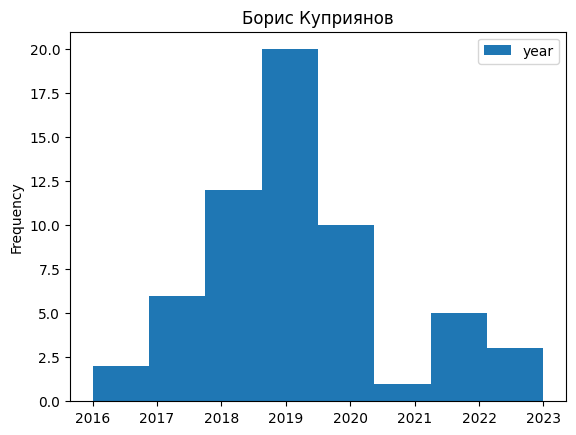

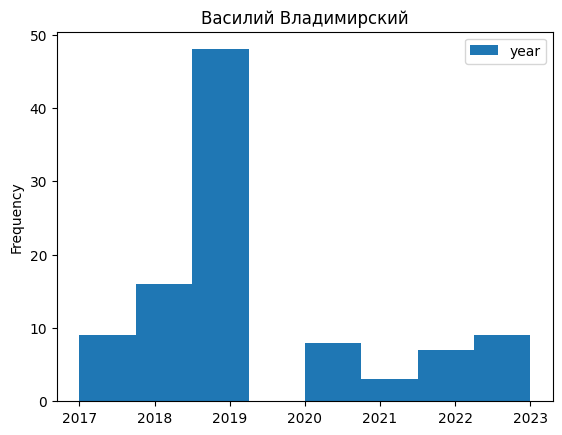

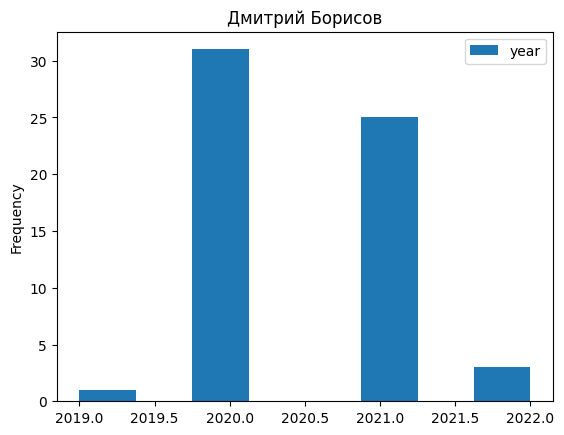

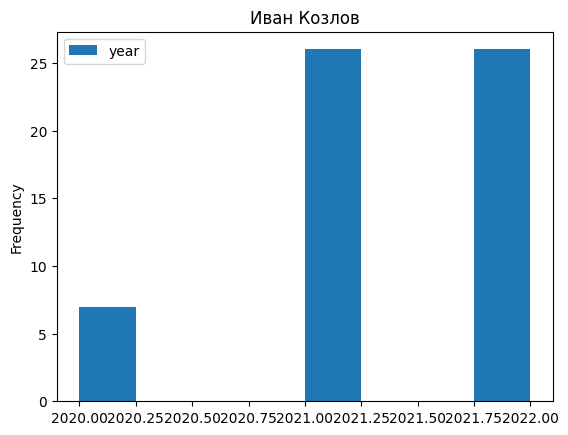

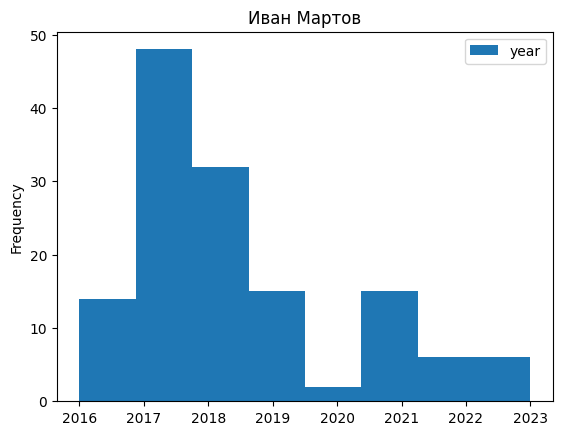

...

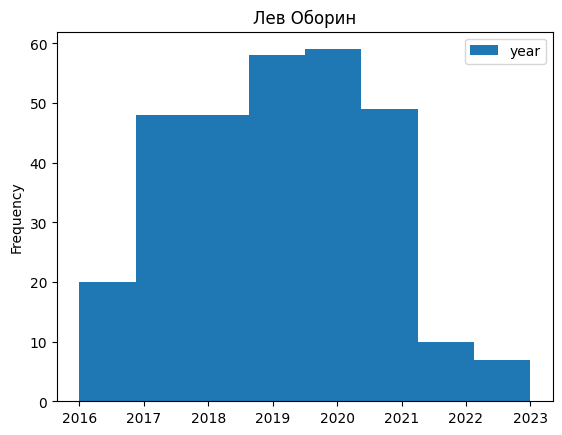

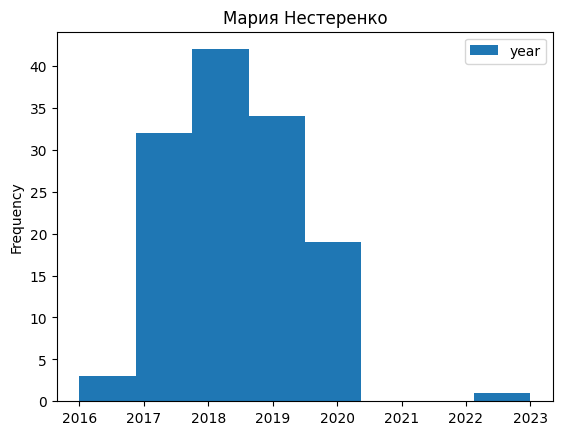

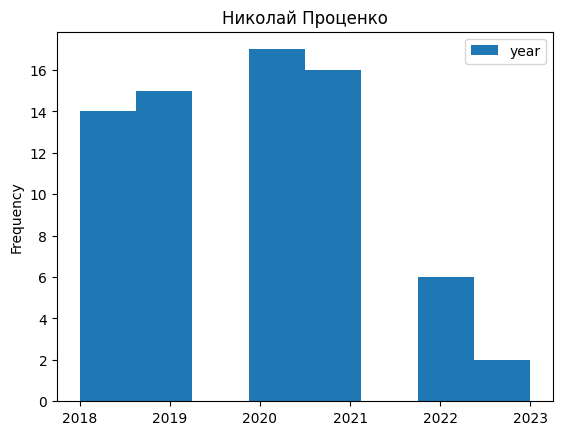

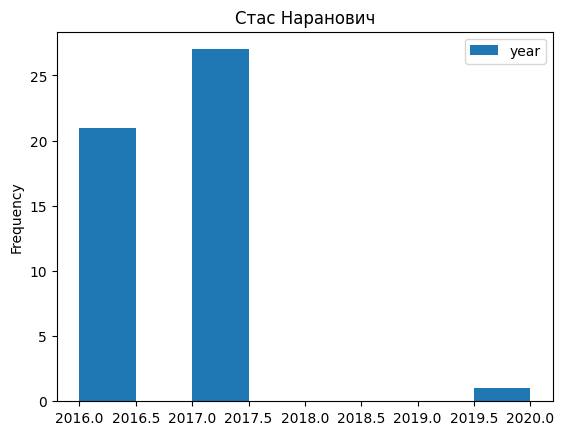

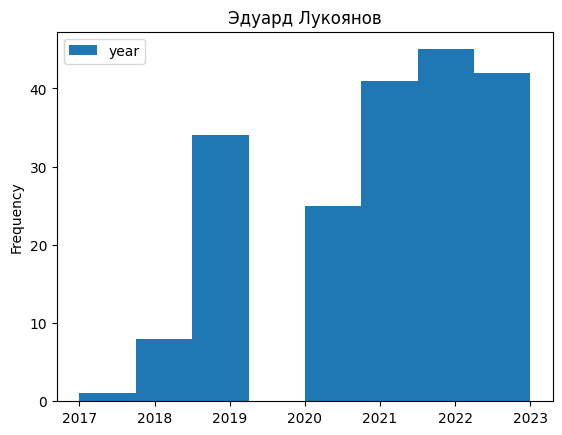

In [ ]:
for author, group_df in top.groupby('author'):
    group_df.plot(kind='hist', y='year', bins=8, title=author);

Как и в мирф в Горьком жизненный цикл автора (пока он пишет много) - ок. 5 лет.
Л. Оборин - 2017-2021 гг. <br>
Б. Куприянов - 2017-2020 гг. <br>
И. Мартов - 2016-2019 гг. <br>
М. Нестеренко - 2017-2020 гг. <br>
К. Мильчин - 2017-2021 гг. <br>
И. Напреенко - 2019-2022 гг. <br>
Н. Проценко - 2018-2022 гг. <br>
<br><br>
И те, кто подхватили инициативу

Э. Лукоянов - 2019-2023 гг. <br>
И. Козлов - 2020-2022 гг. <br>
И. Перников -2020-2023 гг. <br>
<br><br>
И есть те из топовых авторов, кто выдавал большое количество обзоров (десятки) в отдельные годы:

С. Наранович - 2016 (20), 2017 (ок. 25) <br>
Д. Борисов 2020 (30), 2021 (25) <br>
В. Владимирский 2019 (ок. 50), остальные годы с 2017 по 2023 ок 10 обзоров в год. <br>

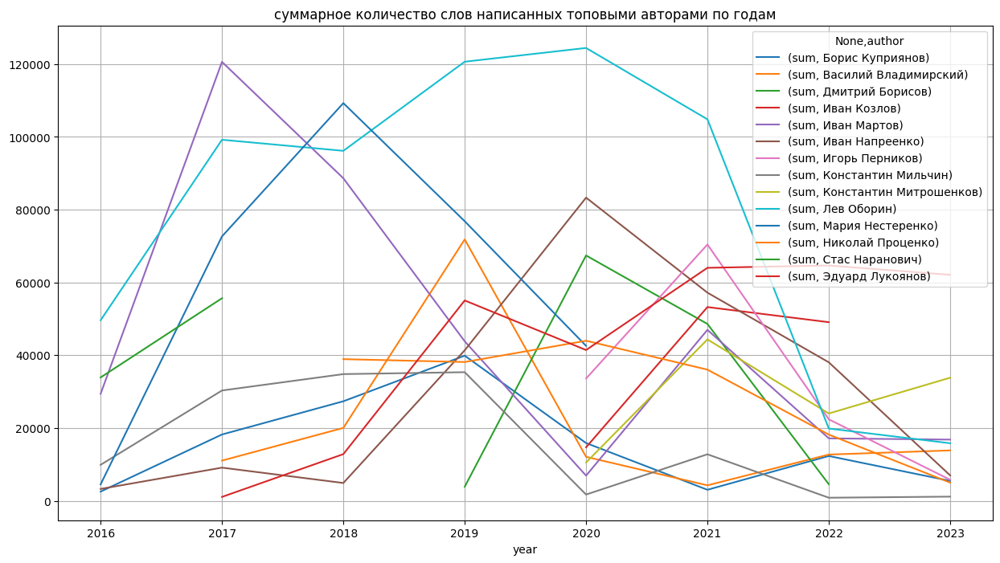

In [ ]:
(
top.pivot_table(index=['year'], columns='author', values='text_len', aggfunc=['sum'])
.plot(grid=True, figsize=(15, 8),
      title='суммарное количество слов написанных топовыми авторами по годам',
      xlabel='year')
);

По суммарному количеству слов, написанных для Горького:
в 2017 г. И. Мартов (ок. 120 000 слов) <br>
в 2018 г. М. нестеренко (ок. 110 000 слов) <br>
в 2019 и 2020 гг. Л. Оборин (более 120 000) <br>
в 2021 г. Л. Оборин (ок. 100 000) <br>
в 2022 и 2023 гг. Э. Лукоянов (ок. 63 000 слов) <br>

In [ ]:
def get_word_POS (row, li = None, li_t = None, key_words_list = None):

    key_words_list = [] if key_words_list is None else key_words_list
    li_t = [] if li_t is None else li_t
    li = [] if li is None else li

    text = row['cl_text']
    doc = Doc(text)
    doc.segment(segmenter)
    doc.tag_morph(morph_tagger)
    doc.parse_syntax(syntax_parser)
    doc.tag_ner(ner_tagger)

    for token in doc.tokens:
        token.lemmatize(morph_vocab)
    for span in doc.spans:
        span.normalize(morph_vocab)

    # cущ
    noun_l = [t.lemma for t in doc.tokens if t.pos == 'NOUN']
    if noun_l:
        row['text_NOUN'] = list(set(noun_l))
        key_words_list = key_words_list + [tup[0] for tup in Counter(noun_l).most_common(2)]
    else:
        row['text_NOUN'] = []

    # chunks из текста
    for i in range(len(doc.tokens)):
        j = i+1
        if j < len(doc.tokens):
            if (doc.tokens[i].pos == "ADJ"\
                and doc.tokens[j].pos == "NOUN")\
            or (doc.tokens[i].pos == "DET"\
                and doc.tokens[i].rel == "det"\
                and doc.tokens[j].pos == "NOUN")\
            or (doc.tokens[i].pos == "NOUN"\
                and doc.tokens[j].pos == "NOUN"\
                and doc.tokens[j].rel == "nmod")\
            or (doc.tokens[i].pos == "NOUN"\
                and doc.tokens[j].pos == "ADJ"):
                li_t.append([doc.tokens[i].lemma, doc.tokens[j].lemma])

    li_t = [" ".join(l) for l in li_t]
    key_words_list = key_words_list + [tup[0] for tup in Counter(li_t).most_common(2)]

    # NER для текста
    per_l = [s.normal for s in doc.spans if s.type == 'PER']
    # если есть Ф+И то И -> Ф+И и Ф -> Ф+И
    l2 = [l for l in per_l if len(l.split(' '))> 1]
    rez_d = {l:l.split() for l in l2}
    rec_dic = {v:k for k, l in rez_d.items() for v in l}
    per_l = [pd.Series(l).replace(rec_dic).to_list() for l in per_l]
    per_l = sum(per_l, [])

    loc_l = [s.normal for s in doc.spans if s.type == 'LOC']
    org_l = [s.normal for s in doc.spans if s.type == 'ORG']

    if per_l:
        row['text_ent_PER'] = list(set(per_l))
        key_words_list = key_words_list + [tup[0] for tup in Counter(per_l).most_common(2)]
    else:
        row['text_ent_PER'] = []

    if loc_l:
        row['text_ent_LOC'] = list(set(loc_l))
    else:
        row['text_ent_LOC'] = []

    if org_l:
        row['text_ent_ORG'] = list(set(org_l))
    else:
        row['text_ent_ORG'] = []

    # прил
    adj_l = [t.lemma for t in doc.tokens if t.pos == 'ADJ']
    if adj_l:
        row['text_ADJ'] = list(set(adj_l))
        key_words_list = key_words_list + [tup[0] for tup in Counter(adj_l).most_common(2)]
    else:
        row['text_ADJ'] = []

    row['key_words'] = key_words_list

    return row

In [ ]:
# применили функцию выше
top = top.apply(get_word_POS, axis=1)
from google.colab import files
top.to_csv('gorky_top_natasha.csv')
files.download('gorky_top_natasha.csv')

In [ ]:
top.sample(10)

,url,author,publ_date,title,subtitle,description,text,month_year,title_len,cl_text,text_len,rubric,year,text_NOUN,text_ent_PER,text_ent_LOC,text_ent_ORG,text_ADJ,key_words
2173,https://gorky.media/context/raz-v-kreshhenskij...,Мария Нестеренко,2017-01-10,Раз в крещенский вечерок,"Ведьмы из Малороссии, упыри и другая нечисть: ...","Как известно, на Святки, между Рождеством и Кр...",В середине 1820-х годов в русской литературе п...,2017-01,4,В середине 1820-х годов в русской литературе п...,1712,context,2017,"[вестник, сон-трава, музыка, церопластика, леп...","[Маша, Н.В. Гоголь, Улиян, Орест Михайлович Со...","[Лысая гора, Россия, Малороссия, Диканьки, Укр...","[Московский телеграф, Новости литературы, Русс...","[нестрашный, романтический, молодой, зеленый, ...","[год, ведьма, семья вурдалак, фантастический п..."
2303,https://gorky.media/context/vitgenshtejn-v-sssr/,Стас Наранович,2016-09-08,Витгенштейн в СССР,Как Людвиг Витгенштейн ездил в Советский Союз,"Мало кто знает, но в 1935 году философ Людвиг ...",Предыстория\nВ 1935 году Витгенштейн решает пе...,2016-09,3,Предыстория В 1935 году Витгенштейн решает пер...,1463,context,2016,"[философ, союз, визит, приезд, исследование, м...","[Адольф Павлович Юшкевич, Савельев, Горнштейн ...","[Советский Союз, СССР, Тарнов, Кембридж, Малые...","[МГПИ имя. В.И.Ленина, Всесоюзный центральный ...","[великий, 24, крайний, молодой, казанский, ком...","[год, философ, 1935 год, записной книжка, Кант..."
2433,https://gorky.media/reviews/interesnaya-kniga/,Эдуард Лукоянов,2023-07-11,Интересная книга*,Эдуард Лукоянов — об «Уничтожить» Мишеля Уэльбека,Вышедший в 2022 году роман Мишеля Уэльбека «Ун...,"\nМишель Уэльбек. Уничтожить. М.: Corpus, 202...",2023-07,2,"Мишель Уэльбек. Уничтожить. М.: Corpus, 2023...",1135,reviews,2023,"[чиновник, бардак, фейк, тур, установка, эсмин...","[Лев Копелев, Ле Пен, Мишель Уэльбек, Террорис...","[Европа, Республика, Россия, Ле Пенов, Франция]","[Новый мир, Национальное объединение]","[верхний, унылый, крайний, одноименный, почтен...","[год, роман, сам дело, французский правительст..."
1099,https://gorky.media/context/cup-iz-bolshoj-tro...,Лев Оборин,2019-11-13,Cуп из большой тростниковой крысы,Интервью с Александром Стесиным,В короткий список премии «НОС» вошла книга Але...,"«Нью-Йоркский обход» — не первая ваша проза, с...",2019-11,5,"«Нью-Йоркский обход» — не первая ваша проза, с...",2557,context,2019,"[тиф, брахмачарья, семя, нигериец, онколог, гу...","[Новуйо Тшумы, Чинуа Ачебе, Чимаманда Нгози Ад...","[Мадагаскар, Гане, Гана, США, Бронкс, Мали, Се...",[Нью-Йоркский],"[неожиданный, правильный, диковинный, данный, ...","[язык, время, какой-то момент, этот язык, Нгуг..."
589,https://gorky.media/context/izgnanie-iz-litins...,Лев Оборин,2021-07-11,Изгнание из Литинститута и разоблачение «Кошат...,Главное в литературном интернете: 10 ссылок не...,"Отзыв на «Южную Мангазею», доносы писателей, м...",1. В «Учительской газете» вышло интервью с Оль...,2021-07,6,1. В «Учительской газете» вышло интервью с Оль...,1913,context,2021,"[чума, стать, настроение, документ, исследован...","[Александр Сопровский, Лавкрафт, Александр Чан...","[Япония, Равенсбрюк, Пушкин, Литинститута, Мос...","[Нашего современник, Красная армия, НЛО, Стори...","[архивный, неожиданный, нелестный, стихосложен...","[крыса, история, сам дело, этот история, Алекс..."
3382,https://gorky.media/reviews/lyubov-i-atomy-kni...,Иван Напреенко,2020-08-14,Любовь и атомы: книги недели,"Новинки, к которым лучше бы вы присмотрелись","Секс при социализме, ад в Японии, трудолюбие в...","Джон Херси. Хиросима. М.: Individuum, 2020. Пе...",2020-08,5,"Джон Херси. Хиросима. М.: Individuum, 2020. Пе...",1465,reviews,2020,"[музыка, коллега, пистолет, партнер, японец, а...","[Дмитрий Горчев, Бьорн, Дмитрий Капустин, Тузи...","[Германия, Швеция, США, Восточный блок, СССР, ...","[Galle Face, Азбука-Аттикус, Редакция Елены Шу...","[азиатский, японский, оргазмов, очаровательный...","[женщина, книга, xx век, страна восточный, Кр

In [ ]:
from google.colab import files
top.to_csv('gorky_top_natasha.csv')
files.download('gorky_top_natasha.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
top.loc[2173]['cl_text']

'В середине 1820-х годов в русской литературе появился новый жанр — фантастическая повесть. Он быстро завоевал читательскую любовь, многие писатели решили попробовать себя в нем, а для некоторых фантастика стала основной темой.  Один за другим появляются «Двойник, или Мои вечера в Малороссии» А.А. Погорельского (1828), «Вечера на хуторе близ Диканьки» Н.В. Гоголя (1831—1832), «Пестрые сказки» В.Ф. Одоевского (1833), «Вечер на Хопре» М.Н. Загоскина (1834) и т.д. Новый жанр обсуждался в журналах того времени: «Московском телеграфе», «Московском вестнике», «Сыне отечества» и других. Романтизм, наследуя готической литературе, всегда питал интерес ко всему мистическому и необычному. Толчком к развитию фантастической повести в России стали переводы Эрнста Теодора Гофмана. Первый был осуществлен в 1822-м («Девица Скудери» в приложении к «Сыну отечества»), а к 1840 году на русском опубликовали 62 рассказа Гофмана. Отечественные авторы активно использовали гофмановские темы и мотивы. Впрочем, Г

In [ ]:
# сохраним в переменной списко имен колонок в которых будем суммировать списки
col_names = top.columns.tolist()[-6:]
sum_list = ['sum']*len(col_names)
col_names_dic = dict(zip(col_names, sum_list))

In [ ]:
# сгруппировали
top_grup = top.groupby(['author'], as_index=False).agg(col_names_dic)

In [ ]:
removing_list = ['жанр', 'книга', 'итог', 'роман',
                 'человек', 'год', 'автор', 'персонаж', 'год',
                'финал', 'читатель', 'страница', 'часть', 'текст',
                'сюжет', 'том', 'писатель', 'произведение', 'поклонник',
                'повествование', 'любитель', 'раз', 'похоже',
            'неплохо', 'сожалению', 'интервью', 'счастью', 'вобщем',
                'другой', 'первый', 'второй', 'новый', 'самый', 'последний', 'сам', 'третий', 'жизнь', 'время', 'век',
                 'Альпина Паблишер', 'Бомбора', 'К. М.', 'Иван Лимбах', 'Владимир Даль', 'Иванов', 'Фербер',
                 'Индивидуум', 'Маргинем Пресс', 'М.', 'Алетейя', 'Нестор-История']

In [ ]:
from wordcloud import WordCloud, STOPWORDS

In [ ]:
stopwords = set(STOPWORDS)

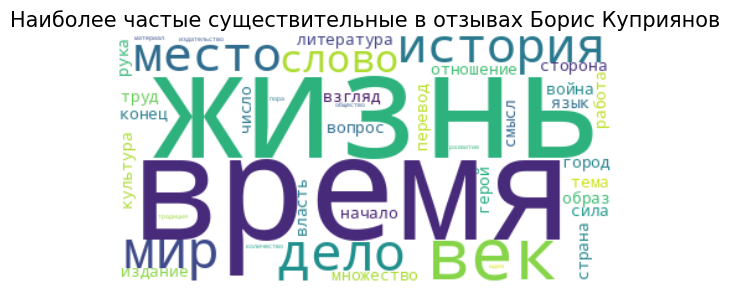

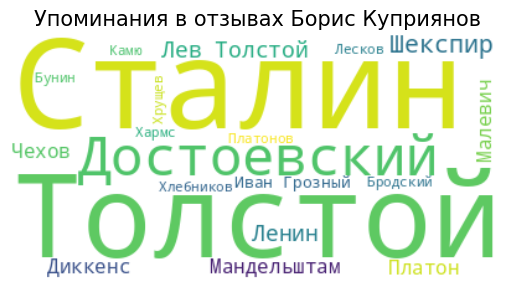

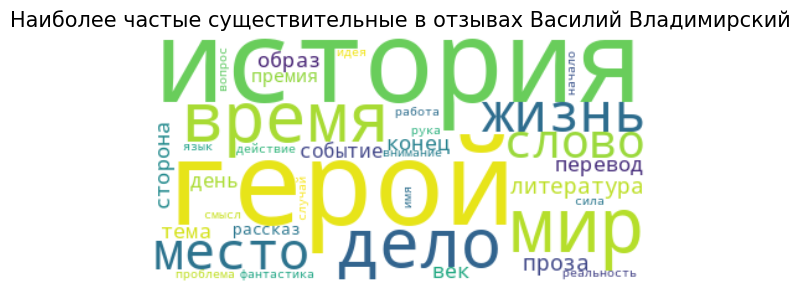

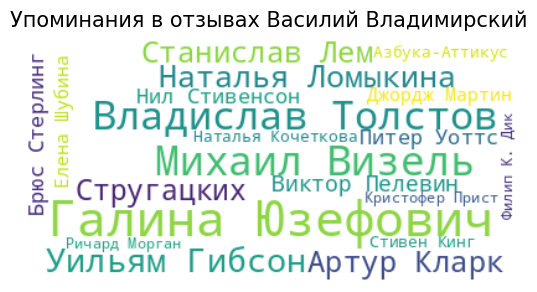

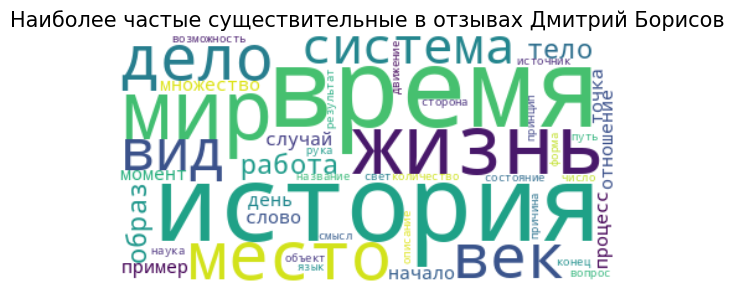

...

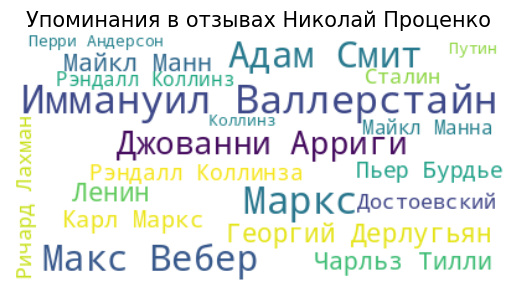

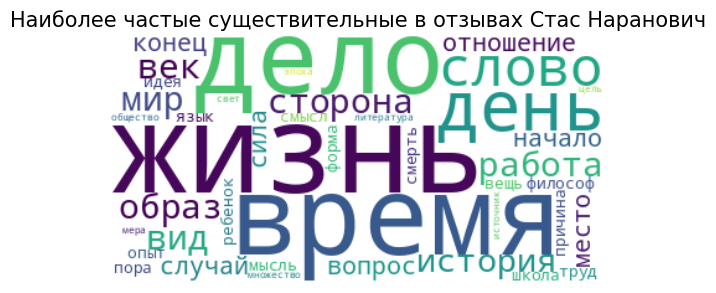

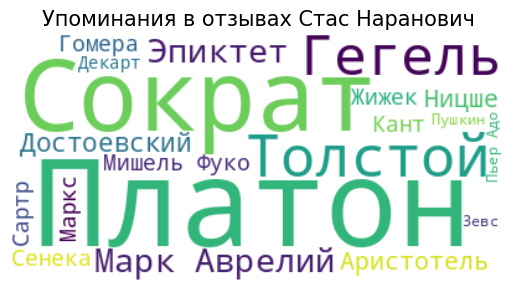

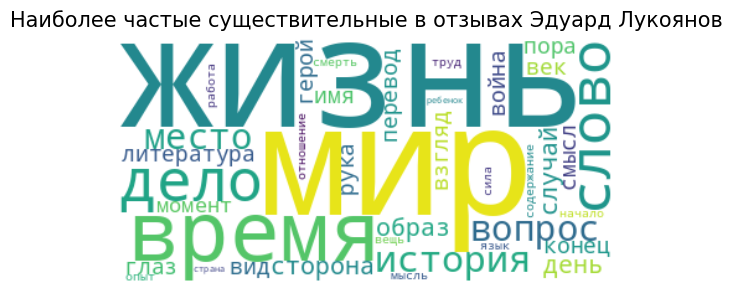

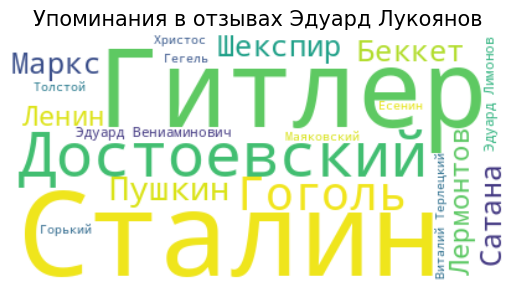

In [ ]:
# облака слов в цикле
wc = WordCloud(background_color="white", max_words=50, stopwords = stopwords)


for author in top_grup['author'].unique():
    l = top_grup.loc[top_grup['author'] == '{}'.format(author), 'text_NOUN'].tolist()[0]
#     for w in removing_list:
#         if w in l:
#             l.remove(w)
#         else:
#             pass
    count = Counter(l).most_common(50) #[-25:]
    text = {word: value for word, value in count if word not in removing_list}
    wc.generate_from_frequencies(text)
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    plt.title("Наиболее частые существительные в отзывах {}".format(author), fontsize=15)
    plt.show()

    l2 = top_grup.loc[top_grup['author'] == '{}'.format(author), 'text_ent_PER'].tolist()[0]
#     last_names = []
#     for pers in l2:
#         if len(pers) > 1:
#             last_names.append(pers.split()[-1])
#         else:
#             last_names.append(pers)
    count2 = Counter(l2).most_common(20)
    text = {word: value for word, value in count2 if word not in removing_list}
    wc.generate_from_frequencies(text)
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    plt.title("Упоминания в отзывах {}".format(author), fontsize=15)
    plt.show()
    print()
    print()

- время и жизнь в стоп слова
- Толстой и Лев Толстой
- Рэндалл Коллинз и Рэндалл Коллинза и Коллинз
- Майкл Манн и Майкла Манна
- 'К. М.' - это инициалы Константин Митрошенков, он брал интервью

In [ ]:
# словарь для замены упоминаний
rr = {
    'Майкл Манна':'Майкл Манн',
    'Коллинз':'Рэндалл Коллинз',
    'Рэндалл Коллинза':'Рэндалл Коллинз',
    'Гомера':'Гомер',
    'Эдуард Вениаминович':'Лимонов',
    'Эдуард Лимонов':'Лимонов',
    'Лев Толстой':'Толстой',
    'Мишель Фуко': 'Фуко',
    'Виктор Пелевин': 'Пелевин',
    'Валлерстайна': 'Иммануил Валлерстайн',
    'Карл Маркс': 'Маркс',
    'Броделя': 'Фернан Бродель',
    'Ричард Лахманн': 'Ричард Лахман',
    'Сорокин': 'Владимир Сорокин',
    'Дональд Трамп': 'Трамп',
    'Николай Иванович Харджиев': 'Николай Харджиев',
    'Глеб Олегович': 'Глеб Павловский'}

In [ ]:
top_grup[top_grup['author']=='Константин Митрошенков']['text_ent_PER']

,author,text_NOUN,text_ent_PER,text_ent_LOC,text_ent_ORG,text_ADJ,key_words
0,Борис Куприянов,"[клоун, антрепренер, вуз, отчет, начало, гражд...","[Виктор Драгунский, Конев, Дениск, Сталин, Нез...","[Магнитка, СССР, Север, Солнечный город, Амери...","[5-й Дом Советов, Нацбест, Патриаршая, ДК «Рас...","[великий, вечерний, определенный, верхний, кра...","[год, ребенок, денискин рассказ, детский литер..."
1,Василий Владимирский,"[музыка, комментатор, нейросеть, граница, стра...","[Джон Леннон, Лю Цысинь, Вера Богданова, Влади...","[Адамов, США, Брайтон, Земля, Страна Советы, С...","[Благодарные мертвецы, Стекло, Доктор Нет, Сме...","[правильный, молодой, прикладной, негативный, ...","[фантастика, текст, нереалистический проза, мо..."
2,Дмитрий Борисов,"[мамлеевский, непьющий, отчет, переводчик, при...","[Жан Парвулеско, Блок, Чиверу, Ремин, Ю. М, Юр...","[Мамлеев Америка, Мамлеев-человек, Чикаго, Зап...","[Новое русское слово, Южинского, Корнельский у...","[буквальный, вечерний, мамлеевский, 2008, экст...","[человек, сон, xx век, тот число, Юрий Виталье..."
3,Иван Козлов,"[супершторм, тур, коллега, привилегия, информа...","[Роберт Вичина, О'Коннелла, Роберт Зубрина, Ев...","[Оксбридж, Ванака, Европа, Припяти, Пасха, При...","[Марсианское общество, Министерство внутренних...","[xviii, великий, неожиданный, чернобыльский, д...","[год, век, конец свет, марсианский общество, М..."
4,Иван Мартов,"[стать, музыка, божик, отчет, переводчик, стра...","[Шеллинг, Вальзегг-Штуппах, Богом-Сыном, Живаг...","[Германия, Советский Союз, Ротбарт, Голландия,...","[Доктор Живаго, Ладомир, Кентавр, Звезда союза...","[великий, определенный, жестокий, поздний, нес...","[произведение, книга, мой взгляд, мой перевод,..."
5,Иван Напреенко,"[экспансия, философ, сарказм, союз, арамис, чи...","[Джеймс Лавлок, Жак Деррида, Гарольд Гарфинкел...","[Тайбей, Украина, Арамис, Россия, Германия, Ск...","[Бруно Латур, Парламент, Парижская семиотическ...","[киберкультурный, библейский, одноименный, гум...","[текст, наука, научный текст, научный практика..."
6,Игорь Перников,"[каче­ство, музыка, привилегия, уничтожение, д...","[Моссад, Пьер Жмайель, И. П., Сапьма Рувейха, ...","[Израиль, Салинас, Европа, Дамаск, Ирак, Восто...","[ОАР, Маракат аль-Фанадик, Американский универ...","[старший, неразрешимый, песочный, экстатически...","[год, писательница, сам начало, дамасский унив..."
7,Константин Мильчин,"[отряд, грудь, рабыня, час, гражданин, коллега...","[Кевин Систром, Сергей Шевченко, Дарья Белоусо...","[Хиросима, Япония, Россия, Тюмень, США, Лесоба...","[Storytel, Facebook, Instagram, Пионер, 777, С...","[великий, симпатичный, японский, огромный, сем...","[книга, история, потенциальный жертва, безмолв..."
8,Константин Митрошенков,"[музыка, коллега, услуга, кампания, обозрение,...","[Глеб Струве, Гегель, Сталин, Михаил Бубеннов,...","[СССР, Югославия, Запад, Сталинские премиям, К...","[Комитет по Сталинским премиям, Государственна...","[нормативный, архивный, премиальный, поздний, ...","[премия, год, сталинский премия, советский кул..."
9,Лев Оборин,"[коллега, конспирологический, коронавирус, онл...","[Джордж Мартин, Питер Браун, Леандер, Тайлер Д...","[Средиземья, Сицилия, США, Кремниевая долина, ...","[Expressen, Рана, Aftenposten, The Atlantic, A...","[библейский, жестокий, поздний, определенный, ...","[история, роман, нобелевский премия, тот число..."


In [ ]:
Counter(top_grup[top_grup['author']=='Борис Куприянов']['text_ent_PER'].tolist()[0]).most_common(50)

[('Сталин', 8),
 ('Толстой', 7),
 ('Достоевский', 6),
 ('Шекспир', 6),
 ('Лев Толстой', 5),
 ('Ленин', 5),
 ('Чехов', 4),
 ('Диккенс', 4),
 ('Мандельштам', 4),
 ('Платон', 4),
 ('Малевич', 4),
 ('Иван Грозный', 4),
 ('Хрущев', 3),
 ('Лесков', 3),
 ('Бродский', 3),
 ('Камю', 3),
 ('Хармс', 3),
 ('Хлебников', 3),
 ('Бунин', 3),
 ('Платонов', 3),
 ('Маркс', 3),
 ('Пушкин', 3),
 ('Пруст', 3),
 ('Набоков', 3),
 ('Гитлер', 3),
 ('Глеб Павловский', 3),
 ('Александр II', 3),
 ('Маяковский', 3),
 ('Максим Горький', 3),
 ('Центрполиграф', 3),
 ('Иванов', 3),
 ('Ельцин', 2),
 ('Глеб Олегович', 2),
 ('Гефтер', 2),
 ('Акунин', 2),
 ('Соловьев', 2),
 ('Аристотель', 2),
 ('Сэлинджер', 2),
 ('Овидий', 2),
 ('Гомера', 2),
 ('Тургенев', 2),
 ('Хорхе', 2),
 ('Владимир Эрль', 2),
 ('Николай Иванович Харджиев', 2),
 ('Михаил Кузмин', 2),
 ('Михаил Мейлах', 2),
 ('Николай Харджиев', 2),
 ('Введенский', 2),
 ('Коган', 2),
 ('Ницше', 2)]

In [ ]:
top[top['cl_text'].str.contains(r"\bК. М.", case=False)]

,url,author,publ_date,title,subtitle,description,text,month_year,title_len,cl_text,text_len,rubric,year,text_NOUN,text_ent_PER,text_ent_LOC,text_ent_ORG,text_ADJ,key_words
32,https://gorky.media/context/stalina-v-pervuyu-...,Константин Митрошенков,2023-11-20,«Сталина в первую очередь интересовал сам текс...,"Интервью с Дмитрием Цыгановым, автором книги «...",Издательство «Новое литературное обозрение» вы...,\nДмитрий Цыганов. Сталинская премия по литер...,2023-11,11,Дмитрий Цыганов. Сталинская премия по литера...,3644,context,2023,"[музыка, коллега, услуга, кампания, обозрение,...","[Глеб Струве, Гегель, Сталин, Михаил Бубеннов,...","[СССР, Югославия, Запад, Сталинские премиям, К...","[Комитет по Сталинским премиям, Государственна...","[нормативный, архивный, премиальный, поздний, ...","[премия, год, сталинский премия, советский кул..."
39,https://gorky.media/intervyu/rasskazy-shalamov...,Константин Митрошенков,2023-11-07,"«Рассказы Шаламова остаются документами, даже ...",Интервью с филологом Эмили Ван Баскирк,Эмили Ван Баскирк — специалистка по литературе...,"\n— Расскажите, пожалуйста, о том, как вы нач...",2023-11,10,"— Расскажите, пожалуйста, о том, как вы нача...",2624,context,2023,"[дискурс-анализ, документ, дом, профессор, лес...","[Алексей Машевский, Александр Кушнер, Лариса Ж...","[Колыма, США, Кэрил Эмерсон, СССР, Санкт-Петер...","[Гарвард, Нью-Йоркский университет, Записки, П...","[определенный, молодой, iii, принстонский, нез...","[год, рассказ, записной книжка, блокадный чело..."
120,https://gorky.media/context/zhivotnoe-kotoroe-...,Константин Митрошенков,2023-06-08,"Животное, которое пишет не очень хорошие книги",Лидия Гинзбург — о кривой дорожке литературной...,Проблема халтуры встала перед молодой литерату...,\n1\nВо второй части романа Юрия Олеши «Завис...,2023-06,7,1 Во второй части романа Юрия Олеши «Зависть...,3516,context,2023,"[стать, исхалтуриться, антрепренер, переводчик...","[Илья Эренбург, Григорьев, Главрепертком, Бори...","[Германия, СССР, Вересаев, Гамбург, Россия, Ле...","[Институт истории искусств, леф, Агентство Пин...","[великий, внештатный, определенный, жестокий, ...","[год, халтура, 1920-й год, социальный заказ, Л..."
171,https://gorky.media/intervyu/luchshe-vseh-evol...,Иван Мартов,2023-03-08,«Лучше всех Эволу на русский язык перевел бы В...,"Интервью с Тамерланом Мерланом, переводчиком Ю...",Творческое наследие итальянского философа-трад...,\n— Почему вы решили переводить Юлиуса Эволу?...,2023-03,10,— Почему вы решили переводить Юлиуса Эволу? ...,2105,context,2023,"[музыка, переводчик, благоденствие, негритянск...","[Истина, Гельдерлин, Рыцарь Посвящение, Барон ...","[Америка, Кинешму, Кали-юги, Европа]","[Радио 7, Рыцари Посвящения, Негритизированная...","[богатейший, поздний, определенный, неведомый...","[спорт, слово, мой перевод, горнолыжный спорт..."
195,https://gorky.media/context/esenin-ya-privyk-c...,Константин Митрошенков,2023-02-02,"«Есенин, я привык, чтобы со мною здоровались»",О дневниках редактора и критика Вячеслава Поло...,"Как правило, редакторы издательств и литератур...",\n1\nКогда речь заходит о советской литератур...,2023-02,7,1 Когда речь заходит о советской литературе ...,2283,context,2023,"[тиф, стать, передовка, коллега, давление, при...","[Абрам Эфрос, Калинина, Сергей Есенин, Борис] ...","[СССР, Магнитогорск, Урал, Россия, Ленинград]","[Конармии, ЦК, Печать и революция, Воронского ...","[полноправный, ленинский, неразрешимый, всерос...","[год, запись, новый мир, 1920-й год, Вячеслав ..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3628,https://gorky.media/reviews/vo-sne-videl-polyu...,Иван Напреенко,2019-09-13,Во сне видел полюбовницу,"Шесть книжных новинок, на которые стоит обрати...","Записная книжка секунд-майора, заметки антропо...",Заботы и дни секунд-майора Алексея Ржевского: ...,2019-09,4,Заботы и дни секунд-майора Алексея Ржевского: ...,2044,reviews,2019,"[гонгоры-и-аргота, переводчик, коллега, покойн...","[Евгений Хо

In [ ]:
# замена .explode() + .replace()
top_grup3 = top_grup.explode('text_ent_PER').replace(rr).groupby(['author'], as_index=False)['text_ent_PER'].agg(list)

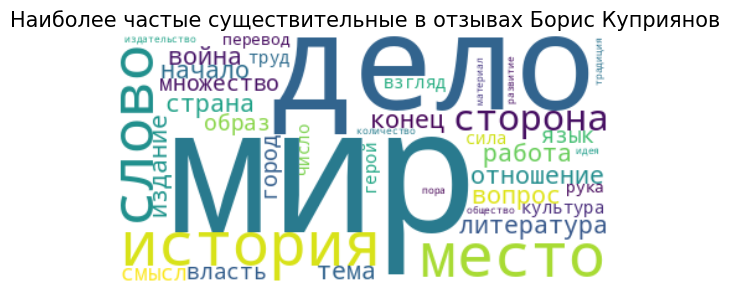

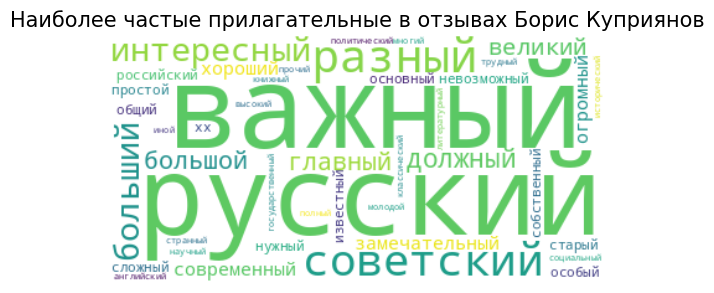

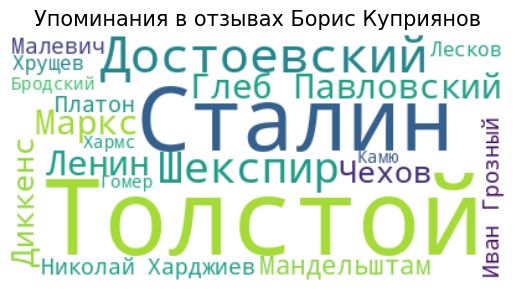

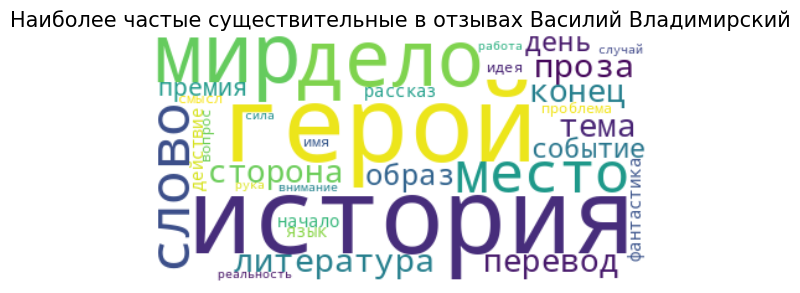

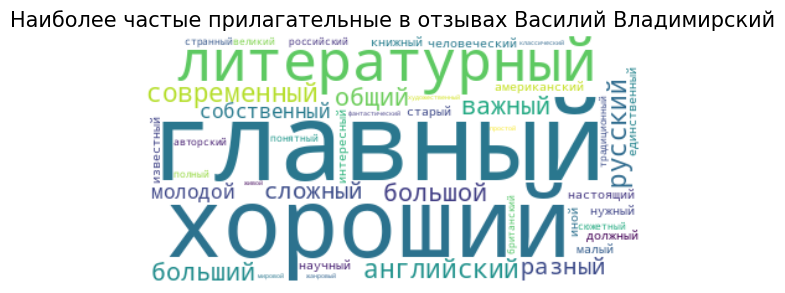

...

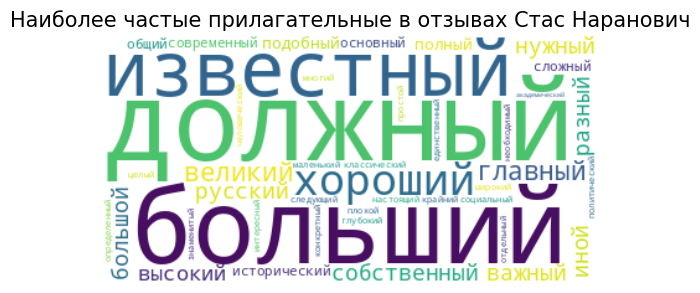

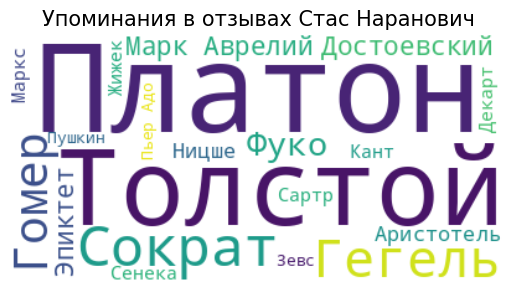

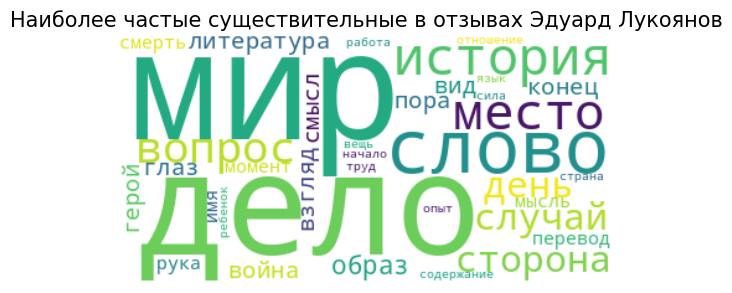

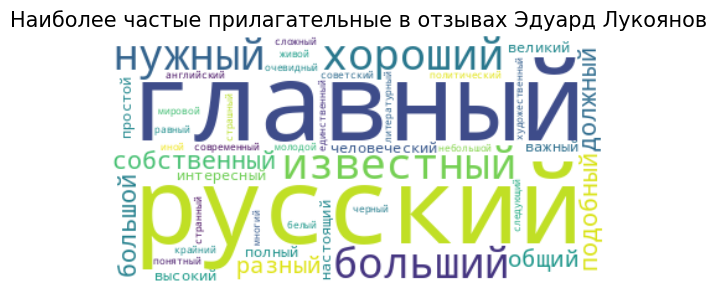

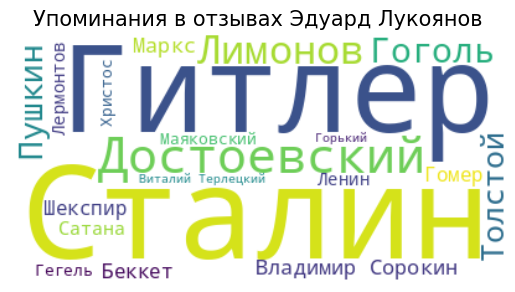

In [ ]:
# итоговое облако

wc = WordCloud(background_color="white", max_words=50, stopwords = stopwords)


for author in top_grup['author'].unique():
    l = top_grup.loc[top_grup['author'] == '{}'.format(author), 'text_NOUN'].tolist()[0]
#     for w in removing_list:
#         if w in l:
#             l.remove(w)
#         else:
#             pass
    count = Counter(l).most_common(50) #[-25:]
    text = {word: value for word, value in count if word not in removing_list}
    wc.generate_from_frequencies(text)
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    plt.title("Наиболее частые существительные в отзывах {}".format(author), fontsize=15)
    plt.show()

    l3 = top_grup.loc[top_grup['author'] == '{}'.format(author), 'text_ADJ'].tolist()[0]
#     for w in removing_list:
#         if w in l:
#             l.remove(w)
#         else:
#             pass
    count = Counter(l3).most_common(50) #[-25:]
    text = {word: value for word, value in count if word not in removing_list}
    wc.generate_from_frequencies(text)
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    plt.title("Наиболее частые прилагательные в отзывах {}".format(author), fontsize=15)
    plt.show()

    l2 = top_grup3.loc[top_grup['author'] == '{}'.format(author), 'text_ent_PER'].tolist()[0]
#     last_names = []
#     for pers in l2:
#         if len(pers) > 1:
#             last_names.append(pers.split()[-1])
#         else:
#             last_names.append(pers)
    count2 = Counter(l2).most_common(20)
    text = {word: value for word, value in count2 if word not in removing_list}
    wc.generate_from_frequencies(text)
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    plt.title("Упоминания в отзывах {}".format(author), fontsize=15)
    plt.show()
    print()
    print()

Идея этих облаков слов в том

## Тематическое моделирование

In [ ]:
d10 = df.sample(10)

In [ ]:
d10.head()

,Unnamed: 0,url,author,publ_date,title,subtitle,description,text,month_year,title_len,cl_text,text_len,rubric,year
2067,2102,https://gorky.media/context/chto-chitat-o-germ...,Виталий Васильченко,2017-04-20,Что читать о Германии между мировыми войнами,"История Веймарской республики, немецких мандар...",По просьбе «Горького» Виталий Васильченко сост...,1. Генрих Август Винклер. Веймар 1918–1933. Ис...,2017-04,7,1. Генрих Август Винклер. Веймар 1918–1933. Ис...,1941,context,2017
364,378,https://gorky.media/context/u-menya-net-ubezhd...,Борис Куприянов,2022-02-21,"«У меня нет убеждений, у меня есть нервы»","Интервью с Виктором Ремизовым, автором «Вечной...",В прошлом году в издательстве «Эдиториаль-Танд...,— По крайней мере в двух ваших книгах Сибирь —...,2022-02,8,— По крайней мере в двух ваших книгах Сибирь —...,3283,context,2022
2742,2783,https://gorky.media/reviews/my-chasto-nazyvaem...,Глеб Стукалин,2022-04-18,«Мы часто называем его просто „город“»,Глеб Стукалин — о книге Марка Григоряна «Ереван»,Для тысяч людей из России столица Армении стал...,\nМарк Григорян. Ереван. Биография города. М....,2022-04,6,Марк Григорян. Ереван. Биография города. М.:...,1328,reviews,2022
1522,1554,https://gorky.media/context/my-znaem-chto-vy-p...,Борис Куприянов,2018-09-28,"Мы знаем, что вы пропустили прошлым летом","18 летних книг, которые вы почти наверняка не ...",О некоторых книгах критики пишут быстро и охот...,Франческо Гвиччардини. История Италии. М.: Кан...,2018-09,7,Франческо Гвиччардини. История Италии. М.: Кан...,2286,context,2018
2726,2766,https://gorky.media/reviews/kompleks-polnotsen...,Incognito,2022-05-13,Комплекс полноценности: книги недели,Что спрашивать в книжных,"Опасная таинственность, немецкая легендарность...","Цуёси Хасэгава. Гонка за врагом. Сталин, Трумэ...",2022-05,4,"Цуёси Хасэгава. Гонка за врагом. Сталин, Трумэ...",1280,reviews,2022


In [ ]:
ll = d10['cl_text'].tolist()
[[t] for t in ll]

[['«Академический проект» — петербургское издательство, организованное Игорем Немировским в 1993 году (не путайте с одноименным московским издательством, основанным в 1997-м). За более чем десятилетнюю историю своего существования оно выпустило целый ряд классических трудов (Вадима Вацуро, Бориса Бухштаба и других), прорубило российскому читателю «окно в Европу» (серия «Современная западная русистика») и реанимировало легендарную серию «Библиотека поэта». Спустя четверть века проще оценить масштаб культурной задачи, которую взял на себя «Академический проект» и которая тогда казалась невыполнимой, — восполнить множество пробелов в отечественной гуманитаристике, сформировав собственный профиль, отличный от других издательств, занимающихся интеллектуальной литературой. Игорь Немировский, ныне возглавляющий американское издательство Academic Studies Press, любезно согласился рассказать нам, в каких непростых условиях им с коллегами приходилось работать и как крах государственных структур 

In [ ]:
ll = [[t] for t in ll]

In [3]:
# установили спиок стоп-слов для русского языка
import nltk
nltk.download('stopwords')
stop_words = stopwords.words('russian')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


In [ ]:
def cl_text (str, li = None, li_t = None, key_words_list = None):

    key_words_list = [] if key_words_list is None else key_words_list
    li_t = [] if li_t is None else li_t
    li = [] if li is None else li

    text = str
    text = " ".join(re.sub(r'[^а-яА-ЯёЁ.?!]', ' ', text).split())

    doc = Doc(text)
    doc.segment(segmenter)
    doc.tag_morph(morph_tagger)
    doc.parse_syntax(syntax_parser)
    doc.tag_ner(ner_tagger)

    for token in doc.tokens:
        token.lemmatize(morph_vocab)
    for span in doc.spans:
        span.normalize(morph_vocab)

    li = [t.lemma for t in doc.tokens if t not in stop_words]
    #ents = [s.normal for s in doc.spans]

    return [t for t in li if len(t)>3]




In [ ]:
# создадим столбец в df c каждым текстом в виде лемм, чтобы потом его загружать и использовать
notebook.tqdm.pandas()

df['lems'] = df['cl_text'].progress_apply(lambda x: cl_text(x))


  0%|          | 0/4253 [00:00<?, ?it/s]

In [ ]:
# сохраним, чтобы можно было пользоваться леммами
from google.colab import files
df.to_csv('gorky_join_lemms_df.csv')

In [ ]:
files.download('gorky_join_lemms_df.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [4]:
df = pd.read_csv(r'gorky_join_lemms_df.csv')

,word,topic_id,importance,word_count
0,толстой,0,0.009179,2174
1,пушкин,0,0.007850,1985
2,достоевский,0,0.006640,1670
3,французский,0,0.004095,2920
4,сочинение,0,0.003645,1758
...,...,...,...,...
145,жена,7,0.001489,2185
146,девушка,7,0.001408,1240
147,девочка,7,0.001353,1055
148,детский,7,0.001341,2279


In [5]:
# список списков
ll = df['lems'].tolist()
#ll = [[t] for t in ll]

In [6]:
# string representation of list to a list
import ast

In [8]:
ll = []
for i in range(len(df)):
  ll.append(ast.literal_eval(df.loc[i]['lems']))

In [9]:
lm_text_copy = ll

In [10]:
len(lm_text_copy)

4253

In [ ]:
ast.literal_eval(lm_text_copy[229])

['первый',
 'очередь',
 'хотеть',
 'рассказать',
 'серия',
 'эпоха',
 'война',
 'революция',
 'который',
 'выйти',
 'более',
 'десять',
 'книга',
 'замысел',
 'писать',
 'война',
 'широкий',
 'смысл',
 'слово',
 'совсем',
 'понятный',
 'когда',
 'начаться',
 'первый',
 'мировой',
 'хотя',
 'вроде',
 'этот',
 'дата',
 'фиксировать',
 'если',
 'затевать',
 'этот',
 'серия',
 'сейчас',
 'расширить',
 'рамка',
 'потому',
 'непонятный',
 'когда',
 'этот',
 'война',
 'закончиться',
 'этот',
 'серия',
 'стараться',
 'посмотреть',
 'первый',
 'мировой',
 'война',
 'только',
 'через',
 'участие',
 'россия',
 'интересовать',
 'нечто',
 'более',
 'глобальный',
 'сегодня',
 'остановиться',
 'лишь',
 'несколько',
 'новый',
 'книга',
 'этот',
 'серия',
 'джей',
 'уинтер',
 'место',
 'память',
 'место',
 'скорбь',
 'первый',
 'мировой',
 'война',
 'культурный',
 'история',
 'европа',
 'содержание',
 'фрагмент',
 'последний',
 'несколько',
 'десятилетие',
 'возникнуть',
 'интеллектуальный',
 'мода',
 

In [ ]:
ll[229]

['первый',
 'очередь',
 'хотеть',
 'рассказать',
 'серия',
 'эпоха',
 'война',
 'революция',
 'который',
 'выйти',
 'более',
 'десять',
 'книга',
 'замысел',
 'писать',
 'война',
 'широкий',
 'смысл',
 'слово',
 'совсем',
 'понятный',
 'когда',
 'начаться',
 'первый',
 'мировой',
 'хотя',
 'вроде',
 'этот',
 'дата',
 'фиксировать',
 'если',
 'затевать',
 'этот',
 'серия',
 'сейчас',
 'расширить',
 'рамка',
 'потому',
 'непонятный',
 'когда',
 'этот',
 'война',
 'закончиться',
 'этот',
 'серия',
 'стараться',
 'посмотреть',
 'первый',
 'мировой',
 'война',
 'только',
 'через',
 'участие',
 'россия',
 'интересовать',
 'нечто',
 'более',
 'глобальный',
 'сегодня',
 'остановиться',
 'лишь',
 'несколько',
 'новый',
 'книга',
 'этот',
 'серия',
 'джей',
 'уинтер',
 'место',
 'память',
 'место',
 'скорбь',
 'первый',
 'мировой',
 'война',
 'культурный',
 'история',
 'европа',
 'содержание',
 'фрагмент',
 'последний',
 'несколько',
 'десятилетие',
 'возникнуть',
 'интеллектуальный',
 'мода',
 

### Оптимальное количество тем
[best way to obtain the optimal number of topics for a LDA-Model using Gensim](https://stackoverflow.com/questions/32313062/what-is-the-best-way-to-obtain-the-optimal-number-of-topics-for-a-lda-model-usin)

In [11]:
from gensim.corpora import Dictionary

In [12]:
# составили словарь, потом он будет передаваться в модели
dictionary = Dictionary(lm_text_copy)
# отбросили вернрхний и нижний экстретумы

# no_above (только слова, которые встречаются не более чем в указанной доле текстов) и
# no_below (слова, которые встречаются не менее чем в указанном количестве текстов).
# После удаления лишних слов словарь лучше всего ужать в размерах, убрав пропуски с помощью метода compactify.
# Есть неприятные последствия функции filter_extremes()
# Due to the gap shrinking, the same word may have a different word id before and after the call to this function!
dictionary.filter_extremes(no_below=10, no_above=0.3)
dictionary.compactify()
token2id = dictionary.token2id
id2word = dictionary.id2token
corpus = [dictionary.doc2bow(t) for t in lm_text_copy]

In [13]:
from gensim.models import LdaModel

In [ ]:

# составили словарь, потом он будет передаваться в модели
#dictionary = Dictionary(lm_text_copy)
# отбросили вернрхний и нижний экстретумы
#dictionary.filter_extremes(no_below=10, no_above=0.3)

#token2id = dictionary.token2id
#id2word = dictionary.id2token
#corpus = [dictionary.doc2bow(t) for t in lm_text_copy]

#dictionary
##dirichlet_dict = corpora.Dictionary(corpus)
#corpus
##bow_corpus = [dirichlet_dict.doc2bow(text) for text in corpus]

# Considering 1-15 topics, as the last is cut off
num_topics = list(range(16)[1:])
num_keywords = 15

LDA_models = {}
LDA_topics = {}
for i in tqdm(num_topics):
    LDA_models[i] = LdaModel(corpus=corpus, #
                             id2word=dictionary, #
                             num_topics=i,
                             update_every=1,
                             chunksize=2130, # 2000
                             passes=20, # Number of passes through the corpus during training
                             alpha='auto',
                             iterations=50,
                             random_state=42)

    shown_topics = LDA_models[i].show_topics(num_topics=i,
                                             num_words=num_keywords,
                                             formatted=False)
    LDA_topics[i] = [[word[0] for word in topic[1]] for topic in shown_topics]

100%|██████████| 15/15 [1:11:40<00:00, 286.70s/it]


In [ ]:
pd.DataFrame.from_dict(LDA_topics, orient='index')

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14
1,"[стих, государство, фильм, революция, поэзия, ...",None,None,None,None,None,None,None,None,None,None,None,None,None,None
2,"[государство, теория, революция, историк, фило...","[стих, поэзия, фильм, стихотворение, премия, м...",None,None,None,None,None,None,None,None,None,None,None,None,None
3,"[теория, государство, проект, философия, учены...","[стих, поэзия, фильм, стихотворение, премия, м...","[революция, военный, душа, немецкий, французск...",None,None,None,None,None,None,None,None,None,None,None,None
4,"[фильм, книжный, премия, фантастика, магазин, ...","[стих, поэзия, стихотворение, музыка, толстой,...","[душа, жена, повесть, тело, ночь, вода, белый,...","[государство, теория, революция, историк, учен...",None,None,None,None,None,None,None,None,None,None,None
5,"[книжный, библиотека, фантастика, магазин, изд...","[стих, поэзия, стихотворение, музыка, толстой,...","[душа, тело, вода, повесть, жена, брат, ночь, ...","[государство, теория, революция, историк, экон...","[премия, фильм, детский, писательница, сцена, ...",None,None,None,None,None,None,None,None,None,None
6,"[книжный, библиотека, магазин, издатель, деньг...","[стих, поэзия, стихотворение, музыка, поэтичес...","[душа, брат, жена, повесть, святой, ночь, белы...","[государство, революция, теория, историк, экон...","[детский, сергей, фильм, премия, андрей, книжк...","[фильм, премия, тело, героиня, писательница, ж...",None,None,None,None,None,None,None,None,None
7,"[пушкин, французский, пьеса, толстой, достоевс...","[стих, поэзия, стихотворение, музыка, поэтичес...","[душа, ночь, белый, святой, вода, брат, жена, ...","[государство, революция, историк, теория, экон...","[премия, детский, сергей, владимир, андрей, жу...","[животное, тело, фильм, ученый, фантастика, мо...","[книжный, библиотека, книжка, магазин, фильм, ...",None,None,None,None,None,None,None,None
8,"[пушкин, толстой, достоевский, французский, со...","[стих, поэзия, стихотворение, музыка, поэтичес...","[святой, белый, военный, душа, революция, крас...","[государство, революция, теория, историк, экон...","[сергей, андрей, михаил, стих, владимир, худож...","[премия, фантастика, теория, ученый, будущее, ...","[книжный, библиотека, книжка, магазин, деньга,...","[фильм, тело, животное, героиня, мать, мужчина...",None,None,None,None,None,None,None
9,"[философия, философ, пушкин, животное, философ...","[стих, поэзия, музыка, стихотворение, поэтичес...","[святой, душа, царь, князь, христос, церковь, ...","[государство, историк, революция, экономически...","[стих, сергей, андрей, михаил, владимир, музей...","[премия, фантастика, жанр, будущее, писательни...","[книжный, библиотека, книжка, магазин, издател...","[фильм, героиня, тело, мать, мужчина, сцена, д...","[революция, сталин, ленин, красный, рабочий, в...",None,None,None,None,None,None
10,"[философия, философ, французский, философский,...","[стих, поэзия, стихотворение, музыка, поэтичес...","[душа, белый, стих, ночь, толстой, повесть, бр...","[государство, революция, военный, империя, евр...","[сергей, андрей, премия, владимир, михаил, худ...","[премия, фантастика, будущее, теория, вселенна...","[книжный, библиотека, книжка, магазин, деньга,...","[фильм, героиня, сказка, сцена, мать, детство,...","[животное, мозг, тело, вода, болезнь, врач, кл...","[теория, революция, культурный, развитие, прое...",None,None,None,None,None


In [ ]:
LDA_search_df

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14
1,"[стих, государство, фильм, революция, поэзия, ...",None,None,None,None,None,None,None,None,None,None,None,None,None,None
2,"[государство, теория, революция, историк, фило...","[стих, поэзия, фильм, стихотворение, премия, м...",None,None,None,None,None,None,None,None,None,None,None,None,None
3,"[теория, государство, проект, философия, учены...","[стих, поэзия, фильм, стихотворение, премия, м...","[революция, военный, душа, немецкий, французск...",None,None,None,None,None,None,None,None,None,None,None,None
4,"[фильм, книжный, премия, фантастика, магазин, ...","[стих, поэзия, стихотворение, музыка, толстой,...","[душа, жена, повесть, тело, ночь, вода, белый,...","[государство, теория, революция, историк, учен...",None,None,None,None,None,None,None,None,None,None,None
5,"[книжный, библиотека, фантастика, магазин, изд...","[стих, поэзия, стихотворение, музыка, толстой,...","[душа, тело, вода, повесть, жена, брат, ночь, ...","[государство, теория, революция, историк, экон...","[премия, фильм, детский, писательница, сцена, ...",None,None,None,None,None,None,None,None,None,None
6,"[книжный, библиотека, магазин, издатель, деньг...","[стих, поэзия, стихотворение, музыка, поэтичес...","[душа, брат, жена, повесть, святой, ночь, белы...","[государство, революция, теория, историк, экон...","[детский, сергей, фильм, премия, андрей, книжк...","[фильм, премия, тело, героиня, писательница, ж...",None,None,None,None,None,None,None,None,None
7,"[пушкин, французский, пьеса, толстой, достоевс...","[стих, поэзия, стихотворение, музыка, поэтичес...","[душа, ночь, белый, святой, вода, брат, жена, ...","[государство, революция, историк, теория, экон...","[премия, детский, сергей, владимир, андрей, жу...","[животное, тело, фильм, ученый, фантастика, мо...","[книжный, библиотека, книжка, магазин, фильм, ...",None,None,None,None,None,None,None,None
8,"[пушкин, толстой, достоевский, французский, со...","[стих, поэзия, стихотворение, музыка, поэтичес...","[святой, белый, военный, душа, революция, крас...","[государство, революция, теория, историк, экон...","[сергей, андрей, михаил, стих, владимир, худож...","[премия, фантастика, теория, ученый, будущее, ...","[книжный, библиотека, книжка, магазин, деньга,...","[фильм, тело, животное, героиня, мать, мужчина...",None,None,None,None,None,None,None
9,"[философия, философ, пушкин, животное, философ...","[стих, поэзия, музыка, стихотворение, поэтичес...","[святой, душа, царь, князь, христос, церковь, ...","[государство, историк, революция, экономически...","[стих, сергей, андрей, михаил, владимир, музей...","[премия, фантастика, жанр, будущее, писательни...","[книжный, библиотека, книжка, магазин, издател...","[фильм, героиня, тело, мать, мужчина, сцена, д...","[революция, сталин, ленин, красный, рабочий, в...",None,None,None,None,None,None
10,"[философия, философ, французский, философский,...","[стих, поэзия, стихотворение, музыка, поэтичес...","[душа, белый, стих, ночь, толстой, повесть, бр...","[государство, революция, военный, империя, евр...","[сергей, андрей, премия, владимир, михаил, худ...","[премия, фантастика, будущее, теория, вселенна...","[книжный, библиотека, книжка, магазин, деньга,...","[фильм, героиня, сказка, сцена, мать, детство,...","[животное, мозг, тело, вода, болезнь, врач, кл...","[теория, революция, культурный, развитие, прое...",None,None,None,None,None


In [ ]:
LDA_search_df = pd.DataFrame.from_dict(LDA_topics, orient='index')

In [ ]:
LDA_search_df.to_csv('LDA_search_df.csv')

In [ ]:
files.download('LDA_search_df.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
def jaccard_similarity(topic_1, topic_2):
    """
    Derives the Jaccard similarity of two topics

    Jaccard similarity:
    - A statistic used for comparing the similarity and diversity of sample sets
    - J(A,B) = (A ∩ B)/(A ∪ B)
    - Goal is low Jaccard scores for coverage of the diverse elements
    """
    intersection = set(topic_1).intersection(set(topic_2))
    union = set(topic_1).union(set(topic_2))

    return float(len(intersection))/float(len(union))

In [ ]:
LDA_stability = {}
for i in range(0, len(num_topics)-1):
    jaccard_sims = []
    for t1, topic1 in enumerate(LDA_topics[num_topics[i]]): # pylint: disable=unused-variable
        sims = []
        for t2, topic2 in enumerate(LDA_topics[num_topics[i+1]]): # pylint: disable=unused-variable
            sims.append(jaccard_similarity(topic1, topic2))

        jaccard_sims.append(sims)

    LDA_stability[num_topics[i]] = jaccard_sims

mean_stabilities = [np.array(LDA_stability[i]).mean() for i in num_topics[:-1]]

In [ ]:
len(mean_stabilities)

14

In [ ]:
from gensim.models.coherencemodel import CoherenceModel

In [ ]:
# список когерентностей тем для LDA c разным кол-вом тем (до предпоследней)
coherences = [CoherenceModel(model=LDA_models[i], texts=lm_text_copy, dictionary=dictionary, coherence='c_v').get_coherence() for i in tqdm(num_topics[:-1])]


100%|██████████| 14/14 [19:39<00:00, 84.24s/it]


In [ ]:
coherences

[0.2471144400461883,
 0.40089962573123483,
 0.4091549482364509,
 0.43432112548951085,
 0.4634004447114334,
 0.45695249895136403,
 0.4444451777983166,
 0.45793463876426765,
 0.4796477850885479,
 0.46388506491246073,
 0.4915183340105492,
 0.4775430007420307,
 0.4699090831594278,
 0.46346441406634475]

In [ ]:
mean_stabilities

[0.30434782608695654,
 0.21587301587301586,
 0.1007691861140137,
 0.1425595238095238,
 0.1340376882951184,
 0.10213692756796205,
 0.08759645474881607,
 0.09229051599741256,
 0.06578155158009967,
 0.0587647300735613,
 0.0618981409128395,
 0.051530306427292324,
 0.053202377325819804,
 0.05355180403964891]

In [ ]:
coh_sta_diffs = [coherences[i] - mean_stabilities[i] for i in range(num_keywords)[:-1]] # limit topic numbers to the number of keywords
coh_sta_max = max(coh_sta_diffs)
coh_sta_max_idxs = [i for i, j in enumerate(coh_sta_diffs) if j == coh_sta_max]
ideal_topic_num_index = coh_sta_max_idxs[0] # choose less topics in case there's more than one max
ideal_topic_num = num_topics[ideal_topic_num_index]

In [ ]:
coh_sta_diffs

[-0.05723338604076825,
 0.18502660985821898,
 0.3083857621224372,
 0.29176160167998705,
 0.32936275641631496,
 0.354815571383402,
 0.35684872304950055,
 0.3656441227668551,
 0.4138662335084482,
 0.4051203348388994,
 0.42962019309770966,
 0.42601269431473837,
 0.416706705833608,
 0.4099126100266958]

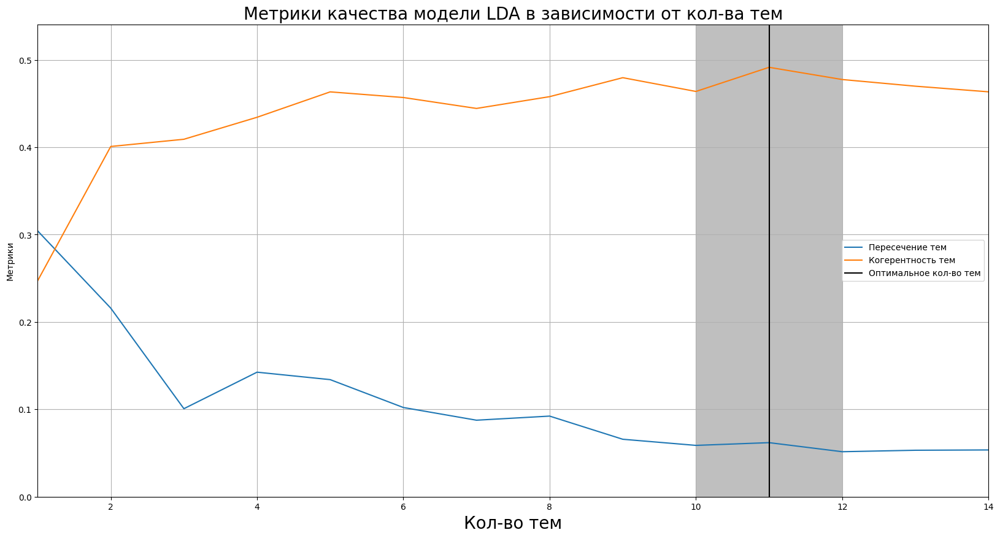

In [ ]:
plt.figure(figsize=(20,10))
ax = sns.lineplot(x=num_topics[:-1], y=mean_stabilities, label='Пересечение тем')
ax = sns.lineplot(x=num_topics[:-1], y=coherences, label='Когерентность тем')

ax.axvline(x=ideal_topic_num, label='Оптимальное кол-во тем', color='black')
ax.axvspan(xmin=ideal_topic_num - 1, xmax=ideal_topic_num + 1, alpha=0.5, facecolor='grey')

y_max = max(max(mean_stabilities), max(coherences)) + (0.10 * max(max(mean_stabilities), max(coherences)))
ax.set_ylim([0, y_max])
ax.set_xlim([1, num_topics[-1]-1])

ax.axes.set_title('Метрики качества модели LDA в зависимости от кол-ва тем', fontsize=20)
ax.set_ylabel('Метрики', fontsize=10)
ax.set_xlabel('Кол-во тем', fontsize=20)
plt.legend(fontsize=10,
           loc='center right')
ax.grid()
plt.show()

## Графики для лучшей LDA 11
### LDA_models[11]

In [16]:
# Make an index to word dictionary.
temp = dictionary[0]  # This is only to "load" the dictionary.
# dictionary это словарь словарей из которого берем только словарь id2token
id2word = dictionary.id2token

In [17]:
# лучшая модель после выявления, что оптимальное количество тем 11
# обучим отдельно, чтобы не брать из списка моделей
LDA_topics_11 = LdaModel(corpus=corpus, #
                             id2word=id2word, #
                             num_topics=11,
                             update_every=1,
                             chunksize=2130, # 2000
                             passes=20, # Number of passes through the corpus during training
                             alpha='auto',
                             iterations=50,
                             random_state=42)

In [22]:
from pprint import pprint

In [23]:
pprint(LDA_topics_11.print_topics())

[(0,
  '0.009*"толстой" + 0.008*"пушкин" + 0.007*"достоевский" + '
  '0.004*"французский" + 0.004*"сочинение" + 0.003*"некрасов" + '
  '0.003*"тургенев" + 0.003*"современник" + 0.003*"гоголь" + 0.002*"николай"'),
 (1,
  '0.010*"стих" + 0.007*"поэзия" + 0.007*"музыка" + 0.006*"стихотворение" + '
  '0.003*"поэтический" + 0.003*"переводчик" + 0.003*"переводить" + '
  '0.003*"песня" + 0.002*"музыкальный" + 0.002*"комментарий"'),
 (2,
  '0.005*"душа" + 0.005*"стих" + 0.003*"белый" + 0.003*"стихотворение" + '
  '0.002*"поэзия" + 0.002*"ночь" + 0.002*"мертвый" + 0.002*"сердце" + '
  '0.002*"небо" + 0.002*"солнце"'),
 (3,
  '0.004*"империя" + 0.004*"государство" + 0.004*"религиозный" + '
  '0.004*"историк" + 0.003*"церковь" + 0.003*"немецкий" + 0.003*"европа" + '
  '0.003*"святой" + 0.003*"религия" + 0.003*"древний"'),
 (4,
  '0.007*"художник" + 0.006*"андрей" + 0.005*"сергей" + 0.004*"музей" + '
  '0.004*"михаил" + 0.004*"презентация" + 0.004*"участник" + 0.004*"премия" + '
  '0.004*"проект" 

In [27]:
top_topics = LDA_topics_11.top_topics(corpus, topn=10)

In [30]:
top_topics[0]

([(0.006020766, 'премия'),
  (0.00423811, 'фантастика'),
  (0.0029615245, 'писательница'),
  (0.0024121185, 'америка'),
  (0.002397591, 'список'),
  (0.002389935, 'интервью'),
  (0.002336948, 'жанр'),
  (0.0021062691, 'критик'),
  (0.0019352705, 'сайт'),
  (0.0018756698, 'поэзия')],
 -1.1410123377485202)

In [31]:
topics = LDA_topics_11.show_topics(num_topics=-1, num_words=15, )
topics

[(0,
  '0.009*"толстой" + 0.008*"пушкин" + 0.007*"достоевский" + 0.004*"французский" + 0.004*"сочинение" + 0.003*"некрасов" + 0.003*"тургенев" + 0.003*"современник" + 0.003*"гоголь" + 0.002*"николай" + 0.002*"характер" + 0.002*"повесть" + 0.002*"белинский" + 0.002*"критик" + 0.002*"душа"'),
 (2,
  '0.005*"душа" + 0.005*"стих" + 0.003*"белый" + 0.003*"стихотворение" + 0.002*"поэзия" + 0.002*"ночь" + 0.002*"мертвый" + 0.002*"сердце" + 0.002*"небо" + 0.002*"солнце" + 0.002*"поэма" + 0.002*"тело" + 0.002*"твой" + 0.002*"нога" + 0.002*"бытие"'),
 (6,
  '0.011*"книжный" + 0.008*"библиотека" + 0.007*"магазин" + 0.006*"книжка" + 0.006*"издатель" + 0.006*"деньга" + 0.005*"рынок" + 0.005*"электронный" + 0.004*"продажа" + 0.004*"тираж" + 0.004*"интернет" + 0.003*"тысяча" + 0.003*"количество" + 0.003*"купить" + 0.003*"цена"'),
 (4,
  '0.007*"художник" + 0.006*"андрей" + 0.005*"сергей" + 0.004*"музей" + 0.004*"михаил" + 0.004*"презентация" + 0.004*"участник" + 0.004*"премия" + 0.004*"проект" + 0.00

In [19]:
len(LDA_topics[11])

NameError: name 'LDA_topics' is not defined

In [ ]:
wp = LDA_models[11].show_topic(10)
", ".join([word for word, prop in wp])

'животное, тело, мозг, ученый, вода, черный, японский, военный, вселенная, планета'

In [ ]:
sent_topics_df = pd.DataFrame(columns = ['Dominant_Topic', 'Perc_Contribution', 'Topic_Keywords'])
sent_topics_df

,Dominant_Topic,Perc_Contribution,Topic_Keywords


In [ ]:
def format_topics_sentences(ldamodel=LDA_models[11], corpus=corpus, texts=lm_text_copy, sent_topics_df=sent_topics_df):
    # Init output
    # Get main topic in each document
    for i, row_list in enumerate(ldamodel[corpus]):
        row = row_list[0] if ldamodel.per_word_topics else row_list
        # print(row)
        row = sorted(row, key=lambda x: (x[1]), reverse=True)
        # Get the Dominant topic, Perc Contribution and Keywords for each document
        for j, (topic_num, prop_topic) in enumerate(row):
            if j == 0:  # => dominant topic
                wp = ldamodel.show_topic(topic_num)
                topic_keywords = ", ".join([word for word, prop in wp])
                sent_topics_df = pd.concat(sent_topics_df, pd.Series([int(topic_num), round(prop_topic, 4), topic_keywords]), ignore_index=True)
            else:
                break
    #sent_topics_df.columns = ['Dominant_Topic', 'Perc_Contribution', 'Topic_Keywords']
    # Add original text to the end of the output
    contents = pd.Series(texts)
    sent_topics_df = pd.concat([sent_topics_df, contents], axis=1)
    return(sent_topics_df)


df_topic_sents_keywords = format_topics_sentences(ldamodel=LDA_models[11], corpus=corpus, texts=lm_text_copy)
# Format
df_dominant_topic = df_topic_sents_keywords.reset_index()
df_dominant_topic.columns = ['Document_No', 'Dominant_Topic', 'Topic_Perc_Contrib', 'Keywords', 'Text']
df_dominant_topic.head(10)

TypeError: concat() takes 1 positional argument but 2 positional arguments (and 1 keyword-only argument) were given

In [ ]:
sent_topics_df = pd.concat(sent_topics_df, pd.DataFrame(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords])), ignore_index=True)

pd.concat([df, pd.DataFrame([new_row])], ignore_index=True)

In [ ]:
import matplotlib.colors as mcolors

In [32]:
from collections import Counter
topics = LDA_topics_11.show_topics(num_topics=-1, num_words=15, formatted=False)
data_flat = [w for w_list in lm_text_copy for w in w_list]
counter = Counter(data_flat)
out = []
for i, topic in topics:
    for word, weight in topic:
        out.append([word, i , weight, counter[word]])
df = pd.DataFrame(out, columns=['word', 'topic_id', 'importance', 'word_count'])

In [33]:
df[df['topic_id']==5]

,word,topic_id,importance,word_count
75,премия,5,0.006021,2507
76,фантастика,5,0.004238,1390
77,писательница,5,0.002962,1420
78,америка,5,0.002412,1514
79,список,5,0.002398,1683
80,интервью,5,0.002390,1659
81,жанр,5,0.002337,2342
82,критик,5,0.002106,1962
83,сайт,5,0.001935,1026
84,поэзия,5,0.001876,3353


IndexError: list index out of range

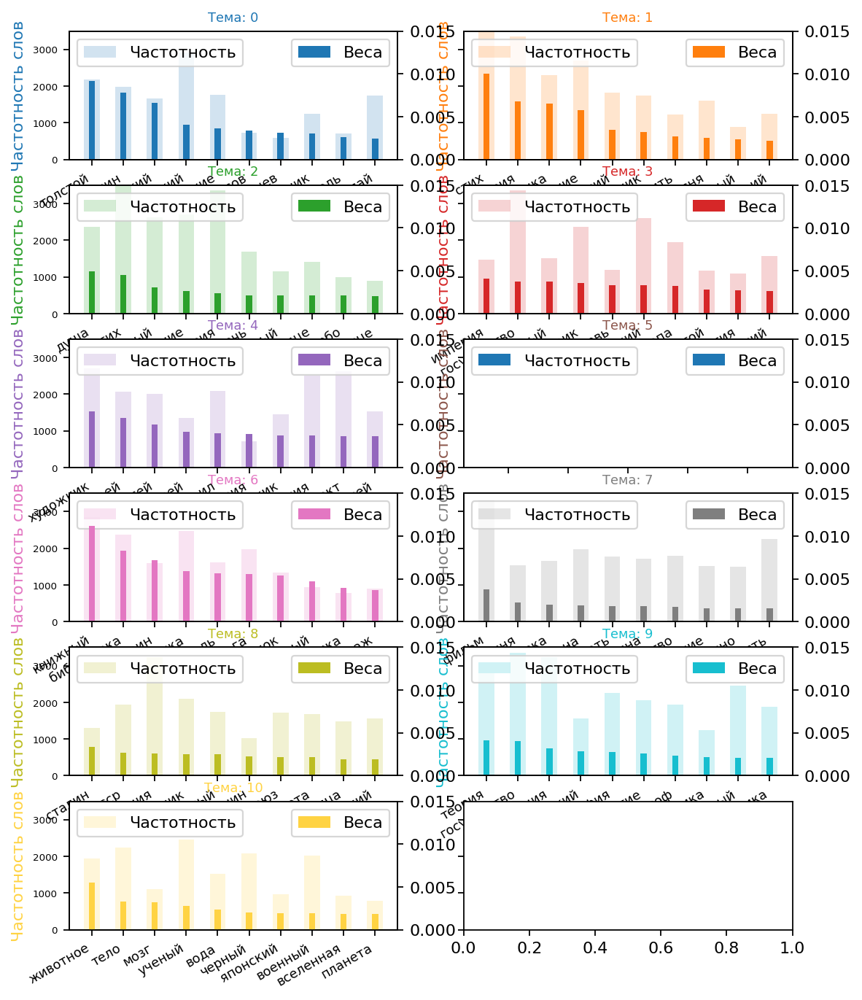

In [ ]:
from collections import Counter
topics = LDA_models[11].show_topics(num_topics=-1, formatted=False)
data_flat = [w for w_list in lm_text_copy for w in w_list]
counter = Counter(data_flat)
out = []
for i, topic in topics:
    for word, weight in topic:
        out.append([word, i , weight, counter[word]])
df = pd.DataFrame(out, columns=['word', 'topic_id', 'importance', 'word_count'])
# Plot Word Count and Weights of Topic Keywords
fig, axes = plt.subplots(6, 2, figsize=(8,10), sharey=True, dpi=160)
cols = [color for color in colors]
for i, ax in enumerate(axes.flatten()):
    ax.bar(x='word', height="word_count", data=df.loc[df.topic_id==i, :], color=cols[i], width=0.5, alpha=0.2, label='Частотность')
    ax_twin = ax.twinx()
    ax_twin.bar(x='word', height="importance", data=df.loc[df.topic_id==i, :], color=cols[i], width=0.2, label='Веса')
    ax.set_ylabel('Частотность слов', color=cols[i])
    ax_twin.set_ylim(0, 0.015); ax.set_ylim(0, 3500)
    ax.set_title('Тема: ' + str(i), color=cols[i], fontsize=8)
    ax.tick_params(axis='y', left=True, labelsize=6)
    ax.tick_params(axis='x', labelsize=8)
    ax.set_xticklabels(df.loc[df.topic_id==i, 'word'], rotation=30, horizontalalignment= 'right')
    ax.legend(loc='upper left'); ax_twin.legend(loc='upper right')
fig.tight_layout(w_pad=2)
fig.suptitle('Частотность и веса ключевых слов в темах', fontsize=16, y=1.05)
plt.show()

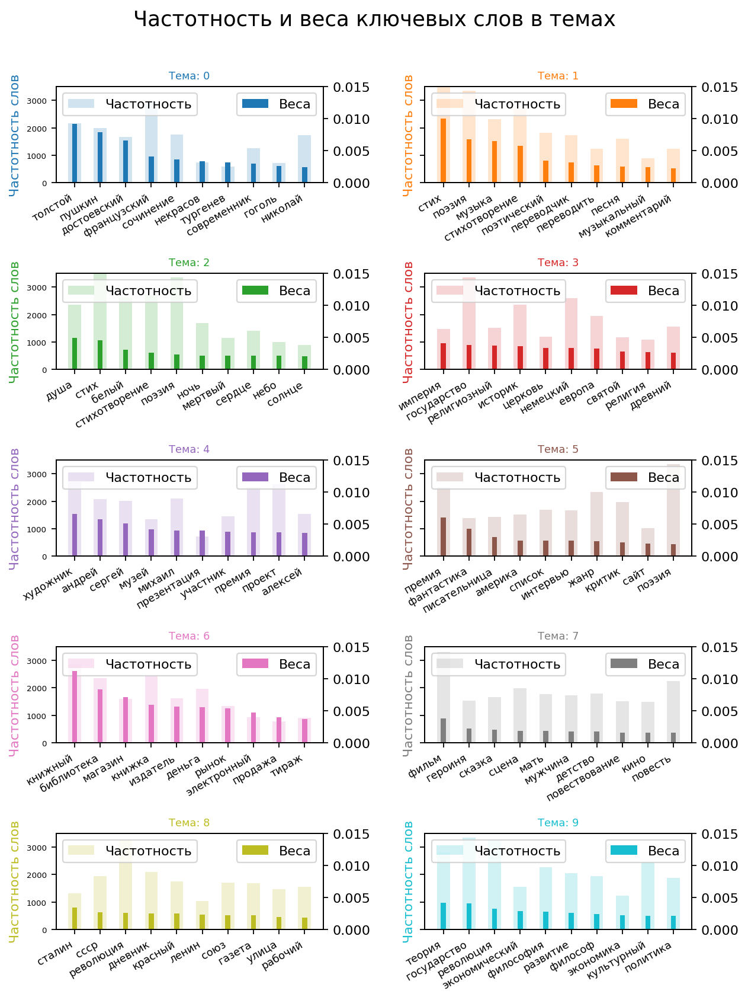

In [38]:
# не забывать про параметр num_topics=-1, чтобы выводились все темы
# .show_topics обычно округляет до 10

from collections import Counter
topics = LDA_topics_11.show_topics(num_topics=-1, formatted=False)
data_flat = [w for w_list in lm_text_copy for w in w_list]
counter = Counter(data_flat)
out = []
for i, topic in topics:
    for word, weight in topic:
        out.append([word, i , weight, counter[word]])
df = pd.DataFrame(out, columns=['word', 'topic_id', 'importance', 'word_count'])
# Plot Word Count and Weights of Topic Keywords
fig, axes = plt.subplots(5, 2, figsize=(8,10), sharey=True, dpi=160)
cols = [color for color in colors]
for i, ax in enumerate(axes.flatten()):
    ax.bar(x='word', height="word_count", data=df.loc[df.topic_id==i, :], color=cols[i], width=0.5, alpha=0.2, label='Частотность')
    ax_twin = ax.twinx()
    ax_twin.bar(x='word', height="importance", data=df.loc[df.topic_id==i, :], color=cols[i], width=0.2, label='Веса')
    ax.set_ylabel('Частотность слов', color=cols[i])
    ax_twin.set_ylim(0, 0.015); ax.set_ylim(0, 3500)
    ax.set_title('Тема: ' + str(i), color=cols[i], fontsize=8)
    ax.tick_params(axis='y', left=True, labelsize=6)
    ax.tick_params(axis='x', labelsize=8)
    ax.set_xticklabels(df.loc[df.topic_id==i, 'word'], rotation=30, horizontalalignment= 'right')
    ax.legend(loc='upper left'); ax_twin.legend(loc='upper right')
fig.tight_layout(w_pad=2)
fig.suptitle('Частотность и веса ключевых слов в темах', fontsize=16, y=1.05)
plt.show()

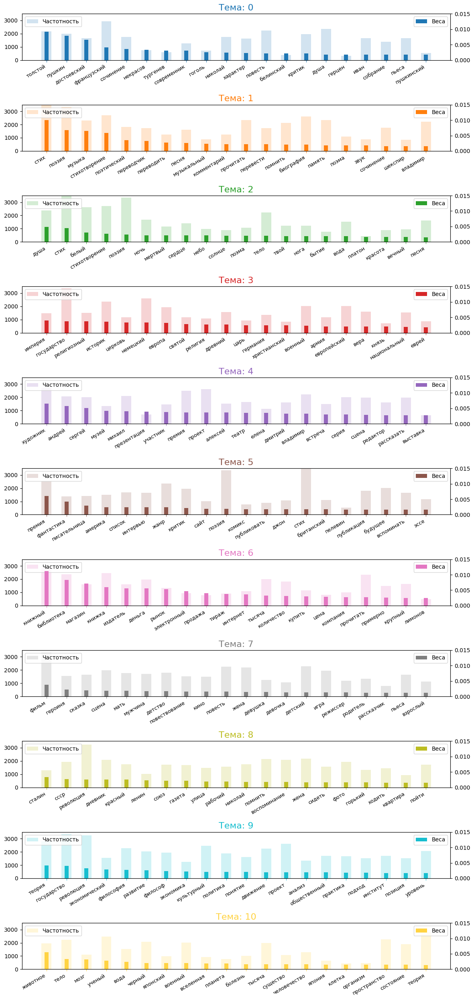

In [42]:
from collections import Counter
topics = LDA_topics_11.show_topics(num_topics=-1, num_words=20, formatted=False)
data_flat = [w for w_list in lm_text_copy for w in w_list]
counter = Counter(data_flat)
out = []
for i, topic in topics:
    for word, weight in topic:
        out.append([word, i , weight, counter[word]])
df = pd.DataFrame(out, columns=['word', 'topic_id', 'importance', 'word_count'])
# Plot Word Count and Weights of Topic Keywords
fig, axes = plt.subplots(11, 1, figsize=(12,25), sharey=True, dpi=100)
fig.tight_layout(pad=2.0)
cols = [color for color in colors]
for i, ax in enumerate(axes.flatten()):
    ax.bar(x='word', height="word_count", data=df.loc[df.topic_id==i, :], color=cols[i], width=0.5, alpha=0.2, label='Частотность')
    ax_twin = ax.twinx()
    ax_twin.bar(x='word', height="importance", data=df.loc[df.topic_id==i, :], color=cols[i], width=0.2, label='Веса')
    #ax.set_ylabel('Частотность слов', color=cols[i])
    ax_twin.set_ylim(0, 0.015); ax.set_ylim(0, 3500)
    ax.set_title('Тема: ' + str(i), color=cols[i], fontsize=16)
    ax.tick_params(axis='y', left=True, labelsize=10)
    ax.tick_params(axis='x', labelsize=9)
    ax.set_xticklabels(df.loc[df.topic_id==i, 'word'], rotation=30, horizontalalignment= 'right')
    ax.legend(loc='upper left'); ax_twin.legend(loc='upper right')
fig.tight_layout(w_pad=2)
#fig.suptitle('Частотность и веса ключевых слов в темах', fontsize=10, y=1.05)
plt.show()

In [ ]:
top_topics = LDA_topics_11.top_topics(corpus, topn=15)

In [ ]:
len(LDA_topics_11.show_topics(num_words=15, formatted=False))

10

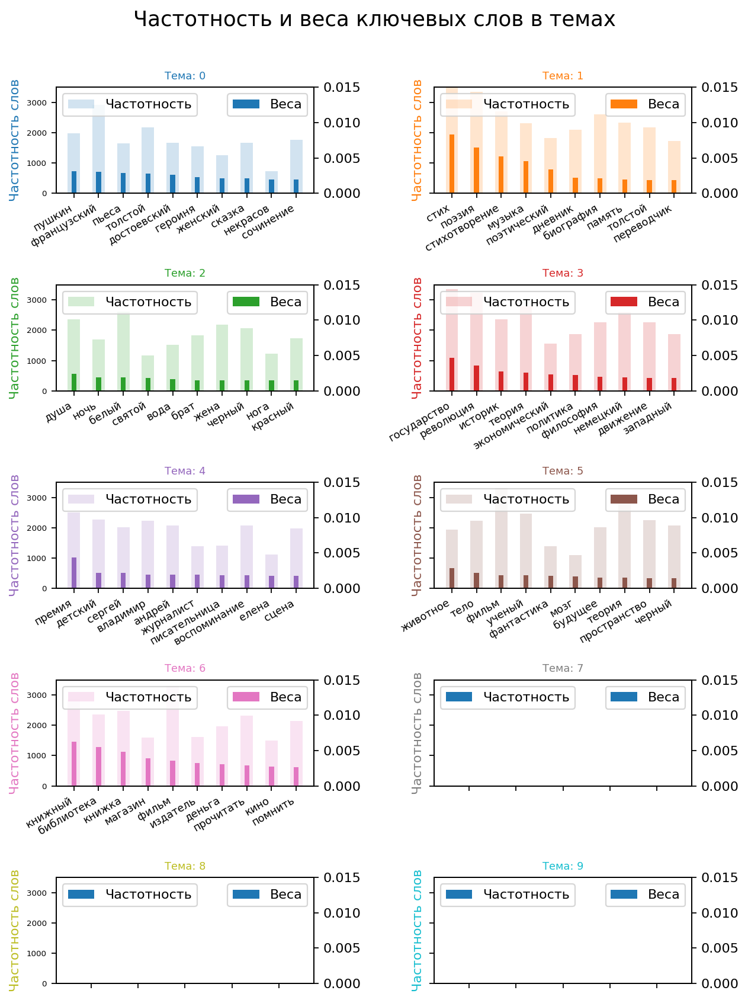

In [ ]:
from collections import Counter
topics = LDA_models[7].show_topics(formatted=False)
data_flat = [w for w_list in lm_text_copy for w in w_list]
counter = Counter(data_flat)
out = []
for i, topic in topics:
    for word, weight in topic:
        out.append([word, i , weight, counter[word]])
df = pd.DataFrame(out, columns=['word', 'topic_id', 'importance', 'word_count'])
# Plot Word Count and Weights of Topic Keywords
fig, axes = plt.subplots(5, 2, figsize=(8,10), sharey=True, dpi=160)
cols = [color for color in colors]
for i, ax in enumerate(axes.flatten()):
    ax.bar(x='word', height="word_count", data=df.loc[df.topic_id==i, :], color=cols[i], width=0.5, alpha=0.2, label='Частотность')
    ax_twin = ax.twinx()
    ax_twin.bar(x='word', height="importance", data=df.loc[df.topic_id==i, :], color=cols[i], width=0.2, label='Веса')
    ax.set_ylabel('Частотность слов', color=cols[i])
    ax_twin.set_ylim(0, 0.015); ax.set_ylim(0, 3500)
    ax.set_title('Тема: ' + str(i), color=cols[i], fontsize=8)
    ax.tick_params(axis='y', left=True, labelsize=6)
    ax.tick_params(axis='x', labelsize=8)
    ax.set_xticklabels(df.loc[df.topic_id==i, 'word'], rotation=30, horizontalalignment= 'right')
    ax.legend(loc='upper left'); ax_twin.legend(loc='upper right')
fig.tight_layout(w_pad=2)
fig.suptitle('Частотность и веса ключевых слов в темах', fontsize=16, y=1.05)
plt.show()

In [36]:
[color for name, color in mcolors.TABLEAU_COLORS.items()]

NameError: name 'mcolors' is not defined

In [35]:
colors = ['#1f77b4',
 '#ff7f0e',
 '#2ca02c',
 '#d62728',
 '#9467bd',
 '#8c564b',
 '#e377c2',
 '#7f7f7f',
 '#bcbd22',
 '#17becf',
'#ffd343']

In [ ]:
len(colors)

11

In [ ]:
mcolors.TABLEAU_COLORS.items()

TypeError: dict.items() takes no arguments (1 given)

In [ ]:
# разница
# Но нужно взять только темы для которых когерентности растут
# (как правило только четные или нечетные)
diff = np.diff(coherences)

In [ ]:
# масштабы изменения между последующим кл-вом тем и предыдущим
diff = diff[1:] / diff[:-1]

In [ ]:
diff

array([ 0.05368087,  3.04847899,  1.15549211, -0.22173648,  1.93973734,
       -1.07852519,  1.6096378 , -0.72595284, -1.75307744, -0.50574303,
        0.54624226,  0.84421518])

In [ ]:
[cl_text(t[0]) for t in tqdm(ll)]


100%|██████████| 10/10 [00:14<00:00,  1.41s/it]


[['академический',
  'проект',
  'петербургский',
  'издательство',
  'организовать',
  'игорь',
  'немировский',
  '1993',
  'путать',
  'одноименный',
  'московский',
  'издательство',
  'основать',
  '1997-м',
  'более',
  'десятилетний',
  'история',
  'свой',
  'существование',
  'выпустить',
  'целый',
  'классический',
  'труд',
  'вадим',
  'вацуро',
  'борис',
  'бухштаб',
  'другой',
  'прорубить',
  'российский',
  'читатель',
  'окно',
  'европа',
  'серия',
  'современный',
  'западный',
  'русистика',
  'реанимировать',
  'легендарный',
  'серия',
  'библиотека',
  'поэт',
  'спустя',
  'четверть',
  'проще',
  'оценить',
  'масштаб',
  'культурный',
  'задача',
  'который',
  'взять',
  'себя',
  'академический',
  'проект',
  'который',
  'тогда',
  'казаться',
  'невыполнимый',
  'восполнить',
  'множество',
  'пробел',
  'отечественный',
  'гуманитаристика',
  'сформировать',
  'собственный',
  'профиль',
  'отличный',
  'другой',
  'издательство',
  'заниматься',
  '

### Лемматизируем тексты

In [ ]:
# список списков
ll = df['cl_text'].tolist()
ll = [[t] for t in ll]

In [ ]:
lm_text = [cl_text(t[0]) for t in tqdm(ll)]


 96%|█████████▌| 4062/4253 [1:34:24<06:58,  2.19s/it]

In [ ]:
lm_text_copy = lm_text

In [ ]:
# импортировали функцию Phrases()из Gensim
from gensim.models import Phrases

# аргументы Phrases(sentences, min_count=5, threshold=10.0, delimiter=b'_')
# (1) sentences - список of токанизированных предложений (список списков - список предложений и в каждом список слов)
# (2) min_count - мин. частота с которой словосочетание должно встретиться в корпусе, чтобы считаться устойчивым
# (3) threshold -  порого встречаемости, чем выше тем меньше словосочетаний
# (4) delimiter - разделитель для объединения слов в сочетнии (! замена на delimiter=b' ' не работает)

In [ ]:
# создали объект Phrases() с заданными аргументами
phrases = Phrases(lm_text_copy, min_count=10, threshold=10)

In [ ]:
from tqdm import notebook

In [ ]:
# перебираем все тексты по индексу
# перебирем все токены в устойчивых словосочетаниях, которые в каждом тексте нашел Phrases()
# если в этом токене есть разделитель, установленный параметром delimiter=b'_' т.е. это устойчивое словосочетание
# то в заменим '_' на ' ' методом .replace()
# добавим в исходный текст устойчивое словосочетание

for i in notebook.tqdm(range(len(lm_text_copy))):
    for token in phrases[lm_text_copy[i]]:
        if '_' in token:
            token = token.replace("_", " ")
            lm_text_copy[i].append(token)

  0%|          | 0/4253 [00:00<?, ?it/s]

In [ ]:
# импортируем функцию Dictionary для создания словаря частотности токенов в тексте
from gensim.corpora import Dictionary

In [ ]:
# составили словарь, потом он будет передаваться в модели
dictionary = Dictionary(lm_text_copy)
# отбросили вернрхний и нижний экстретумы
dictionary.filter_extremes(no_below=10, no_above=0.3)

TypeError: doc2bow expects an array of unicode tokens on input, not a single string

In [ ]:
token2id = dictionary.token2id

In [ ]:
token2id

{'1980-й': 0,
 '1990-й': 1,
 '1991': 2,
 '1999': 3,
 '2000-х': 4,
 '2013': 5,
 '2017': 6,
 '2024': 7,
 'авторитетный': 8,
 'адрес': 9,
 'актерский': 10,
 'актерский игра': 11,
 'активный': 12,
 'алексей': 13,
 'андрей': 14,
 'араб': 15,
 'аргументировать': 16,
 'армия': 17,
 'арсенал': 18,
 'безуспешно': 19,
 'безуспешно пытаться': 20,
 'бескомпромиссно': 21,
 'библиотека': 22,
 'бизнес': 23,
 'благодарность': 24,
 'благородство': 25,
 'близкие': 26,
 'болезнь': 27,
 'бродский': 28,
 'бунимович': 29,
 'бывать': 30,
 'быстро': 31,
 'ваза': 32,
 'вариант': 33,
 'ввести': 34,
 'вгик': 35,
 'ведущий': 36,
 'вера': 37,
 'верность': 38,
 'веровать': 39,
 'весь равный': 40,
 'ветвь': 41,
 'вечер': 42,
 'вечный': 43,
 'вечный покой': 44,
 'видно': 45,
 'виктор': 46,
 'виновник': 47,
 'вкус': 48,
 'вместо': 49,
 'вмешательство': 50,
 'внешний': 51,
 'во-вторых': 52,
 'во-первых': 53,
 'водяной': 54,
 'возвращаться': 55,
 'возиться': 56,
 'возникнуть': 57,
 'восприятие': 58,
 'восхищаться': 59,


In [ ]:
# Преобразуем документ (список слов) в мешок слов формата list(token_id, token_count)
# назовем его corpus, а не BOW, т.к. потом он передается в модели Gensim в кач-ве параметра
corpus = [dictionary.doc2bow(t) for t in lm_text_copy]

In [ ]:
corpus[2452]

[(17, 1),
 (27, 1),
 (36, 1),
 (40, 1),
 (49, 3),
 (91, 1),
 (138, 1),
 (140, 1),
 (185, 1),
 (186, 1),
 (211, 1),
 (223, 1),
 (262, 1),
 (313, 1),
 (317, 2),
 (333, 1),
 (338, 1),
 (348, 1),
 (359, 1),
 (417, 1),
 (424, 1),
 (430, 1),
 (431, 1),
 (448, 1),
 (450, 1),
 (480, 1),
 (496, 3),
 (512, 1),
 (533, 1),
 (553, 1),
 (577, 9),
 (607, 1),
 (632, 1),
 (655, 2),
 (693, 1),
 (698, 1),
 (713, 1),
 (717, 1),
 (729, 1),
 (735, 1),
 (754, 1),
 (782, 1),
 (805, 1),
 (810, 2),
 (818, 1),
 (825, 1),
 (838, 1),
 (846, 1),
 (861, 1),
 (864, 1),
 (900, 1),
 (916, 1),
 (930, 1),
 (938, 1),
 (940, 1),
 (941, 1),
 (1025, 1),
 (1063, 1),
 (1076, 1),
 (1096, 1),
 (1111, 1),
 (1125, 1),
 (1130, 2),
 (1133, 1),
 (1138, 1),
 (1187, 1),
 (1189, 1),
 (1215, 1),
 (1218, 3),
 (1232, 11),
 (1251, 1),
 (1262, 1),
 (1295, 1),
 (1347, 2),
 (1348, 1),
 (1381, 1),
 (1397, 1),
 (1446, 1),
 (1479, 2),
 (1516, 1),
 (1533, 1),
 (1541, 1),
 (1542, 1),
 (1556, 1),
 (1594, 1),
 (1601, 1),
 (1657, 1),
 (1674, 1),
 (172

In [ ]:
# Обучение модели LDA
# Параметры:
# corpus - dictionary.doc2bow для каждого текста (см. выше)
# num_topics - количество тем на которые модель будет разделять тексты из корпуса
# chunksize - сколько документов пойдет в модель за раз (зависит от того, сколько влезет в память; влияет на качество) ставят len(corpus)
# passes = “epochs”
# iterations - сколько раз операция будет повторяться над каждым документом
# id2word - номера токенов из словаря выше id2word = dictionary.id2token
#
#
#
from gensim.models import LdaModel

In [ ]:
# Установим параметры для LDA модели
# их можно передать в виде словаря {}
num_topics = 7
chunksize = 1000
passes = 20
iterations = 400
eval_every = None

In [ ]:
%%time

# Make an index to word dictionary.
temp = dictionary[0]  # This is only to "load" the dictionary.
# dictionary это словарь словарей из которого берем только словарь id2token
id2word = dictionary.id2token

model = LdaModel(
    corpus=corpus,
    id2word=id2word,
    chunksize=chunksize,
    alpha='auto',
    eta='auto',
    iterations=iterations,
    num_topics=num_topics,
    passes=passes,
    eval_every=eval_every
)

CPU times: user 4min 14s, sys: 1min 6s, total: 5min 20s
Wall time: 4min 17s


In [ ]:
topics = model.show_topics(num_words=15, formatted=False)
topics

[(0,
  [('фантастика', 0.001732975),
   ('игра', 0.0016065481),
   ('повесть', 0.0015987143),
   ('жанр', 0.0015192375),
   ('главный герой', 0.0014544787),
   ('повествование', 0.0014521857),
   ('сказка', 0.0013923193),
   ('вода', 0.0013363409),
   ('путешествие', 0.0012129261),
   ('черный', 0.0011387003),
   ('ждать', 0.0011174853),
   ('будущее', 0.0010835504),
   ('2019', 0.0010724906),
   ('песня', 0.001058232),
   ('начинаться', 0.0009854675)]),
 (1,
  [('государство', 0.005553157),
   ('революция', 0.004451465),
   ('экономический', 0.002786017),
   ('политика', 0.002580565),
   ('экономика', 0.002467074),
   ('военный', 0.002376563),
   ('ссср', 0.0023524596),
   ('европа', 0.002148895),
   ('историк', 0.0021224075),
   ('империя', 0.002074818),
   ('население', 0.0019958527),
   ('государственный', 0.0019311726),
   ('борьба', 0.0019098505),
   ('тысяча', 0.0018080721),
   ('решение', 0.001786491)]),
 (2,
  [('жена', 0.0026978161),
   ('душа', 0.0023132558),
   ('брат', 0.0

- 0 fiction
- 1 социология политология экономика (социальные науки)
- 2 семейное, биография
- 3 книги, стихи, поэзия
- 4 литература и драматургия (кино, театр)
- 5 история, история россиия, религия
- 6 философия

In [ ]:
0

In [ ]:
# или так
# выводить по 40 наиболее часто встречающихся токенов для темы
top_topics = model.top_topics(corpus, topn=10)

In [ ]:
# посмотрим на ключевые слова темы [1]
# обратим внимание, что нумерация тем не совпадает с тем, что выше; остальное идентично
# в .top_topics() темы ранжированы по их когерентности: сначала темы с большей когерентностью, затем с меньшей
top_topics[6]

([(0.0032906346, 'историк'),
  (0.0026757575, 'древний'),
  (0.0026330128, 'французский'),
  (0.0024279004, 'пушкин'),
  (0.0024059247, 'сочинение'),
  (0.0023189902, 'исследователь'),
  (0.0021869568, 'русь'),
  (0.0021854802, 'церковь'),
  (0.0020942097, 'михаил'),
  (0.002094039, 'источник')],
 -1.457905582557949)

In [ ]:
top_topics = model.top_topics(corpus, topn=10)

# Average topic coherence is the sum of topic coherences of all topics, divided by the number of topics.
avg_topic_coherence = sum([t[1] for t in top_topics]) / num_topics
print('Average topic coherence: %.4f.' % avg_topic_coherence)
print()
from pprint import pprint
pprint(top_topics[1])
print()
pprint(top_topics[4])

Average topic coherence: -1.2500.

([(0.005553157, 'государство'),
  (0.004451465, 'революция'),
  (0.002786017, 'экономический'),
  (0.002580565, 'политика'),
  (0.002467074, 'экономика'),
  (0.002376563, 'военный'),
  (0.0023524596, 'ссср'),
  (0.002148895, 'европа'),
  (0.0021224075, 'историк'),
  (0.002074818, 'империя')],
 -1.1595395672571585)

([(0.007048047, 'фильм'),
  (0.0062551317, 'премия'),
  (0.004400582, 'режиссер'),
  (0.0037747615, 'стих'),
  (0.0036441295, 'писательница'),
  (0.0035578806, 'биография'),
  (0.0034312757, 'кино'),
  (0.0034071768, 'поэзия'),
  (0.0030234533, 'театр'),
  (0.0028328463, 'интервью')],
 -1.2315518168264028)


In [ ]:
# посмотрим какие темы в каких пропорциях присутствуют в тексте
vector = LDA_topics_11[corpus[229]]

vector

[(1, 0.03958462), (3, 0.5091697), (8, 0.1559808), (9, 0.29444316)]

на 40% философия, на 25% социальные науки - политология социология, экономика, на 17% литературный вымысел, 12% отечественная история и религия.

In [ ]:
ll[229]

['  В первую очередь я хочу рассказать о серии «Эпоха войн и революций», в которой вышло уже более десяти книг. Ее замысел — писать о войне в широком смысле этого слова. Не совсем понятно, когда началась Первая мировая, хотя вроде бы эта дата фиксированная. Если бы я затевал эту серию сейчас, то расширил бы ее рамки, потому что непонятно и то, когда эта война закончилась. В этой серии мы стараемся посмотреть на Первую мировую войну не только через участие в ней России — нас интересует нечто более глобальное. Сегодня я остановлюсь лишь на нескольких новых книгах из этой серии. Джей Уинтер, «Места памяти, места скорби. Первая мировая война в культурной истории Европы». Содержание. Фрагмент В последние несколько десятилетий возникла интеллектуальная мода на memory studies. У гуманитарных «исследований памяти» уже существует международная ассоциация со своим каноном — но оспариваемым, потому что у кого-то один канон, у кого-то другой. Эта мода докатилась и до России. Хотя у нас это скорее 

In [ ]:
df[df['cl_text'].str.contains(r"\bЛинн Хант", case=False)]

,Unnamed: 0,url,author,publ_date,title,subtitle,description,text,month_year,title_len,cl_text,text_len,rubric,year,lems
229,229,https://gorky.media/context/kto-pervyj-idet-za...,Incognito,2022-12-14,"«Кто первый идет за гробом, тот и главный»",Борис Колоницкий — о политике памяти и новинка...,Историк Борис Колоницкий выступил в книжном ма...,\nВ первую очередь я хочу рассказать о серии ...,2022-12,8,В первую очередь я хочу рассказать о серии «...,2849,context,2022,"['первый', 'очередь', 'хотеть', 'рассказать', ..."


In [ ]:
df.iloc[299]

,299
Unnamed: 0,299
url,https://gorky.media/context/pochemu-edinoj-yap...
author,Александр Мещеряков
publ_date,2022-06-21
title,Почему единой японской культуры не существует
subtitle,Японист Александр Мещеряков — о своей новой книге
description,Почему в разные эпохи японцы считали свою стра...
text,\nАлександр Мещеряков. Япония. В погоне за ве...
month_year,2022-06
title_len,6


In [ ]:
df[df['cl_text'].str.contains(r"\bЛинн Хант", case=False)]['subtitle']

NameError: name 'df' is not defined

In [ ]:
# обучим модель с 12-ю темами как выше

num_topics=12

LDA_12_top = LdaModel(
    corpus=corpus,
    id2word=id2word,
    chunksize=chunksize,
    alpha='auto',
    eta='auto',
    iterations=iterations,
    num_topics=num_topics,
    passes=passes,
    eval_every=eval_every
)

In [ ]:
topics_12 = LDA_12_top.show_topics(num_words=15, formatted=False)
topics_12

[(5,
  [('канон', 0.050396018),
   ('блум', 0.036049567),
   ('есенин', 0.028759839),
   ('кузмин', 0.023704838),
   ('мамлеев', 0.01771917),
   ('сологуб', 0.015917772),
   ('западный канон', 0.015120936),
   ('мюллер', 0.012833741),
   ('мамлей', 0.012750291),
   ('розанов', 0.011491332),
   ('виталиевич', 0.010949494),
   ('эренбург', 0.009738649),
   ('роза', 0.009094723),
   ('коллинза', 0.008814438),
   ('гарольд блум', 0.008760692)]),
 (6,
  [('пушкин', 0.04070083),
   ('стих', 0.037508674),
   ('стихотворение', 0.033882387),
   ('некрасов', 0.021816613),
   ('поэзия', 0.019784238),
   ('чуковский', 0.016108885),
   ('пастернак', 0.0116306245),
   ('переделкино', 0.011405814),
   ('франзен', 0.011115486),
   ('пушкинский', 0.009597996),
   ('евтушенко', 0.009313004),
   ('строка', 0.008608205),
   ('платонов', 0.008532082),
   ('рукопись', 0.008495506),
   ('поэтический', 0.007885983)]),
 (9,
  [('философия', 0.013451194),
   ('музыка', 0.011611411),
   ('философ', 0.010727373),

In [ ]:
# обучим модель с 12-ю темами как выше

num_topics=4

LDA_4_top = LdaModel(
    corpus=corpus,
    id2word=id2word,
    chunksize=chunksize,
    alpha='auto',
    eta='auto',
    iterations=iterations,
    num_topics=num_topics,
    passes=passes,
    eval_every=eval_every
)

In [ ]:
topics_4 = LDA_4_top.show_topics(num_words=15, formatted=False)
topics_4

[(0,
  [('французский', 0.0025327795),
   ('империя', 0.002408929),
   ('историк', 0.002212031),
   ('царь', 0.0019757026),
   ('древний', 0.0019707417),
   ('европа', 0.001953832),
   ('немецкий', 0.0017945431),
   ('князь', 0.0016944355),
   ('святой', 0.0016418344),
   ('император', 0.0016359113),
   ('русь', 0.0016191278),
   ('иван', 0.0016142876),
   ('премия', 0.0016057502),
   ('церковь', 0.0016009568),
   ('поэзия', 0.001594446)]),
 (1,
  [('фильм', 0.0016216489),
   ('героиня', 0.0013439988),
   ('тело', 0.0012344376),
   ('повесть', 0.0011788508),
   ('игра', 0.0011755367),
   ('мать', 0.0011438419),
   ('черный', 0.0011028814),
   ('мужчина', 0.0010581259),
   ('душа', 0.0010513505),
   ('жена', 0.001049479),
   ('главный герой', 0.001049132),
   ('голос', 0.0010446346),
   ('премия', 0.0010166556),
   ('ночь', 0.0010123663),
   ('ждать', 0.0010015123)]),
 (2,
  [('стих', 0.0040076296),
   ('книжный', 0.0025620977),
   ('музыка', 0.0023437901),
   ('поэзия', 0.0023430232),


In [ ]:
from gensim.models.coherencemodel import CoherenceModel
# рассчитали с_v когерентность для 7 и 12 тем
# обратим внимание на то, что вместо параметра 'corpus' у C_V coherence параметр 'texts'

cv_Coh_4_top = CoherenceModel(model=LDA_4_top, texts=lm_text_copy, dictionary=dictionary, coherence='c_v')
cv_Coh_7_top = CoherenceModel(model=model, texts=lm_text_copy, dictionary=dictionary, coherence='c_v')
cv_Coh_12_top = CoherenceModel(model=LDA_12_top, texts=lm_text_copy, dictionary=dictionary, coherence='c_v')

In [ ]:
print('c_v когерентность модели с 4-я темами:', cv_Coh_4_top.get_coherence())
print()
print('c_v когерентность модели с 7-ю темами:', cv_Coh_7_top.get_coherence())
print()
print('c_v когерентность модели с 12-ю темами:', cv_Coh_12_top.get_coherence())

c_v когерентность модели с 4-я темами: 0.40873357794584186

c_v когерентность модели с 7-ю темами: 0.4297061639418195

c_v когерентность модели с 12-ю темами: 0.4422370807433596


In [ ]:
all_topics = model.get_document_topics(corpus)

In [ ]:
def format_topics_sentences(ldamodel, corpus, texts):
    # Init output
    sent_topics_df = pd.DataFrame()

    # Get main topic in each document
    for i, row_list in enumerate(ldamodel[corpus]):
        row = row_list[0] if ldamodel.per_word_topics else row_list
        # print(row)
        row = sorted(row, key=lambda x: (x[1]), reverse=True)
        # Get the Dominant topic, Perc Contribution and Keywords for each document
        for j, (topic_num, prop_topic) in enumerate(row):
            if j == 0:  # => dominant topic
                wp = ldamodel.show_topic(topic_num)
                topic_keywords = ", ".join([word for word, prop in wp])
                sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
            else:
                break
    sent_topics_df.columns = ['Dominant_Topic', 'Perc_Contribution', 'Topic_Keywords']

    # Add original text to the end of the output
    contents = pd.Series(texts)
    sent_topics_df[''] = pd.concat([sent_topics_df, contents], axis=1)
    return(sent_topics_df)

In [ ]:
df_topic_sents_keywords = format_topics_sentences(ldamodel=model, corpus=corpus, texts=lm_text_copy)

AttributeError: 'DataFrame' object has no attribute 'append'

In [43]:
!pip install bokeh

In [44]:
# импорт библиотек
from sklearn.manifold import TSNE
from bokeh.plotting import figure, output_file, show
from bokeh.models import Label
from bokeh.io import output_notebook

In [45]:
# LDA_11 = LDA_models[11]
LDA_11 = LDA_topics_11

In [46]:
# из doc_lda создадим список списков, в котором в кажом вложенном списке/тексте элементами будут кортеджи (tuple)
# каждый кортедж (номер темы в тексте, вес темы в тексте)
topic_score = []
for i, row_list in enumerate(LDA_11[corpus]):
        topic_score.append(row_list[0] if LDA_11.per_word_topics else row_list)

In [47]:
# на вход берет строку, список кортежей и количество тем lda модели
# result nt xs - это пустые списки
# на выходе список кортежей в правильном порядке с нулями для тем, которых нет

def topics_order(tuples_row, numb_of_topics, result=None, nt=None, xs=None):

    result = [] if result is None else result
    nt = [] if nt is None else nt
    xs = [] if xs is None else xs

    for x, y in tuples_row:
        xs.append(x)
        result.append( (x,y) )
    for nx in list(range(numb_of_topics)):
        if nx not in xs:
            nt.append(nx)
    for n in nt:
        result.append( (n, 0) )
    return sorted(result, key=lambda x: (x[0]))

In [48]:
# применим функцию выше
topic_score_ord = [topics_order(row, 11) for row in topic_score]

In [49]:
topic_score_ord[0]

[(0, 0),
 (1, 0.20814621),
 (2, 0.11239502),
 (3, 0),
 (4, 0.14793403),
 (5, 0),
 (6, 0.010446789),
 (7, 0.21634829),
 (8, 0.26011252),
 (9, 0.036938924),
 (10, 0)]

In [50]:
# посмотрим как отработала
topic_score_ord[229]

[(0, 0),
 (1, 0.039587922),
 (2, 0),
 (3, 0.5091696),
 (4, 0),
 (5, 0),
 (6, 0),
 (7, 0),
 (8, 0.15597908),
 (9, 0.29444173),
 (10, 0)]

In [ ]:
topic_score_ord[3710]

[(0, 0),
 (1, 0),
 (2, 0),
 (3, 0.87898177),
 (4, 0),
 (5, 0),
 (6, 0),
 (7, 0),
 (8, 0),
 (9, 0.11916003),
 (10, 0)]

In [51]:
# получим только веса тем без их номеров (в стандартном порядке) для каждого предложения
# кортежи преобразуются в списки

topic_score_res = [[score[1] for score in t] for t in topic_score_ord]

In [ ]:
topic_labels = [[score[0] for score in t] for t in topic_score_ord]

In [52]:
# Сделаем из списка списков датафрейм и заполним пропуски (темы, которых в документе нет) 0
# и затем df в массив .values (можно также через df.as_matrix())
arr = pd.DataFrame(topic_score_res).values

In [53]:
arr.shape

(4253, 11)

## Найдем тексты наиболее похожие на 229

In [ ]:
score_229 = [score[1] for score in topic_score_ord[229]]

In [ ]:
score_229

[0, 0.039592195, 0, 0.5091702, 0, 0, 0, 0, 0.15597652, 0.29443944, 0]

In [ ]:
# сделаем вектор из списка выше
v_229 = np.array(score_229)

In [ ]:
# умножаем полученный вектор на матрицу всех векторов
scores = np.matmul(arr, v_229)

In [ ]:
# количество оценок должно быть равно количеству текстов
scores.shape

(4253,)

In [ ]:
np.argsort(scores)[:10]

array([2218, 1240, 4036,  998, 3345, 1426, 1237, 3355, 3583,  582])

In [ ]:
# argsort() возвращает список [] индексов отсортированных элементов массива

np.argsort(scores)[-20:]

array([ 296,  130,  351, 2814, 3910,  273,  885, 3728, 3057, 3241, 4151,
          6,  241,  279, 3710, 2956,  254, 3332, 4091,  934])

In [ ]:
# взяли только нужные строки из df
like_229 = df.loc[[296,  130,  351, 2814, 3910,  273,  885, 3728, 3057, 3241, 4151, 6,  241,  279, 3710, 2956,  254, 3332, 4091,  934]]

In [ ]:
mixes_like_229 = []
for i in [296,  130,  351, 2814, 3910, 273, 885, 3728, 3057, 3241, 4151, 6,  241,  279, 3710, 2956, 254, 3332, 4091, 934]:
  mixes_like_229.append(LDA_topics_11[corpus[229]])


In [ ]:
mixes_like_229[0]

[(1, 0.039595958), (3, 0.50917184), (8, 0.1559736), (9, 0.29443693)]

In [ ]:
like_229 =like_229[['url', 'author', 'publ_date', 'title', 'subtitle', 'description']]

In [ ]:
like_229['mix'] = mixes_like_229

In [ ]:
like_229

,url,author,publ_date,title,subtitle,description,mix
296,https://gorky.media/context/kak-chitat-povest-...,Андрей Ранчин,2022-06-27,Как читать «Повесть временных лет»,Андрей Ранчин — об одной из основополагающих р...,С «Повестью временных лет» так или иначе знако...,"[(1, 0.039595958), (3, 0.50917184), (8, 0.1559..."
130,https://gorky.media/context/kreshhenie-irtyshom/,Филипп Никитин,2023-05-16,Крещение Иртышом,Семь книг о баптизме в России,"Не так давно мы уже разобрались, что почитать ...","[(1, 0.03959289), (3, 0.50917065), (8, 0.15597..."
351,https://gorky.media/context/kak-chitat-slovo-o...,Андрей Ранчин,2022-03-09,Как читать «Слово о Законе и Благодати»,Андрей Ранчин — о самом раннем из дошедших до ...,"«Слово о Законе и Благодати» — произведение, с...","[(1, 0.039596546), (3, 0.50917053), (8, 0.1559..."
2814,https://gorky.media/reviews/pochemu-my-lyubim-...,Николай Родосский,2022-01-19,Почему мы любим тиранию,О книге Яна Ассмана «Политическая теология меж...,Для Яна Ассмана два древних народа — египтяне ...,"[(1, 0.03959608), (3, 0.5091711), (8, 0.155973..."
3910,https://gorky.media/reviews/rozhdenie-rossii-i...,Дмитрий Стахов,2018-10-03,Рождение России и Немецкий орден,Обзор новых книг по отечественной истории,Очередной обзор новинок по отечественной истор...,"[(1, 0.03958959), (3, 0.5091698), (8, 0.155978..."
273,https://gorky.media/context/kak-chitat-zhitie-...,Андрей Ранчин,2022-08-23,Как читать Житие Александра Невского,Андрей Ранчин — о первом древнерусском житии к...,"Как вышло, что Житие Александра Невского появи...","[(1, 0.039578695), (3, 0.50916994), (8, 0.1559..."
885,https://gorky.media/context/kak-chtenie-biblii...,Илья Мельников,2020-08-12,Как чтение Библии заложило в головах крестьян ...,Первая часть рассказа о читательских практиках...,Церковный раскол XVII века имел неожиданные по...,"[(1, 0.039594628), (3, 0.5091701), (8, 0.15597..."
3728,https://gorky.media/reviews/konstruktor-ukraina/,Николай Проценко,2019-05-23,Конструктор «Украина»,Рецензия на книгу о формировании украинской нации,"Споры о том, откуда взялись и как формировалис...","[(1, 0.039576557), (3, 0.5091698), (8, 0.15598..."
3057,https://gorky.media/reviews/shestnadtsat-otten...,Николай Проценко,2021-05-24,Шестнадцать оттенков средневекового империализма,Николай Проценко — о книге «Империи Средневеко...,Сколько средневековых империй вспомнит навскид...,"[(1, 0.039570395), (3, 0.5091699), (8, 0.15598..."
3241,https://gorky.media/reviews/po-zakonu-step-kru...,Федор Синицын,2020-12-08,По закону степь кругом,"Рецензия на книгу «Эксперименты империи: Адат,...",Книга историков Паоло Сартори и Павла Шаблея п...,"[(1, 0.039594147), (3, 0.50917053), (8, 0.1559..."


In [103]:
# Keep the well separated points (optional)
# np.amax возвращает максимум массива или максимум вдоль оси
arr = arr[np.amax(arr, axis=1) > 0.2]

In [104]:
# Dominant topic number in each doc
topic_num = np.argmax(arr, axis=1)

In [109]:
topic_num_list = (list(topic_num))

Тема_0: Русская классика, отеч. проза <br>
Тема_1: Лирика, критика, переводная лит-ра, музыка <br>
Тема_2: Душевная поэзия, телесность, философия <br>
Тема_3: Сравнительная история (ист. гос-ва, религ., воен.) <br>
Тема_4: Культурные проекты, мероприятия, лит. премии <br>
Тема_5: Фантастика, премии <br>
Тема_6: Издательское(-ий) дело, рынок <br>
Тема_7: Лит-ра и драматургия, феминизм <br>
Тема_8: Рев. 1917, СССР, память <br>
Тема_9: Социальные науки (соц., полит., эк., филос.) <br>
Тема_10: Естественные науки (физиол., биол., физ., астр.), Япония <br>

In [114]:
dic = {0:'Тема_0: Русская классика, отеч. проза',
            1:'Тема_1: Лирика, критика, \n переводная лит-ра, музыка',
            2:'Тема_2: Душевная поэзия, \n телесность, философия',
            3:'Тема_3: Сравнительная история \n (ист. гос-ва, религ., воен.)',
            4:'Тема_4: Культурные проекты, \n мероприятия, лит. премии',
            5:'Тема_5: Фантастика, премии',
            6:'Тема_6: Издательское(-ий) дело, рынок',
            7:'Тема_7: Лит-ра и драматургия, феминизм',
            8:'Тема_8: Рев. 1917, СССР, память',
            9:'Тема_9: Социальные науки \n (соц., полит., эк., филос.)',
            10:'Тема_10: Естественные науки \n (физиол., биол., физ., астр.), Япония'}

In [115]:
topic_names_list = [dic.get(e, e) for e in topic_num_list]

In [113]:
topic_names_list

['Тема_8: Рев. 1917, СССР, память',
 'Тема_1: Лирика, критика, переводная лит-ра, музыка',
 'Тема_1: Лирика, критика, переводная лит-ра, музыка',
 'Тема_7: Лит-ра и драматургия, феминизм',
 'Тема_3: Сравнительная история (ист. гос-ва, религ., воен.)',
 'Тема_10: Естественные науки (физиол., биол., физ., астр.), Япония',
 'Тема_9: Социальные науки (соц., полит., эк., филос.)',
 'Тема_6: Издательское(-ий) дело, рынок',
 'Тема_0: Русская классика, отеч. проза',
 'Тема_8: Рев. 1917, СССР, память',
 'Тема_4: Культурные проекты, мероприятия, лит. премии',
 'Тема_2: Душевная поэзия, телесность, философия',
 'Тема_0: Русская классика, отеч. проза',
 'Тема_8: Рев. 1917, СССР, память',
 'Тема_8: Рев. 1917, СССР, память',
 'Тема_9: Социальные науки (соц., полит., эк., филос.)',
 'Тема_2: Душевная поэзия, телесность, философия',
 'Тема_7: Лит-ра и драматургия, феминизм',
 'Тема_3: Сравнительная история (ист. гос-ва, религ., воен.)',
 'Тема_8: Рев. 1917, СССР, память',
 'Тема_1: Лирика, критика, пе

In [72]:
np.unique(topic_num).astype(str)

array(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10'],
      dtype='<U21')

In [105]:
# tSNE Dimension Reduction
tsne_model = TSNE(n_components=2, verbose=1, random_state=0, angle=.99, init='pca')
tsne_lda = tsne_model.fit_transform(arr)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 3938 samples in 0.007s...
[t-SNE] Computed neighbors for 3938 samples in 0.399s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3938
[t-SNE] Computed conditional probabilities for sample 2000 / 3938
[t-SNE] Computed conditional probabilities for sample 3000 / 3938
[t-SNE] Computed conditional probabilities for sample 3938 / 3938
[t-SNE] Mean sigma: 0.013568
[t-SNE] KL divergence after 250 iterations with early exaggeration: 76.794968
[t-SNE] KL divergence after 1000 iterations: 1.293680


In [41]:
import matplotlib.colors as mcolors, math

In [57]:
from bokeh.io import output_notebook

In [79]:
from bokeh.transform import factor_cmap
from bokeh.models import ColumnDataSource

array([ 1.4923251,  0.1769849, -4.92867  , ...,  0.8975248, 20.826517 ,
       29.230297 ], dtype=float32)

In [82]:
source = ColumnDataSource(dict(
    x=tsne_lda[:,0],
    y=tsne_lda[:,1],
    color=mycolors[topic_num],
    label=(list(topic_num))
))

In [118]:
# Plot the Topic Clusters using Bokeh
output_notebook()
n_topics = 11
mycolors = np.array([color for color in colors])


plot = figure(title="Тексты Горького в зависимости от доминирующей в них тематики из {} тематик выделенных LDA".format(n_topics),
              width=1000, height=1000)

source = ColumnDataSource(dict(
    x=tsne_lda[:,0],
    y=tsne_lda[:,1],
    color=mycolors[topic_num],
    label=topic_names_list))

plot.scatter(x="x", y="y", source=source,
          color='color',
         legend_group='label')
#plot.scatter(x=tsne_lda[:,0],
            # y=tsne_lda[:,1],
           #  color=mycolors[topic_num]
            # )
plot.legend.title = "Тематики:"



show(plot)

# Эмбеддинги Yandex GPT



*   Прежде, чем получать эмбеддинги надо убрать из корпуса экстремально длинные и экстремально короткие тексты. В противном случае много нулей при сжатии эмбеддингов PCA вопреки всякой семантике помещают их в отдельный кластер. (т.к. основные векторы у них нули). При повторном сжатии
*   Новый пункт



In [ ]:
import torch

In [ ]:
!pip install datasets
!pip install -U python-dotenv
!pip install langchain
!pip install -U langchain-community
!pip install -U pypdf
!pip install chromadb
!pip install yandexcloud
!pip install tiktoken

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 480.6/480.6 kB 12.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 8.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 179.3/179.3 kB 9.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 9.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.1/194.1 kB 12.8 MB/s eta 0:00:00
  Attempting uninstall: fsspec
    Found existing installation: fsspec 2024.10.0
    Uninstalling fsspec-2024.10.0:
      Successfully uninstalled fsspec-2024.10.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
gcsfs 2024.10.0 requires fsspec==2024.10.0, but you have fsspec 2024.9.0 which is incompatible.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.4/2.4 MB 35.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 51.2 MB/s eta 0:00:00
   ━━━━━━

In [ ]:
import random
import requests
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd
import time as t
import re # Регулярные выражения
from random import randint # для рандомизации времени засыпания
from tqdm import tqdm_notebook
from tqdm import notebook

from datasets import Dataset
from dotenv import dotenv_values
from langchain.document_loaders import PyPDFLoader
from langchain.text_splitter import CharacterTextSplitter
from langchain.text_splitter import TokenTextSplitter
from langchain_community.embeddings.yandex import YandexGPTEmbeddings
from langchain_community.llms import YandexGPT
from langchain.chains import RetrievalQA
from langchain.vectorstores import Chroma

# для суммаризации
from langchain.chains.summarize import load_summarize_chain
from langchain.chains.question_answering import load_qa_chain
from langchain.chains.combine_documents import create_stuff_documents_chain
from langchain_core.prompts import ChatPromptTemplate
from langchain_core.prompts import PromptTemplate
from langchain.text_splitter import RecursiveCharacterTextSplitter
#from langchain_experimental.text_splitter import SemanticChunker

/usr/local/lib/python3.10/dist-packages/pydantic/_internal/_fields.py:132: UserWarning: Field "model_uri" in _BaseYandexGPT has conflict with protected namespace "model_".

You may be able to resolve this warning by setting `model_config['protected_namespaces'] = ()`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/pydantic/_internal/_fields.py:132: UserWarning: Field "model_name" in _BaseYandexGPT has conflict with protected namespace "model_".

You may be able to resolve this warning by setting `model_config['protected_namespaces'] = ()`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/pydantic/_internal/_fields.py:132: UserWarning: Field "model_version" in _BaseYandexGPT has conflict with protected namespace "model_".

You may be able to resolve this warning by setting `model_config['protected_namespaces'] = ()`.
  warnings.warn(


In [ ]:
import random
import requests
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd
import time as t
import re # Регулярные выражения
from random import randint # для рандомизации времени засыпания
from tqdm import tqdm_notebook
from tqdm import notebook

In [ ]:
# отключение предупреждений
import warnings
warnings.filterwarnings("ignore")
import os

In [ ]:
# Загрузим переменные окружения из файла env.txt
env_vars = dotenv_values('env.txt')

# Эксплицитно установим переменные окружения из файла env.txt чтобы перезаписать глобальные переменные, если они есть
for key, value in env_vars.items():
    os.environ[key] = value

# Проверим загрузку переменных окружения
if 'YC_API_KEY' in os.environ:
    print(f"YC_API_KEY и YC_FOLDER_ID успешно загружены")
else:
    print("Ничего не загрузилось")

YC_API_KEY и YC_FOLDER_ID успешно загружены


In [ ]:
embeddings = YandexGPTEmbeddings()


In [ ]:
df = pd.read_csv(r'gorky_join_lemms_df.csv')
df = df.drop('Unnamed: 0', axis=1)

### Укорачивание

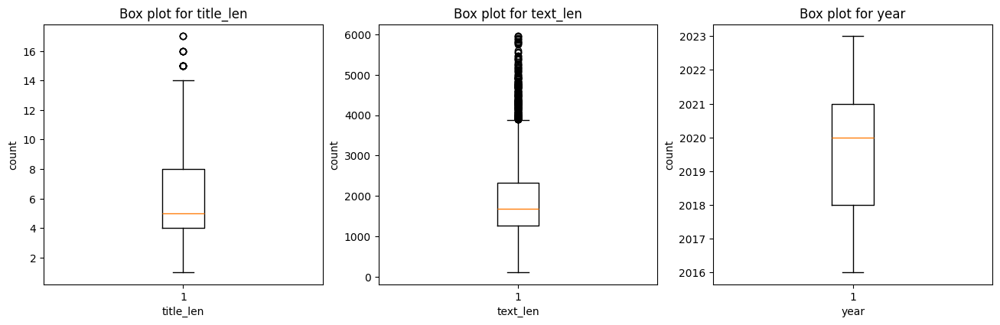

In [ ]:
# цикл для проверки данных на выбросы:
# построит для всех признаков формата int и float ящики с усами:

i = 1
plt.figure(figsize=(16,15))
for col_name in list(df.columns):
    if((df[col_name].dtypes=='int64' or df[col_name].dtypes=='float64') and col_name != 'charges'):
        plt.subplot(3,3, i)
        plt.boxplot(df[col_name])
        plt.xlabel(col_name)
        plt.ylabel('count')
        plt.title(f"Box plot for {col_name}")
        i += 1
plt.show()

In [ ]:
len(df[df['text_len'] >= 3800])

222

In [ ]:
df[df['text_len'] < 500]

,url,author,publ_date,title,subtitle,description,text,month_year,title_len,cl_text,text_len,rubric,year,lems
344,https://gorky.media/context/sovetskih-lyudej-v...,Всеволод Емелин,2022-03-22,"«Советских людей все меньше, а „Сталина“ продо...",Памяти Юза Алешковского,21 марта не стало русского поэта и писателя Юз...,"А вот написать три песни, которые знает и поет...",2022-03,8,"А вот написать три песни, которые знает и поет...",324,context,2022,"['написать', 'песня', 'который', 'знать', 'пет..."
353,https://gorky.media/context/obrashhenie-k-chit...,Incognito,2022-03-02,Обращение к читателям «Горького»,,,Начиная с раннего утра 24 февраля 2022 года вс...,2022-03,4,Начиная с раннего утра 24 февраля 2022 года вс...,222,context,2022,"['начинать', 'ранний', 'утро', 'февраль', 'вес..."
659,https://gorky.media/context/u-vasi-bylo-svojst...,Андрей Родионов,2021-04-13,"«У Васи было свойство, которое я в людях очень...",Памяти писателя Василия Голованова,"Не стало писателя и путешественника, журналист...",Мы познакомились в нулевых в Красноярске — он ...,2021-04,14,Мы познакомились в нулевых в Красноярске — он ...,398,context,2021,"['познакомиться', 'нулевой', 'красноярск', 'пи..."
1055,https://gorky.media/context/vor-tenej-trojka-k...,Эдуард Лукоянов,2020-01-09,Вор теней и тройка коллекторов,"Комикс Алексея Волкова, Кирилла Кутузова и Але...",Добро пожаловать во вселенную изнаночных казак...,«Горький» никогда не был и не будет сайтом для...,2020-01,5,«Горький» никогда не был и не будет сайтом для...,225,context,2020,"['горький', 'никогда', 'быть', 'быть', 'сайт',..."
1084,https://gorky.media/context/putevoditel-po-non...,Incognito,2019-11-28,Путеводитель по Non/fiction: что купить на гла...,Самые интересные новинки ярмарки 2019 года: вы...,C 5 по 9 декабря в Гостином дворе (ул. Ильинка...,Новый роман Эдуарда Лимонова заявлен автором к...,2019-11,9,Новый роман Эдуарда Лимонова заявлен автором к...,313,context,2019,"['новый', 'роман', 'эдуард', 'лимонов', 'заяви..."
1169,https://gorky.media/context/chem-zanyatsya-na-...,Incognito,2019-09-10,Чем заняться на ярмарке Rassvet Book Fair,Гид по книжному фестивалю на заводе «Рассвет»,В ближайшие выходные на территории бывшего зав...,🗓 14 сентября\n12:00–12:40 Где запасная планет...,2019-09,7,🗓 14 сентября 12:00–12:40 Где запасная планета...,332,context,2019,"['сентябрь', 'запасный', 'планета', 'владимир'..."
1283,https://gorky.media/context/knizhnaya-yarmarka...,Incognito,2019-05-24,Книжная ярмарка Garage Art Book Fair и принт-м...,Чем заняться на майской ярмарке в «Гараже»,По традиции в конце мая в Москве в музее «Гара...,"24 мая, пятница\n16:00 — 18:00 Лекторий Музея ...",2019-05,10,"24 мая, пятница 16:00 — 18:00 Лекторий Музея «...",316,context,2019,"['пятница', 'лекторий', 'музей', 'гараж', 'лек..."
1466,https://gorky.media/context/putevoditel-po-non...,Incognito,2018-11-23,Путеводитель по Non/fiction — 2018,"100 книг, изданных к главной книжной ярмарке",C 28 ноября по 2 декабря 2018 года в Центральн...,Зинара Мухина.Русская крестьянка в пореформенн...,2018-11,5,Зинара Мухина.Русская крестьянка в пореформенн...,388,context,2018,"['зинара', 'мухин', 'русский', 'крестьянка', '..."
1485,https://gorky.media/context/politicheskie-zhiv...,Incognito,2018-11-08,Политические животные и заклятые друзья,Гид по Пятому фестивалю премии «Просветитель»:...,15 ноября в Москве будет вручена премия «Просв...,8 ноября\n19:00\nКавказская война: прошлое в н...,2018-11,5,8 ноября 19:00 Кавказская война: прошлое в нас...,350,context,2018,"['ноябрь', 'кавказский', 'война', 'прошлое', '..."
1492,https://gorky.media/context/samyj-strashnyj-fe...,Василий Владимирский,2018-11-02,Самый Страшный Фестиваль. Хеллоуинские тезисы,Хоррор в России: отчет за 2018 год,31 октября в Санкт-Петербурге закончился двухд...,"Хоррор — литература трансгрессии, обещающая вы...",2018-11,5,"Хоррор — литература трансгрессии, обещающая вы...",402,context,2018,"['хоррор', 'литература', 'трансгрессия', 'обещ..."


In [ ]:
len(df)

4253

In [ ]:
d = df[df['text_len'] >= 4000].sample(2)


In [ ]:
d

,url,author,publ_date,title,subtitle,description,text,month_year,title_len,cl_text,text_len,rubric,year,lems
2166,https://gorky.media/intervyu/ot-tankov-k-litpa...,Борис Куприянов,2017-01-16,От танков к «Литпамятникам»,"Издательская биография Юрия Михайлова, главног...","«Горький» продолжает серию интервью с людьми, ...",С чего началось ваше увлечение книгами?\nЛюбов...,2017-01,4,С чего началось ваше увлечение книгами? Любовь...,5885,context,2017,"['начаться', 'увлечение', 'книга', 'любовь', '..."
583,https://gorky.media/context/ot-lzhedmitriya-do...,Incognito,2021-07-17,От Лжедмитрия до «Путина подменили»: истоки ру...,Беседа о книге Клаудио Ингерфлома «Аз есмь царь»,Почему именно в русской истории так много само...,Ирина Прохорова: Сегодня мы поговорим о такой ...,2021-07,8,Ирина Прохорова: Сегодня мы поговорим о такой ...,4293,context,2021,"['ирина', 'прохоров', 'сегодня', 'поговорить',..."


In [ ]:
# сделаем заголовки
notebook.tqdm.pandas()

d = d.progress_apply(uk, axis=1)

  0%|          | 0/2 [00:00<?, ?it/s]

In [ ]:
len(d.loc[583]['cl_text'].split(' '))

3800

In [ ]:
d.loc[583]['cl_text']

'Ирина Прохорова: Сегодня мы поговорим о такой интересной теме, которая, может быть, не совсем имеет отношение к повседневности, а именно — об истории самозванства в России. Но вообще-то мы живем в системе слухов о бесконечных самозванцах или подменах. Например, я помню, ходили бесконечные слухи, что Брежнева подменили и у него есть двойник, который за него говорит. То же самое часто говорят о нынешнем президенте — периодически возникают слухи, что у него есть несколько двойников ради безопасности или что его в принципе подменили. В общем, если вспомнить целый ряд таких слухов, которые циркулируют, выясняется, что мы живем в этой системе бесконечного самозванства или воспроизводящихся конспирологических слухов. Поэтому я думаю, что тема самозванства и ответ на вопрос, почему оно так популярна в России, прольет свет на наш с вами уклад жизни, систему представлений и жизненных практик. И, как всегда, мы в нашем разговоре отталкиваемся от книги, относительно недавно вышедшей в России, и э

In [ ]:
df.loc[df['text_len'] >= 4000]['cl_text'] = df.loc[df['text_len'] >= 4000]['cl_text'].apply(lambda x: ' '.join(x.strip().split(' ')[0:3800]))

In [ ]:
df.loc[df['text_len'] >= 4000]['cl_text'] = df.loc[df['text_len'] >= 4000]['cl_text'].str(lambda x: ' '.join(x.strip().split(' ')[:3800]))

In [ ]:
df[df['text_len'] >= 4000]

171

In [ ]:
# обрезка длинных текстов, чтобы эмбеддинги коротких не раздувались
def uk(row, li = None, li_t = None, key_words_list = None):
  if len(row['cl_text'].strip().split(' ')) >= 3800:
    row['cl_text'] = ' '.join(row['cl_text'].split(' ')[0:3800])
  else:
    pass
  return row

In [ ]:
# обрезка длинных текстов, чтобы эмбеддинги коротких не раздувались
def uk2(row, li = None, li_t = None, key_words_list = None):
  if len(row['text_len']) >= 3800:
    row['text_len'] = ' '.join(row['text_len'].split(' ')[0:3800])
  else:
    pass
  return row

In [ ]:
# сделаем заголовки
notebook.tqdm.pandas()

df = df.progress_apply(uk, axis=1)

  0%|          | 0/4253 [00:00<?, ?it/s]

In [ ]:
inc = df.loc[df['author']== 'Incognito']

In [ ]:
inc.loc[2466]['url']

'https://gorky.media/reviews/svoboda-derzhat-svinyu-i-ogorod-knigi-nedeli/'

In [ ]:
inc.sample(10)

,url,author,publ_date,title,subtitle,description,text,month_year,title_len,cl_text,text_len,rubric,year,lems
1737,https://gorky.media/context/arhipelag-gulag-by...,Incognito,2018-02-19,«„Архипелаг ГУЛАГ“ был интереснее „Лолиты“»,Читательская биография поэта Всеволода Емелина,"Всеволод Емелин — поэт, лауреат Григорьевской ...","«Книжечки беленькие, книжечки красненькие»\nЧт...",2018-02,5,"«Книжечки беленькие, книжечки красненькие» Что...",3358,context,2018,"['книжечки', 'беленький', 'книжечки', 'краснен..."
429,https://gorky.media/context/annotatsii-k-perev...,Incognito,2021-12-18,Аннотации к переводам: «Ярмарка тщеславия» У. ...,"Подробно об английской классике, изданной по-р...",После перестройки появилось много новых перево...,Рецензия Камиллы Исмагиловой\n«Ярмарка тщеслав...,2021-12,8,Рецензия Камиллы Исмагиловой «Ярмарка тщеслави...,2805,context,2021,"['рецензия', 'камилла', 'исмагилов', 'ярмарка'..."
2466,https://gorky.media/reviews/svoboda-derzhat-sv...,Incognito,2023-05-19,Свобода держать свинью и огород: книги недели,Что спрашивать в книжных,Очерк об истории русской дипломатии эпохи посл...,\nЭлис Виртшафтер. От победы к миру. Русская ...,2023-05,7,Элис Виртшафтер. От победы к миру. Русская д...,1383,reviews,2023,"['элис', 'виртшафтер', 'победа', 'русский', 'д..."
1342,https://gorky.media/context/zhizn-s-boleznyu/,Incognito,2019-03-20,Жизнь с болезнью,«Горький» в «Лабиринте»: не пропустите эти книги,"Индо-американский роман, мать похищает дочь, м...",Шилпи Сомайя Гоуда. Тайная дочь. СПб.: Аркадия...,2019-03,3,Шилпи Сомайя Гоуда. Тайная дочь. СПб.: Аркадия...,1442,context,2019,"['шилпи', 'сомайя', 'гоуд', 'тайный', 'дочь', ..."
2329,https://gorky.media/reviews/ishhi-plavnik-shev...,Incognito,2023-12-01,"Ищи плавник, шевелись: книги недели",Что спрашивать в книжных,"Проза сюрреалиста Юрия Юркуна, полярные дневни...",\nНиколай Эппле. Волшебная страна и ее окрест...,2023-12,5,Николай Эппле. Волшебная страна и ее окрестн...,1613,reviews,2023,"['николай', 'эппл', 'волшебный', 'страна', 'ок..."
1438,https://gorky.media/context/alisa-i-taumatrop/,Incognito,2018-12-12,Алиса и тауматроп,«Горький» в «Лабиринте»: не пропустите эти книги,"Две книги об Алисе в Стране чудес с загадками,...",Льюис Кэрролл. Приключения Алисы в Стране Чуде...,2018-12,3,Льюис Кэрролл. Приключения Алисы в Стране Чуде...,1271,context,2018,"['льюис', 'кэрролл', 'приключение', 'алиса', '..."
1419,https://gorky.media/context/luchshie-teksty-go...,Incognito,2019-01-01,Лучшие тексты «Горького» за 2018 год,Самые популярные статьи прошедшего года,«Горький» поздравляет всех читателей с Новым г...,1. Почему никто не читает Гёте\nГёте — один из...,2019-01,6,1. Почему никто не читает Гёте Гёте — один из ...,1155,context,2019,"['почему', 'никто', 'читать', 'гете', 'гете', ..."
424,https://gorky.media/context/istoriya-razdvoeni...,Incognito,2021-12-23,История раздвоений: от Хлестакова до Сыроежкина,"Пять аудиокниг о людях, примеривших на себя чу...","В преддверии новогодних праздников, когда все ...",Патриция Хайсмит. Талантливый мистер Рипли. Чи...,2021-12,6,Патриция Хайсмит. Талантливый мистер Рипли. Чи...,1105,context,2021,"['патриция', 'хайсмит', 'талантливый', 'мистер..."
2416,https://gorky.media/reviews/fes-i-ego-zhenshhi...,Incognito,2023-08-04,Фес и его женщины: книги недели,Что спрашивать в книжных,"Пенисы людей с пенисами, имитация голосов демо...",\nНатали Земон Дэвис. Путешествия трикстера: ...,2023-08,6,Натали Земон Дэвис. Путешествия трикстера: м...,1394,reviews,2023,"['натали', 'земон', 'дэвис', 'путешествие', 'т..."
1178,https://gorky.media/context/blog-iz-fashistsko...,Incognito,2019-09-03,Блог из фашистской тюрьмы: зачем читать Грамши...,Борис Кагарлицкий об авторе «Тюремных тетрадей...,"Кто такие «органические интеллектуалы», почему...","Трехтомник Грамши в СССР издали в 1959 году, к...",2019-09,8,"Трехтомник Грамши в СССР издали в 1959 году, к...",1198,context,2019,"['трехтомник', 'грамша', 'ссср', 'издать', 'ко..."


In [ ]:
# еще раз проверим не затясалась ли строка вместо списка
for n in range(len(df)):
    if isinstance(df['cl_text'][n], list):
      print(n)

In [ ]:
# удаление аномалий через цикл и IQR

outliers_features = ['text_len', 'registrationyear', 'power']
for col_name in outliers_features:
    Q3 = df_train[col_name].quantile(0.75)
    Q1 = df_train[col_name].quantile(0.25)
    IQR = Q3 - Q1
    upper_limit = Q3 + 1.5*IQR
    lower_limit = Q1 - 1.5*IQR
    prev_size = len(df_train)
    df_train = df_train[(df_train[col_name] >= lower_limit) & (df_train[col_name] <= upper_limit)]
    cur_size = len(df_train)
    print(f"удалили {prev_size - cur_size} строк в переменной {col_name}  с аномалиями")

In [ ]:
def clear_text(t):
    #t = str(t).lower()llear
    t = t.replace('\n', ' ')
    #t = t.replace('.', '. ')
    #t = t.replace(',', ', ')
    t = t.replace('***', ' ')
    t = re.sub(r'[^а-яА-ЯёЁ.?!]', ' ', t).split()
    cl_text = " ".join(t)

    return cl_text

In [ ]:
# функция для добавленеи столбцов с загловками
def tit_maker(row, li = None, li_t = None, key_words_list = None):

  if len(row['title'].split(' ')) >= 4:
    row['tit_1'] = ' '.join(row['title'].split(' ')[0:4]) + '...' + ' ' + str(row['publ_date'])[:10]
  else:
    row['tit_1'] = row['title'] + ' ' + str(row['publ_date'])[:10]

  if len(row['author'].split(' ')) > 1:
    row['tit_2'] = row['author'].split(' ')[1] + ' ' + row['author'].split(' ')[0][0] + '.' + ' ' + str(row['publ_date'])[:10]
  else:
    row['tit_2'] = row['author'] + ' ' + str(row['publ_date'])[:10]

  return row



In [ ]:
# сделаем заголовки
notebook.tqdm.pandas()

df = df.progress_apply(tit_maker, axis=1)


  0%|          | 0/4253 [00:00<?, ?it/s]

- почистим cl_text от лишних знако
- сделаем столбец Автор + Дата для названия
- сделаем столбец первые 4 слова заголовка + дата
- получим эмбеддинги cl_text
- список список эмбеддинов в массив - он автоматическим западдится nan
- заменим nan 0
- поищем оптимальное количество кластеров

In [ ]:
long_text = df['cl_text'][299].strip()

#### Функция для чанкинга и эмбеддингов
get_overlapped_chunks_emb

In [ ]:
def get_overlapped_chunks_emb(long_text, chunksize, overlapsize):
    return sum(embeddings.embed_documents([' '.join(long_text.strip().split(' ')[a:a+chunksize]) for a in range(0,len(long_text.split(' ')), chunksize-overlapsize)]), [])

In [ ]:
get_overlapped_chunks_emb(df.loc[582]['cl_text'], 1000, 50)

[0.049652099609375,
 0.02362060546875,
 -0.0254058837890625,
 -0.05645751953125,
 -0.03924560546875,
 0.0233612060546875,
 0.083740234375,
 -0.02752685546875,
 -0.06060791015625,
 -0.03521728515625,
 0.051483154296875,
 -0.1068115234375,
 0.06878662109375,
 0.0775146484375,
 0.06793212890625,
 0.045440673828125,
 -0.07452392578125,
 -0.12139892578125,
 -0.1324462890625,
 0.08837890625,
 0.0258941650390625,
 0.0256805419921875,
 -0.108642578125,
 0.041839599609375,
 -0.03643798828125,
 0.06768798828125,
 0.11004638671875,
 0.05596923828125,
 0.08770751953125,
 0.0435791015625,
 0.0131988525390625,
 0.06085205078125,
 -0.07012939453125,
 -0.0980224609375,
 0.056640625,
 -0.109130859375,
 0.030487060546875,
 -0.1378173828125,
 0.007236480712890625,
 0.03216552734375,
 0.05206298828125,
 0.07769775390625,
 -0.1142578125,
 -0.07843017578125,
 0.04486083984375,
 0.060150146484375,
 -0.051361083984375,
 0.07818603515625,
 -0.011077880859375,
 0.072021484375,
 -4.845857620239258e-05,
 0.008773

In [ ]:
df.loc[581]['cl_text']

'Титульный лист первого издания «Ярмарки тщеславия» с иллюстрациями У.М. Теккерея, 1847   Когда в 1847 году журнал «Панч» начал публиковать роман «Ярмарка тщеславия», многие читатели впервые узнали имя Уильяма Мейкписа Теккерея. Между тем за плечами у 36-тилетнего автора уже была богатая творческая биография: очерки («Книга парижских зарисовок», «Книга ирландских зарисовок», «Записки сноба» и др.), два романа («Кэтрин» и «Карьера Барри Линдона»), множество репортажей, карикатур и шаржей — Теккерей обладал даром не только писателя, но и художника. Все эти произведения он подписывал псевдонимами, часто комическими, как, скажем, Микеланжело Титмарш — его подпись под репортажами с художественных выставок. Комическими именами будут в дальнейшем наделены и некоторые его персонажи — например, в «Ярмарке» это Аурелия Маргарита О’Дауди (аристократические имена и простецкая ирландская фамилия действуют на английские глаз и ухо примерно так же, как на русские — Васиссуалий Лоханкин или Джульетта 

In [ ]:
[t for t in df.loc[582]['cl_text']]

['И',
 'р',
 'и',
 'н',
 'а',
 ' ',
 'П',
 'р',
 'о',
 'х',
 'о',
 'р',
 'о',
 'в',
 'а',
 ':',
 ' ',
 'С',
 'е',
 'г',
 'о',
 'д',
 'н',
 'я',
 ' ',
 'м',
 'ы',
 ' ',
 'п',
 'о',
 'г',
 'о',
 'в',
 'о',
 'р',
 'и',
 'м',
 ' ',
 'о',
 ' ',
 'т',
 'а',
 'к',
 'о',
 'й',
 ' ',
 'и',
 'н',
 'т',
 'е',
 'р',
 'е',
 'с',
 'н',
 'о',
 'й',
 ' ',
 'т',
 'е',
 'м',
 'е',
 ',',
 ' ',
 'к',
 'о',
 'т',
 'о',
 'р',
 'а',
 'я',
 ',',
 ' ',
 'м',
 'о',
 'ж',
 'е',
 'т',
 ' ',
 'б',
 'ы',
 'т',
 'ь',
 ',',
 ' ',
 'н',
 'е',
 ' ',
 'с',
 'о',
 'в',
 'с',
 'е',
 'м',
 ' ',
 'и',
 'м',
 'е',
 'е',
 'т',
 ' ',
 'о',
 'т',
 'н',
 'о',
 'ш',
 'е',
 'н',
 'и',
 'е',
 ' ',
 'к',
 ' ',
 'п',
 'о',
 'в',
 'с',
 'е',
 'д',
 'н',
 'е',
 'в',
 'н',
 'о',
 'с',
 'т',
 'и',
 ',',
 ' ',
 'а',
 ' ',
 'и',
 'м',
 'е',
 'н',
 'н',
 'о',
 ' ',
 '—',
 ' ',
 'о',
 'б',
 ' ',
 'и',
 'с',
 'т',
 'о',
 'р',
 'и',
 'и',
 ' ',
 'с',
 'а',
 'м',
 'о',
 'з',
 'в',
 'а',
 'н',
 'с',
 'т',
 'в',
 'а',
 ' ',
 'в',
 ' ',
 'Р',
 'о'

In [ ]:
#def get_overlapped_chunks(long_text, chunksize, overlapsize):
#  return[' '.join(long_text.strip().split(' ')[a:a+chunksize]) for a in range(0,len(long_text.split(' ')), chunksize-overlapsize)]

In [ ]:
text_234 = 'А вот написать три песни, которые знает и поет вся страна, — это много или мало? Причем поет лет шестьдесят. За это время родились и выросли три поколения, сменилось три государственных строя, а песни продолжают петь. Юз Алешковский написал вообще не так много. Стихи (в основном песни), проза детская и для взрослых, киносценарии. Но сейчас хочется вспомнить песни. Есть ли в РФ совершеннолетний человек, не слышавший: «Товарищ Сталин, вы большой ученый»? Множество людей не знает имени Юза Алешковского, большинство не узнает его на фото, но, услышав эти строчки, каждый улыбнется и подпоет. Подпоет сталинист, либерал, националист, левак, интеллектуал и водопроводчик. Даже самые популярные песни Высоцкого не так пошли в народ — слишком они были индивидуальны и театральны. Может быть, несколько стихов Некрасова могут сравниться с тремя текстами Алешковского. И тут дело вовсе не в простоте. Тексты его — многослойные, ускользающие от прямого понимания. Тот же «Товарищ Сталин» задолго до появления самого слова «постмодернизм» был вполне постмодернистским. Ведь практически вся песня состоит из причудливо переплетающихся цитат из того же Сталина, Ленина, других песен, лозунгов и прочей агитации и пропаганды, с молоком матери всосанной каждым советским человеком. И удивительным образом советских людей все меньше, а «Сталина» продолжают петь. Кроме постмодернизма в этом стихотворении — вся история СССР. Это такой «Архипелаг ГУЛАГ» в миниатюре. Тут и репрессии, и культ личности, и уничтожение Сталиным старой ленинской гвардии. Тут и индустриализация («...Больше чугуна и стали на душу населения в стране»), и «Марксизм и вопросы языкознания», и обострение классовой борьбы в обществе по мере развития социализма. И все это через судьбу маленького, несчастного, заверченного в жерновах истории человека. Это пронзительное сочетание иронии, реализма и мучительной жалости можно сравнить только с «Москвой — Петушками» Венедикта Ерофеева. А абсолютно совершенная поэтическая форма, с некоторой стилизацией одновременно под народные песни, блатные песни и городской романс, делает Юза Алешковского огромным национальным поэтом. И эта взрывчатая смесь всегда будет необходима жителям нашей страны. Он прожил очень долгую, в основном счастливую жизнь. Царство небесное, светлая память.'

In [ ]:
get_overlapped_chunks(text_234, 1000, 50)

['А вот написать три песни, которые знает и поет вся страна, — это много или мало? Причем поет лет шестьдесят. За это время родились и выросли три поколения, сменилось три государственных строя, а песни продолжают петь. Юз Алешковский написал вообще не так много. Стихи (в основном песни), проза детская и для взрослых, киносценарии. Но сейчас хочется вспомнить песни. Есть ли в РФ совершеннолетний человек, не слышавший: «Товарищ Сталин, вы большой ученый»? Множество людей не знает имени Юза Алешковского, большинство не узнает его на фото, но, услышав эти строчки, каждый улыбнется и подпоет. Подпоет сталинист, либерал, националист, левак, интеллектуал и водопроводчик. Даже самые популярные песни Высоцкого не так пошли в народ — слишком они были индивидуальны и театральны. Может быть, несколько стихов Некрасова могут сравниться с тремя текстами Алешковского. И тут дело вовсе не в простоте. Тексты его — многослойные, ускользающие от прямого понимания. Тот же «Товарищ Сталин» задолго до появ

In [ ]:
#def embb_y(list_of_chunks):
#  return sum(embeddings.embed_documents(list_of_chunks), [])

In [ ]:
d10 = df.sample(10)

In [ ]:
d10

,Unnamed: 0,url,author,publ_date,title,subtitle,description,text,month_year,title_len,cl_text,text_len,rubric,year,lems,emb_ya
768,768,https://gorky.media/context/prostranstvo-svobo...,Incognito,2020-12-15,Пространство свободы: история и мифы казачьей ...,Беседа Ирины Прохоровой с историком Амираном У...,На радио «Говорит Москва» каждую неделю выходи...,Ирина Прохорова: Сегодня мы поговорим об истор...,2020-12,7,Ирина Прохорова: Сегодня мы поговорим об истор...,3397,context,2020,"['ирина', 'прохоров', 'сегодня', 'поговорить',...","[0.016387939453125, 0.00914764404296875, 0.100..."
1435,1435,https://gorky.media/context/zhirinovskij-proti...,Лев Оборин,2018-12-16,"Жириновский против, атака на «Пересмешника» и ...",Лучшее в литературном интернете: 11 самых инте...,"ЛДПР нападает на издательство, а в Америке кри...",1. Новый урожай списков. Свои материалы о лучш...,2018-12,8,1. Новый урожай списков. Свои материалы о лучш...,2680,context,2018,"['новый', 'урожай', 'список', 'свой', 'материа...","[0.11187744140625, -0.04461669921875, 0.007896..."
3200,3200,https://gorky.media/reviews/tsvetushhaya-slozh...,Иван Козлов,2021-01-11,Цветущая сложность: правила жизни в хаотическо...,Десять фактов из книги «Хаос. Создание новой н...,Книга американского писателя и журналиста Джей...,Джеймс Глик. Хаос. Создание новой науки. М.: А...,2021-01,7,Джеймс Глик. Хаос. Создание новой науки. М.: А...,1940,reviews,2021,"['джеймс', 'глик', 'хаос', 'создание', 'новый'...","[-0.059417724609375, -0.0478515625, -0.0274505..."
2939,2939,https://gorky.media/reviews/zhenshhina-ne-vyde...,Incognito,2021-09-10,Женщина не выдерживает,Что спрашивать и не спрашивать в книжных,"Обличение модернизма современником-марксистом,...",Владимир Фриче. Поэзия кошмаров и ужаса. М.: Р...,2021-09,3,Владимир Фриче. Поэзия кошмаров и ужаса. М.: Р...,1623,reviews,2021,"['владимир', 'фрич', 'поэзия', 'кошмар', 'ужас...","[-0.00296783447265625, -0.022552490234375, -0...."
3754,3754,https://gorky.media/reviews/ne-po-postlzhi/,Эдуард Лукоянов,2019-04-24,Не по постлжи,О «Смерти правды» Митико Какутани,"Демократия в опасности, популизм шагает по пла...","Митико Какутани. Смерть правды. М.: ЭКСМО, 201...",2019-04,3,"Митико Какутани. Смерть правды. М.: ЭКСМО, 201...",1116,reviews,2019,"['митико', 'какутаня', 'смерть', 'правда', 'эк...","[-0.01486968994140625, 0.039276123046875, 0.00..."
318,318,https://gorky.media/context/drevnost-yasnee-na...,Эдуард Лукоянов,2022-05-09,Древность яснее настоящего,Эдуард Лукоянов читает Плиния в 2022 году,"У нас часто спрашивают, что почитать, чтобы по...",\nПисьма Плиния Младшего. Письма I–IX. М.: На...,2022-05,3,Письма Плиния Младшего. Письма I–IX. М.: Нау...,2024,context,2022,"['письмо', 'плиния', 'младший', 'письмо', 'нау...","[-0.007213592529296875, 0.001483917236328125, ..."
2785,2785,https://gorky.media/reviews/my-vynem-golovu-iz...,Иван Напреенко,2022-02-18,Мы вынем голову \nиз шара: почему гибель челов...,Иван Напреенко — о книге Джеймса Лавлока «Нова...,"Новая книга британского ученого, изобретателя ...","Джеймс Лавлок, при участии Брайана Эпплъярда. ...",2022-02,11,"Джеймс Лавлок, при участии Брайана Эпплъярда. ...",2673,reviews,2022,"['джеймс', 'лавлочь', 'участие', 'брайан', 'эп...","[-0.01233673095703125, -0.039825439453125, -0...."
2571,2571,https://gorky.media/reviews/obektno-orientirov...,Эдуард Лукоянов,2022-12-20,Объектно ориентированная эсхатология,Перечитываем «Лед» Анны Каван,«Ад Маргинем» переиздало роман Анны Каван «Лед...,"\nАнна Каван. Лед. М.: Ад Маргинем Пресс, 202...",2022-12,3,"Анна Каван. Лед. М.: Ад Маргинем Пресс, 2022...",1313,reviews,2022,"['анна', 'каван', 'маргинем', 'пресс', 'перево...","[-0.036224365234375, -0.0255126953125, -0.0423..."
935,935,https://gorky.media/context/v-prekrasnom-i-yar...,Иван Белецкий,2020-06-09,В прекрасном и яростном мире: 5 книг о совреме...,От консерваторов до футурологов и либертарианцев,Голоса теоретиков-утопистов сто лет назад звуч...,1. Анджей Валицкий. В кругу консервативной уто...,2020

In [ ]:
notebook.tqdm.pandas()

d10['emb_ya'] = d10['cl_text'].progress_apply(lambda x: get_overlapped_chunks_emb(x, 1000, 50))

  0%|          | 0/10 [00:00<?, ?it/s]

In [ ]:
arr = pd.DataFrame(d10['emb_ya'].tolist()).values

In [ ]:
arr[np.isnan(arr)] = 0

In [ ]:
print(arr.shape)

(10, 1280)


In [ ]:
len(df)

4253

In [ ]:
[t for t in df.loc[[883]]['cl_text']]

['А — Анжамбеман Один из любимых стихотворных приемов Буковски. Почти все его стихи написаны верлибром и в определенном смысле являются продолжением прозы — это короткие сюжетные зарисовки. Анжамбеман позволяет Буковски не только графически оформлять эти тексты как поэтические, но и сбивать ритм, делать его прерывистым, неровным. Для поэта, ненавидевшего все поэтическое, такой прием кажется наиболее органичным (и владел он им виртуозно). я сижу здесь на втором этаже сгорбившись в желтой пижаме все еще намереваясь стать писателем. такая чертова наглость, в 71 год, клетки моего мозга изъедены жизнью. стопки книг за моей спиной, я глажу свои редеющие волосы и ищу слово… Б — «Блэк спэрроу пресс» Если бы не это маленькое издательство, то мир мог бы и не узнать о Буковски. Основатель «Блэк спэрроу пресс» Джон Мартин в 1970 году сделал предложение никому не известному тогда писателю (на тот момент ему было 50 лет) — ежемесячные пожизненные сто долларов, если тот уйдет с работы и будет писать.

## На удаление

На удаление

*   581 df_split[1] = df_split[1][df_split[1]['tit_2'] != 'Чубаров И.
2021-07-19']
* 833 df_split[1] = df_split[1][df_split[1]['tit_2'] != 'Incognito 2020-10-13']
* 883 df_split[1] = df_split[1][df_split[1]['tit_2'] != 'Гранд А. 2020-08-16']

* 1589 df_split[2] = df_split[2][df_split[2]['tit_2'] != 'Incognito 2018-07-18']
* 1895 df_split[3] = df_split[3][df_split[3]['tit_2'] != 'Мартов И. 2017-09-25']
* 2215 df_split[4] = df_split[4][df_split[4]['tit_2'] != 'Incognito 2016-11-30']
* 2482 df_split[4] = df_split[4][df_split[4]['tit_2'] != 'Гранд А. 2023-04-26']
* 3802 df_split[7] = df_split[7][df_split[7]['tit_2'] != 'Лукоянов Э. 2019-02-27']
* 3949 df_split[7] = df_split[7][df_split[7]['tit_2'] != 'Пищикова Е. 2018-07-18']

In [ ]:
# 581
df = df[df['tit_2'] != 'Чубаров И. 2021-07-19']
# 833

df = df[df['tit_2'] != 'Incognito 2020-10-13']
#883
df = df[df['tit_2'] != 'Гранд А. 2020-08-16']
#1589
df = df[df['tit_2'] != 'Incognito 2018-07-18']
# 1895
df = df[df['tit_2'] != 'Мартов И. 2017-09-25']
# 2215
df = df[df['tit_2'] != 'Incognito 2016-11-30']
# 2482
df = df[df['tit_2'] != 'Гранд А. 2023-04-26']
#3802
df = df[df['tit_2'] != 'Лукоянов Э. 2019-02-27']
# 3949
df = df[df['tit_2'] != 'Пищикова Е. 2018-07-18']

len(df)

4243

In [ ]:
from google.colab import files
df.to_csv('gorky_join_4243_lemms_df.scv')

In [ ]:
files.download('gorky_join_4243_lemms_df.scv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
#df = df[df['tit_2'] != 'Чубаров И. 2021-07-19']
#len(df)

4250

In [ ]:
#df = df[df['tit_2'] != 'Incognito 2021-07-17']
#len(df)

4251

In [ ]:
df.loc[[583]]

,url,author,publ_date,title,subtitle,description,text,month_year,title_len,cl_text,text_len,rubric,year,lems,tit_1,tit_2
583,https://gorky.media/context/ot-lzhedmitriya-do...,Incognito,2021-07-17,От Лжедмитрия до «Путина подменили»: истоки ру...,Беседа о книге Клаудио Ингерфлома «Аз есмь царь»,Почему именно в русской истории так много само...,Ирина Прохорова: Сегодня мы поговорим о такой ...,2021-07,8,Ирина Прохорова: Сегодня мы поговорим о такой ...,4293,context,2021,"['ирина', 'прохоров', 'сегодня', 'поговорить',...",От Лжедмитрия до «Путина... 2021-07-17,Incognito 2021-07-17


In [ ]:
[t for t in df.loc[[584]]['cl_text']]

['Кирил Рябов. 777. Городец. Читает Иван Бучкин Главный герой хотел стать сперва музыкантом, потом — бандитом, но ему не хватило ни голоса, ни решительности. И вот ему почти сорок, он навсегда застрял в маленьком поганом городке где-то на Дальнем Востоке, у него ужасная работа, он ничего не умеет и ничего не хочет, он живет с презирающей его женой и ненавидящим его пасынком. У него даже нет «своей папки с порнухой на компьютере. Да и своего компьютера нет». Еще у него нет сигарет и нет наличности, чтобы их купить. Герой подходит к банкомату — и вот, чудо, адская машина выдает ему много денег, очень-очень много, герою выпал джекпот, хотя он даже не начинал играть. Вот она, первая за всю жизнь удача. Теперь можно убежать из провинциального кошмара в какое-нибудь место получше, но для этого нужен оставшийся дома паспорт и решительность, которой не хватает. Вместо бегства герой предсказуемо вляпывается в бесконечные неприятности — и с бандитами, и с коррумпированными силовиками, и с коллек

In [ ]:
4252/500

8.504

In [ ]:
df_split = np.array_split(df, 8)

In [ ]:
df_split[0]

,url,author,publ_date,title,subtitle,description,text,month_year,title_len,cl_text,text_len,rubric,year,lems,tit_1,tit_2
0,https://gorky.media/context/net-nikogo-kto-by-...,Incognito,2023-12-31,"«Нет никого, кто бы смерил темницу рукою…»",Памяти Юрия Арабова,В конце декабря 2023 года не стало Юрия Никола...,\nВ 1999 году Юрий Арабов удостоился «Золотой...,2023-12,7,В 1999 году Юрий Арабов удостоился «Золотой ...,1624,context,2023,"['юрий', 'арабов', 'удостоиться', 'золотой', '...","«Нет никого, кто бы... 2023-12-31",Incognito 2023-12-31
1,https://gorky.media/context/vo-vremena-bessili...,авторы «Горького»,2023-12-30,Во времена бессилия надо беречь силы,Что читали авторы «Горького» в 2023 году: част...,Полное собрание законов Российской империи и р...,\nФилипп Никитин\nУходящий год начался с чтен...,2023-12,6,Филипп Никитин Уходящий год начался с чтения...,3726,context,2023,"['филипп', 'никитин', 'уходить', 'начаться', '...",Во времена бессилия надо... 2023-12-30,«Горького» а. 2023-12-30
2,https://gorky.media/context/cherepashki-nindzy...,Глеб Колондо,2023-12-29,Черепашки‑ниндзя в Сибири и новогодняя комедия...,Зимнее чтение от деревенского библиотекаря,"Новогодние праздники — прекрасное время, чтобы...",\nЗимой в деревне скучно. Хорошо хоть библиот...,2023-12,7,Зимой в деревне скучно. Хорошо хоть библиоте...,2030,context,2023,"['зима', 'деревня', 'скучный', 'хороший', 'хот...",Черепашки‑ниндзя в Сибири и... 2023-12-29,Колондо Г. 2023-12-29
3,https://gorky.media/context/ne-spi-krugom-zmei/,авторы «Горького»,2023-12-29,Не спи — кругом змеи,Что читали авторы «Горького» в 2023 году. Част...,Путевые заметки на обрывках туалетной бумаги к...,\nЕвгений Петров\nВ уходящем году читал много...,2023-12,5,"Евгений Петров В уходящем году читал много, ...",3169,context,2023,"['евгений', 'петров', 'уходить', 'читать', 'мн...",Не спи — кругом... 2023-12-29,«Горького» а. 2023-12-29
4,https://gorky.media/context/ne-uspokaivajtes-v...,авторы «Горького»,2023-12-28,Не успокаивайтесь в поисках покоя,Что читали авторы «Горького» в 2023 году. Част...,"Нелепый детский недосоцреализм, внятный ответ ...","\nЛена Ека\nВ этом году я читала больше, чем ...",2023-12,5,"Лена Ека В этом году я читала больше, чем в ...",3746,context,2023,"['лена', 'этот', 'читать', 'большой', 'прошлое...",Не успокаивайтесь в поисках... 2023-12-28,«Горького» а. 2023-12-28
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
527,https://gorky.media/context/ty-na-belom-kone-i...,Incognito,2021-09-11,"Ты на белом коне, и я на белом коне",Как всадник стал символом русской государствен...,Почему одним из главных символов государственн...,Ирина Прохорова: Мы сегодня поговорим на очень...,2021-09,9,Ирина Прохорова: Мы сегодня поговорим на очень...,3693,context,2021,"['ирина', 'прохоров', 'сегодня', 'поговорить',...","Ты на белом коне,... 2021-09-11",Incognito 2021-09-11
528,https://gorky.media/context/po-suti-tvorchestv...,Анна Грибоедова,2021-09-10,Легко ли читать Андрея Белого,Интервью с филологами Еленой Глуховой и Дмитри...,Со времен падения советской цензуры произведен...,— На днях вышло отдельное издание дневников Ан...,2021-09,5,— На днях вышло отдельное издание дневников Ан...,2711,context,2021,"['день', 'выйти', 'отдельный', 'издание', 'дне...",Легко ли читать Андрея... 2021-09-10,Грибоедова А. 2021-09-10
529,https://gorky.media/context/doktor-garin-kak-f...,Иван Жиркин,2021-09-08,«Доктор Гарин» как феномен гиперпопа,Что общего у романа Сорокина с музыкой для зум...,"Мы уже писали о «Докторе Гарине», когда он тол...","«Доктор, что бы мы делали без вашего гипермоде...",2021-09,5,"«Доктор, что бы мы делали без вашего гипермоде...",954,context,2021,"['доктор', 'делать', 'гипермодернизм', 'владим...",«Доктор Гарин» как феномен... 2021-09-08,Жиркин И. 2021-09-08
530,https://gorky.media/context/istoriya-s-restavr...,Ирина Глущенко,2021-09-07,История с «Реставрацией»: заметки переводчика,Как в Москве прозаическая пьеса Эдуардо Мендос...,Сразу после распада СССР стало 

In [ ]:
# df_split[0]
notebook.tqdm.pandas()

df_split[0]['embb'] = df_split[0]['cl_text'].progress_apply(lambda x: get_overlapped_chunks_emb(x, 1000, 50))

  0%|          | 0/532 [00:00<?, ?it/s]

In [ ]:
arr_0 = pd.DataFrame(df_split[0]['embb'].tolist()).values
arr_0[np.isnan(arr_0)] = 0
print(arr_0.shape)

(532, 1792)


### 581

In [ ]:
# 581
df_split[1] = df_split[1][df_split[1]['tit_2'] != 'Чубаров И. 2021-07-19']

### 883

In [ ]:
# 883
df_split[1].loc[[883]]

,url,author,publ_date,title,subtitle,description,text,month_year,title_len,cl_text,text_len,rubric,year,lems,tit_1,tit_2
883,https://gorky.media/context/alfavit-charlza-bu...,Артур Гранд,2020-08-16,Алфавит Чарльза Буковски,К столетию со дня рождения автора «Почтамта» и...,Вряд ли во времена «новой этики» карьера этого...,А — Анжамбеман\nОдин из любимых стихотворных п...,2020-08,3,А — Анжамбеман Один из любимых стихотворных пр...,1955,context,2020,"['анжамбеман', 'один', 'любимый', 'стихотворны...",Алфавит Чарльза Буковски 2020-08-16,Гранд А. 2020-08-16


In [ ]:
# 883
df_split[1] = df_split[1][df_split[1]['tit_2'] != 'Гранд А. 2020-08-16']

In [ ]:
#
# удалил текст От Лжедмитрия до «Путина подменили» Прохоровой
#df_split[1] = df_split[1][df_split[1]['tit_2'] != 'Incognito 2021-07-17']

In [ ]:
# удалил текст Пять аудиокниг, которые стоит послушать Мильчин К
#df_split[1] = df_split[1][df_split[1]['tit_2'] != 'Мильчин К. 2021-07-15']

In [ ]:
#
#df_split[1] = df_split[1][df_split[1]['tit_2'] != 'Куликов Ю. 2021-07-15']

In [ ]:
#
#df_split[1] = df_split[1][df_split[1]['tit_2'] != 'Куликов Ю. 2021-07-14']

### 833

In [ ]:
# 833
df_split[1] = df_split[1][df_split[1]['tit_2'] != 'Incognito 2020-10-13']

In [ ]:
df_split[1].loc[[833]]

,url,author,publ_date,title,subtitle,description,text,month_year,title_len,cl_text,text_len,rubric,year,lems,tit_1,tit_2
833,https://gorky.media/context/russkij-les-kotory...,Incognito,2020-10-13,"Русский лес, который взорвался: за грибами с а...",Интервью с Дмитрием Хаустовым,Разговор о радикальном авторе требует радикаль...,"Дмитрий Хаустов. Берроуз, который взорвался. Б...",2020-10,10,"Дмитрий Хаустов. Берроуз, который взорвался. Б...",3868,context,2020,"['дмитрий', 'хаустов', 'берроуз', 'который', '...","Русский лес, который взорвался:... 2020-10-13",Incognito 2020-10-13


In [ ]:


# df_split[1]
notebook.tqdm.pandas()

df_split[1]['embb'].loc[832:840] = df_split[1]['cl_text'].loc[832:840].progress_apply(lambda x: get_overlapped_chunks_emb(x, 1000, 50))

  0%|          | 0/8 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [ ]:

# df_split[2]
notebook.tqdm.pandas()

df_split[2]['embb'] = df_split[2]['cl_text'].progress_apply(lambda x: get_overlapped_chunks_emb(x, 1000, 50))

  0%|          | 0/531 [00:00<?, ?it/s]

### 1589

In [ ]:
# 1589
df_split[2] = df_split[2][df_split[2]['tit_2'] != 'Incognito 2018-07-18']

In [ ]:
df_split[2].tail(9)

,url,author,publ_date,title,subtitle,description,text,month_year,title_len,cl_text,text_len,rubric,year,lems,tit_1,tit_2
1589,https://gorky.media/context/chem-zanyatsya-na-...,Incognito,2018-07-18,Чем заняться на «Сибирской Ипокрене»,Путеводитель по литературному фестивалю в Тобо...,С 18 по 22 июля в Тобольске проходит первый в ...,18 ИЮЛЯ\nТобольский Кремль\n19:00 Торжественно...,2018-07,5,18 ИЮЛЯ Тобольский Кремль 19:00 Торжественное ...,921,context,2018,"['июль', 'тобольский', 'кремль', 'торжественны...",Чем заняться на «Сибирской... 2018-07-18,Incognito 2018-07-18
1590,https://gorky.media/context/ne-byvaet-plohih-i...,Incognito,2018-07-18,Не бывает плохих или хороших животных,«Горький» в «Лабиринте»: не пропустите эти книги,"Загадочные убийства на порочном острове, воспо...",Гертруда Стайн. Париж Франция. Личные воспомин...,2018-07,6,Гертруда Стайн. Париж Франция. Личные воспомин...,1747,context,2018,"['гертруда', 'стайн', 'париж', 'франция', 'лич...",Не бывает плохих или... 2018-07-18,Incognito 2018-07-18
1591,https://gorky.media/context/goncharov-ploho-pi...,Мария Нестеренко,2018-07-18,"«Гончаров плохо писал, но хорошо вычеркивал»","Интервью с Алексеем Балакиным, специалистом по...","Кто такие пепиньерки, как была найдена неизвес...","Расскажите, пожалуйста, вкратце о вашей новой ...",2018-07,6,"Расскажите, пожалуйста, вкратце о вашей новой ...",2813,context,2018,"['рассказать', 'пожалуйста', 'вкратце', 'новый...","«Гончаров плохо писал, но... 2018-07-18",Нестеренко М. 2018-07-18
1592,https://gorky.media/context/knizhnye-syshhiki-...,Юлия Щербинина,2018-07-17,"Книжные сыщики, букскауты и книгоищейки",История литературных разведчиков,"Продолжаем публикацию текстов о профессиях, св...",История: «человек-каталог» на службе у книгото...,2018-07,5,История: «человек-каталог» на службе у книгото...,1936,context,2018,"['история', 'человек', 'каталог', 'служба', 'к...","Книжные сыщики, букскауты и... 2018-07-17",Щербинина Ю. 2018-07-17
1593,https://gorky.media/context/oleg-yurev-proshha...,Валерий Шубинский,2018-07-17,"Олег Юрьев, прощание",Валерий Шубинский о поэте и друге,"5 июля скончался Олег Юрьев, известный поэт, п...","1\nЯ думаю, «симметрии» в общении с ним быть н...",2018-07,3,"1 Я думаю, «симметрии» в общении с ним быть не...",2202,context,2018,"['думать', 'симметрия', 'общение', 'быть', 'мо...","Олег Юрьев, прощание 2018-07-17",Шубинский В. 2018-07-17
1594,https://gorky.media/context/smenit-plohogo-dik...,Мария Елифeрова,2018-07-16,Сменить плохого диктатора на хорошего,«Повелитель мух» как зеркало российского либер...,Как в России консервативный скепсис нобелевско...,"Роман Уильяма Голдинга, написанный в 1954 году...",2018-07,5,"Роман Уильяма Голдинга, написанный в 1954 году...",994,context,2018,"['роман', 'уильям', 'голдинг', 'написать', 'ру...",Сменить плохого диктатора на... 2018-07-16,Елифeрова М. 2018-07-16
1595,https://gorky.media/context/nuzhno-zahvatit-vo...,Мария Нестеренко,2018-07-16,«Нужно захватить воображение будущего читателя»,"Интервью с Ириной Кравцовой, главным редакторо...",Как сделать бестселлером литературный памятник...,"Прежде чем говорить о том, как вы начали работ...",2018-07,5,"Прежде чем говорить о том, как вы начали работ...",2687,context,2018,"['прежде', 'говорить', 'начать', 'работать', '...",«Нужно захватить воображение будущего... 2018-...,Нестеренко М. 2018-07-16
1596,https://gorky.media/context/zhenshhina-hochet-...,Лев Оборин,2018-07-15,"Женщина хочет спать, оцифрованный Толстой и бе...",Лучшее в литературном интернете: 10 самых инте...,"Ей всего 15, но по ее роману уже сняли фильм —...",1. В блоге компании ABBYY на «Хабре» — рассказ...,2018-07,8,1. В блоге компании ABBYY на «Хабре» — рассказ...,1555,context,2018,"['блог', 'компания', 'хабра', 'рассказ', 'оциф...","Женщина хочет спать, оцифрованный... 2018-07-15",Оборин Л. 2018-07-15
1597,https://gorky.media/context/ya-isporchen-kultu...,Иван Мартов,2018-07-13,«Я испорчен культурной деятельностью»,Интервью с поэтом Андреем Родионовым. 

### 1895

In [ ]:
# df_split[3]
notebook.tqdm.pandas()

df_split[3]['embb'] = df_split[3]['cl_text'].progress_apply(lambda x: get_overlapped_chunks_emb(x, 1000, 50))

  0%|          | 0/234 [00:00<?, ?it/s]

KeyError: 'embb'

In [ ]:
df_split[3] = df_split[3][df_split[3]['tit_2'] != 'Мартов И. 2017-09-25']

In [ ]:
df_split[3].loc[[1895]]

,url,author,publ_date,title,subtitle,description,text,month_year,title_len,cl_text,text_len,rubric,year,lems,tit_1,tit_2
1895,https://gorky.media/context/shestaya-palata-ru...,Иван Мартов,2017-09-25,Шестая палата русской литературы. Часть 2,Душевные расстройства великих русских писателей,"Ни для кого не секрет, что многие русские писа...",1. Всеволод Гаршин\nБольшинство родителей мечт...,2017-09,6,1. Всеволод Гаршин Большинство родителей мечта...,4910,context,2017,"['всеволод', 'гаршин', 'большинство', 'родител...",Шестая палата русской литературы.... 2017-09-25,Мартов И. 2017-09-25


In [ ]:
df_split[3].head(5)

,url,author,publ_date,title,subtitle,description,text,month_year,title_len,cl_text,text_len,rubric,year,lems,tit_1,tit_2
1598,https://gorky.media/context/nemnogo-apokalipsisa/,Владимир Харитонов,2018-07-13,Немного апокалипсиса,Новости книжного рынка и электронного книгоизд...,"Книжные рынки катятся в пропасть, последней на...",Середина года вполне подходящее время разобрат...,2018-07,2,Середина года вполне подходящее время разобрат...,1684,context,2018,"['середина', 'вполне', 'подходящий', 'время', ...",Немного апокалипсиса 2018-07-13,Харитонов В. 2018-07-13
1599,https://gorky.media/context/priyatel-kafki/,Incognito,2018-07-11,Приятель Кафки,«Горький» в «Лабиринте»: не пропустите эти книги,"Россия исчезает с радаров, советы родителям, б...","Марина Аромштам. Читать! М.: Дискурс, 2018\nВ ...",2018-07,2,"Марина Аромштам. Читать! М.: Дискурс, 2018 В ф...",1489,context,2018,"['марина', 'аромшт', 'читать', 'дискурс', 'фей...",Приятель Кафки 2018-07-11,Incognito 2018-07-11
1600,https://gorky.media/context/v-detstve-ya-libo-...,Иван Мартов,2018-07-11,"«В детстве я либо шлялся по болотам, либо читал»",Интервью с поэтом Андреем Родионовым. Часть пе...,Издательство «Новое литературное обозрение» не...,Я воспел почти что каждое число\nЦелый год вел...,2018-07,9,Я воспел почти что каждое число Целый год вел ...,2383,context,2018,"['воспеть', 'почти', 'каждый', 'число', 'целый...",«В детстве я либо... 2018-07-11,Мартов И. 2018-07-11
1601,https://gorky.media/context/dokopalis-do-myshe...,Лев Оборин,2018-07-09,"Докопались до мышей, китайские страхи Сорокина...",Лучшее в литературном интернете: 10 самых инте...,"Писатели эксплуатируют мышей, а в итальянской ...",1. 5 июля не стало Олега Юрьева — одного из лу...,2018-07,12,1. 5 июля не стало Олега Юрьева — одного из лу...,1703,context,2018,"['июль', 'стать', 'олег', 'юрьев', 'один', 'хо...","Докопались до мышей, китайские... 2018-07-09",Оборин Л. 2018-07-09
1602,https://gorky.media/context/postmodernizm-prot...,Иван Мартов,2018-07-06,Постмодернизм против религиоведения,Интервью с религиоведом Алексеем Апполоновым. ...,Вторая часть интервью с Алексеем Апполоновым (...,Раз уж речь зашла о постмодернистах — недавно ...,2018-07,3,Раз уж речь зашла о постмодернистах — недавно ...,2470,context,2018,"['речь', 'зайти', 'постмодернист', 'недавно', ...",Постмодернизм против религиоведения 2018-07-06,Мартов И. 2018-07-06


In [ ]:
# df_split[4]
notebook.tqdm.pandas()

df_split[4]['embb'] = df_split[4]['cl_text'].progress_apply(lambda x: get_overlapped_chunks_emb(x, 1000, 50))

  0%|          | 0/530 [00:00<?, ?it/s]

In [ ]:
#2216
df_split[4].loc[[2216]]

,url,author,publ_date,title,subtitle,description,text,month_year,title_len,cl_text,text_len,rubric,year,lems,tit_1,tit_2
2216,https://gorky.media/context/samye-vazhnye-mero...,Incognito,2016-11-30,Самые важные мероприятия ярмарки Non/fiction: ...,"Джулиан Барнс, Джонанат Коу, Пол Мейсон и другие",C 30 ноября по 4 декабря в ЦДХ проходит ярмарк...,30 ноября\n15.00 — 16.00 Наринэ Абгарян. Презе...,2016-11,7,30 ноября 15.00 — 16.00 Наринэ Абгарян. Презен...,3218,context,2016,"['ноябрь', 'наринэ', 'абгарян', 'презентация',...",Самые важные мероприятия ярмарки... 2016-11-30,Incognito 2016-11-30


### 2215

In [ ]:
df_split[4] = df_split[4][df_split[4]['tit_2'] != 'Incognito 2016-11-30']

### 2482

In [ ]:
#2482
df_split[4].loc[[2482]]

,url,author,publ_date,title,subtitle,description,text,month_year,title_len,cl_text,text_len,rubric,year,lems,tit_1,tit_2
2482,https://gorky.media/reviews/imperator-vashington/,Артур Гранд,2023-04-26,Император Вашингтон,О книге Винсента Бевинса «Метод „Джакарта“»,В 1965-1966 годах всего за несколько месяцев в...,\nВинсент Бевинс. Метод «Джакарта». Антикомму...,2023-04,2,Винсент Бевинс. Метод «Джакарта». Антикоммун...,949,reviews,2023,"['винсент', 'бевинс', 'метод', 'джакарта', 'ан...",Император Вашингтон 2023-04-26,Гранд А. 2023-04-26


In [ ]:
df_split[4] = df_split[4][df_split[4]['tit_2'] != 'Гранд А. 2023-04-26']

In [ ]:
df_split[4].head(5)

,url,author,publ_date,title,subtitle,description,text,month_year,title_len,cl_text,text_len,rubric,year,lems,tit_1,tit_2
2129,https://gorky.media/context/nashhupyvaya-dno/,Владимир Харитонов,2017-02-20,Нащупывая дно,Новости книжного рынка и электронного книгоизд...,"Множество интересных и важных событий, имеющих...",В конце прошлой колонки я обещал повздыхать вм...,2017-02,2,В конце прошлой колонки я обещал повздыхать вм...,1182,context,2017,"['конец', 'прошлый', 'колонка', 'обещать', 'по...",Нащупывая дно 2017-02-20,Харитонов В. 2017-02-20
2130,https://gorky.media/context/dolgaya-schastliva...,Александр Черных,2017-02-19,Долгая счастливая жизнь,Александр Черных о классическом сборнике интер...,В творческом наследии «Гражданской обороны» бо...,"Небольшая, изданная на дешевой бумаге книжка с...",2017-02,3,"Небольшая, изданная на дешевой бумаге книжка с...",1187,context,2017,"['небольшой', 'издать', 'дешевый', 'бумага', '...",Долгая счастливая жизнь 2017-02-19,Черных А. 2017-02-19
2131,https://gorky.media/context/simvol-opasnoe-slovo/,Стас Наранович,2017-02-19,«Символ — опасное слово»,"Умберто Эко о семиотике, оккультной писанине и...",Год назад скончался Умберто Эко — итальянский ...,"О ридерах\nЕстественно, я принадлежу к той кат...",2017-02,4,"О ридерах Естественно, я принадлежу к той кате...",1401,context,2017,"['ридер', 'естественно', 'принадлежать', 'кате...",«Символ — опасное слово»... 2017-02-19,Наранович С. 2017-02-19
2132,https://gorky.media/context/anton-dolin-o-dzha...,Станислав Дединский,2017-02-18,"Антон Долин о Джармуше, тайны «Твин Пикс» и би...",«КиноПоиск» на «Горьком»: лучшие книги о кино ...,«Горький» и «КиноПоиск» запускают совместный п...,1. Пол Фишер. «Кинокомпания „Ким Чен Ир” предс...,2017-02,11,1. Пол Фишер. «Кинокомпания „Ким Чен Ир” предс...,2653,context,2017,"['фишер', 'кинокомпания', 'представлять', 'фан...","Антон Долин о Джармуше,... 2017-02-18",Дединский С. 2017-02-18
2133,https://gorky.media/context/harms-pered-blokad...,Лев Оборин,2017-02-17,"Хармс перед блокадой, Дон Делилло и Хайдеггер ...",Лучшее в литературном интернете: 12 самых инте...,Каждую пятницу поэт и критик Лев Оборин пристр...,1. Фильм «Саша Соколов. Последний русский писа...,2017-02,10,1. Фильм «Саша Соколов. Последний русский писа...,2520,context,2017,"['фильм', 'саша', 'соколов', 'последний', 'рус...","Хармс перед блокадой, Дон... 2017-02-17",Оборин Л. 2017-02-17


In [ ]:
# df_split[5]
notebook.tqdm.pandas()

df_split[5]['embb'] = df_split[5]['cl_text'].progress_apply(lambda x: get_overlapped_chunks_emb(x, 1000, 50))

  0%|          | 0/531 [00:00<?, ?it/s]

In [ ]:
arr_5 = pd.DataFrame(df_split[5]['embb'].tolist()).values
arr_5[np.isnan(arr_5)] = 0
print(arr_5.shape)

(531, 1280)


In [ ]:
# df_split[6]
notebook.tqdm.pandas()

df_split[6]['embb'] = df_split[6]['cl_text'].progress_apply(lambda x: get_overlapped_chunks_emb(x, 1000, 50))

  0%|          | 0/531 [00:00<?, ?it/s]

In [ ]:
# df_split[7]
notebook.tqdm.pandas()

df_split[7]['embb'].loc[3948:] = df_split[7].loc[3948:]['cl_text'].progress_apply(lambda x: get_overlapped_chunks_emb(x, 1000, 50))

  0%|          | 0/304 [00:00<?, ?it/s]

KeyError: 'embb'

### 3802

In [ ]:
# 3802
df_split[7].loc[[3802]]

,url,author,publ_date,title,subtitle,description,text,month_year,title_len,cl_text,text_len,rubric,year,lems,tit_1,tit_2
3802,https://gorky.media/reviews/talyj-kiberleshh/,Эдуард Лукоянов,2019-02-27,Талый киберлещ,О «Киберготике» Ника Ланда,Взгляды пионера акселерационизма Ника Ланда на...,"Ник Ланд. Киберготика. Пермь: Гиле Пресс, 2018...",2019-02,2,"Ник Ланд. Киберготика. Пермь: Гиле Пресс, 2018...",1091,reviews,2019,"['ланда', 'киберготика', 'пермь', 'гиля', 'пре...",Талый киберлещ 2019-02-27,Лукоянов Э. 2019-02-27


In [ ]:
df_split[7] = df_split[7][df_split[7]['tit_2'] != 'Лукоянов Э. 2019-02-27']

### 3949

In [ ]:
# 3949
df_split[7].loc[[3949]]

,url,author,publ_date,title,subtitle,description,text,month_year,title_len,cl_text,text_len,rubric,year,lems,tit_1,tit_2
3949,https://gorky.media/reviews/chelovek-kotoryj-r...,Евгения Пищикова,2018-07-18,"Человек, который расстрелял электронную книжку",Шесть способов продать себя как идеального вла...,«После обеда заехал к родителям за винтовкой и...,Шон Байтелл. Дневник книготорговца. М.: Азбука...,2018-07,5,Шон Байтелл. Дневник книготорговца. М.: Азбука...,2129,reviews,2018,"['байтелла', 'дневник', 'книготорговец', 'азбу...","Человек, который расстрелял электронную... 201...",Пищикова Е. 2018-07-18


In [ ]:
df_split[7] = df_split[7][df_split[7]['tit_2'] != 'Пищикова Е. 2018-07-18']

IndexError: list index out of range

In [ ]:
df.loc[833]

,833
url,https://gorky.media/context/russkij-les-kotory...
author,Incognito
publ_date,2020-10-13
title,"Русский лес, который взорвался: за грибами с а..."
subtitle,Интервью с Дмитрием Хаустовым
description,Разговор о радикальном авторе требует радикаль...
text,"Дмитрий Хаустов. Берроуз, который взорвался. Б..."
month_year,2020-10
title_len,10
cl_text,"Дмитрий Хаустов. Берроуз, который взорвался. Б..."


## Yandex GPT эмбеддинги после удаления проблемных текстов

In [ ]:
notebook.tqdm.pandas()

df['embb'] = df['cl_text'].progress_apply(lambda x: get_overlapped_chunks_emb(x, 1000, 50))

  0%|          | 0/4243 [00:00<?, ?it/s]

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4243 entries, 0 to 4252
Data columns (total 20 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   url          4243 non-null   object
 1   author       4243 non-null   object
 2   publ_date    4243 non-null   object
 3   title        4243 non-null   object
 4   subtitle     4243 non-null   object
 5   description  4243 non-null   object
 6   text         4243 non-null   object
 7   month_year   4243 non-null   object
 8   title_len    4243 non-null   int64 
 9   cl_text      4243 non-null   object
 10  text_len     4243 non-null   int64 
 11  rubric       4243 non-null   object
 12  year         4243 non-null   int64 
 13  lems         4243 non-null   object
 14  tit_1        4243 non-null   object
 15  tit_2        4243 non-null   object
 16  embb         4243 non-null   object
 17  label        4243 non-null   object
 18  cl           4243 non-null   object
 19  agl          4243 non-null   int

In [ ]:
df.loc[0]['embb']

[0.05657958984375,
 0.0555419921875,
 0.014923095703125,
 -0.09130859375,
 1.811981201171875e-05,
 -0.0458984375,
 0.07733154296875,
 -0.0177459716796875,
 0.08685302734375,
 -0.1126708984375,
 0.01305389404296875,
 -0.1328125,
 0.0838623046875,
 -0.04901123046875,
 0.060333251953125,
 -0.040985107421875,
 0.06640625,
 -0.019775390625,
 -0.066162109375,
 0.09747314453125,
 0.031219482421875,
 -0.073486328125,
 -0.19189453125,
 -0.0235443115234375,
 -0.0714111328125,
 -0.02130126953125,
 -0.032867431640625,
 0.030609130859375,
 0.09234619140625,
 0.042633056640625,
 -0.12445068359375,
 0.11181640625,
 -0.046295166015625,
 0.0110015869140625,
 -0.053131103515625,
 0.0166778564453125,
 0.048828125,
 0.049407958984375,
 -0.05908203125,
 -0.0280914306640625,
 0.093994140625,
 0.0224761962890625,
 -0.04644775390625,
 0.0126800537109375,
 -0.0557861328125,
 -0.0214080810546875,
 -0.04150390625,
 0.09234619140625,
 0.035888671875,
 0.0560302734375,
 -0.05877685546875,
 -0.15576171875,
 -0.0384

In [ ]:
def fun(a):
    leng = np.array([len(i) for i in a])
    mask = np.arange(leng.max()) < leng[:,None]
    res = np.zeros(mask.shape)
    res[mask] = np.concatenate(a)
    return res

In [ ]:
arr_3 = fun(df['embb'].tolist())

In [ ]:
arr_2 = np.asarray(df['embb'].tolist(), dtype="object")

In [ ]:
arr_3[0:5, :]

array([[ 0.05657959,  0.05554199,  0.0149231 , ...,  0.        ,
         0.        ,  0.        ],
       [-0.02520752, -0.01442719,  0.03546143, ...,  0.00658035,
         0.07891846,  0.09967041],
       [ 0.10241699,  0.00239182, -0.01956177, ...,  0.        ,
         0.        ,  0.        ],
       [ 0.04541016,  0.00551605, -0.01623535, ...,  0.06890869,
         0.03662109,  0.08685303],
       [-0.00743103, -0.02203369,  0.03646851, ...,  0.00244141,
         0.05551147,  0.07147217]])

In [ ]:
arr_2 = df['embb'].to_numpy()

In [ ]:

print(arr_2.shape)

(4243,)


tensor([[                   0,                    0,                    0,
          ..., -9223372036854775808, -9223372036854775808,
         -9223372036854775808],
        [                   0,                    0,                    0,
          ...,                    0,                    0,
                            0],
        [                   0,                    0,                    0,
          ..., -9223372036854775808, -9223372036854775808,
         -9223372036854775808],
        [                   0,                    0,                    0,
          ...,                    0,                    0,
                            0],
        [                   0,                    0,                    0,
          ...,                    0,                    0,
                            0]])

In [ ]:
arr = pd.DataFrame(df['embb'].tolist()).values
# Сделаем из списка списков датафрейм и заполним пропуски (темы, которых в документе нет) 0
# и затем df в массив .values (можно также через df.as_matrix())

In [ ]:
# заполнили nan  в массиве 0 вместа паддинга
arr[np.isnan(arr)] = 0
print(arr.shape)

(4243, 1024)


In [ ]:
arr[0:5, :]

array([[ 0.05657959,  0.05554199,  0.0149231 , ...,  0.        ,
         0.        ,  0.        ],
       [-0.02520752, -0.01442719,  0.03546143, ...,  0.00658035,
         0.07891846,  0.09967041],
       [ 0.10241699,  0.00239182, -0.01956177, ...,  0.        ,
         0.        ,  0.        ],
       [ 0.04541016,  0.00551605, -0.01623535, ...,  0.06890869,
         0.03662109,  0.08685303],
       [-0.00743103, -0.02203369,  0.03646851, ...,  0.00244141,
         0.05551147,  0.07147217]])

In [ ]:
# фичи будут либо сжатыми, либо полными эмбеддингами
# arr
# techs_vec_pca


features = arr

In [ ]:
# какая размерность
pca = PCA(n_components=64, random_state=42)
techs_vec_pca = pca.fit_transform(arr)

In [ ]:
gorky_join_4243_embeddings_YaGPT = pd.DataFrame(features) # arr

In [ ]:
from google.colab import files
gorky_join_4243_embeddings_YaGPT.to_csv('gorky_join_4243_embeddings_YaGPT')

In [ ]:
files.download('gorky_join_4243_embeddings_YaGPT')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
df.join(df['emb'].apply(pd.Series))

NameError: name 'df' is not defined

In [ ]:
emb = pd.read_csv(r'gorky_join_4243_embeddings_YaGPT')

In [ ]:
print(emb.shape)

(4243, 1025)


In [ ]:
env_vars = dotenv_values('env.txt')

## Кластеры

In [ ]:
!pip install yellowbrick
from yellowbrick.cluster.elbow import kelbow_visualizer
from yellowbrick.cluster import silhouette_visualizer

In [ ]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.cluster import AgglomerativeClustering
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from tqdm import tqdm

In [ ]:
# Обучим модели для каждого количества кластеров от 2-х до 12-и
kmeans_per_k = [KMeans(n_clusters=k, init="k-means++", random_state=12345).fit(features)
                for k in tqdm(range(1, 13))]



100%|██████████| 12/12 [00:04<00:00,  2.51it/s]


In [ ]:
# посчитал silhouette_scores для каждого количества кластеров от 2-х до 9-и
silhouette_scores = [silhouette_score(features, model.labels_)
                     for model in tqdm(kmeans_per_k[1:])]

100%|██████████| 11/11 [00:12<00:00,  1.12s/it]


In [ ]:
# подберем кластеры на techs_vec_pca, где меньше 0, т.к. плохо на нули реагирует

# Обучим модели для каждого количества кластеров от 2-х до 12-и
kmeans_per_k = [KMeans(n_clusters=k, init="k-means++", random_state=12345).fit(techs_vec_pca)
                for k in tqdm(range(1, 13))]

100%|██████████| 12/12 [00:05<00:00,  2.06it/s]


In [ ]:
# посчитал silhouette_scores для каждого количества кластеров от 2-х до 9-и
silhouette_scores_2 = [silhouette_score(techs_vec_pca, model.labels_)
                     for model in tqdm(kmeans_per_k[1:])]

100%|██████████| 11/11 [00:06<00:00,  1.61it/s]


In [ ]:
silhouette_scores_2

[0.13657788171811497,
 0.022162846391647156,
 0.019702644005617775,
 0.01670766899490987,
 0.031583093712451035,
 0.03429176478374969,
 0.034378368695084746,
 0.030927539139370797,
 0.029473149047639022,
 0.02632350859135743,
 0.028319310258488467]

In [ ]:
gorky_join_4243_embeddings_YaGPT.head(5)

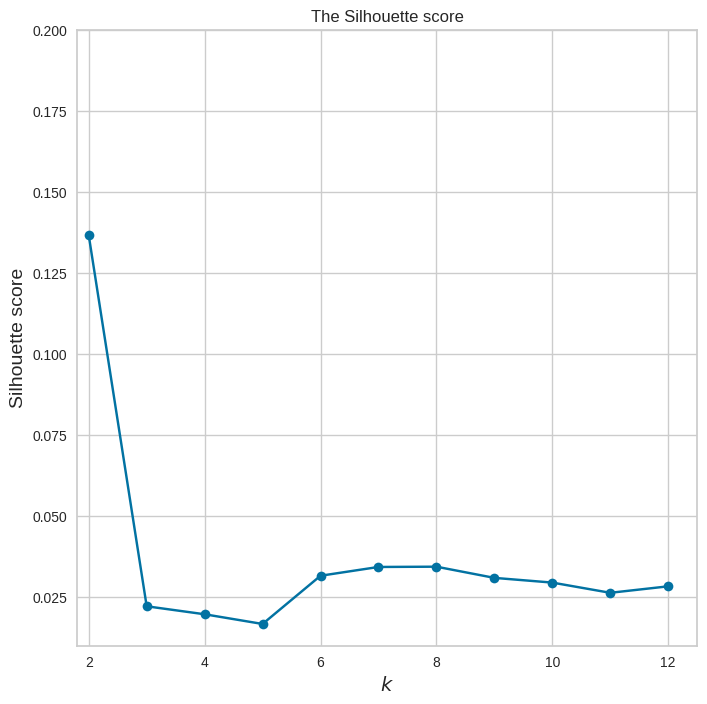

In [ ]:
# график silhouette_score для каждого количество кластеров
plt.figure(figsize=(8,8))
plt.plot(range(2, 13), silhouette_scores_2, "bo-")
plt.xlabel("$k$", fontsize=14)
plt.ylabel("Silhouette score", fontsize=14)
plt.axis([1.8, 12.5, 0.01, 0.2])
plt.title('The Silhouette score')
plt.show()

In [ ]:
# инициализируем модель с каким-либо количеством кластеров методом k-means++
# чтобы получить исходные центроиды
model = KMeans(n_clusters=2, init="k-means++", random_state=12345).fit(features)

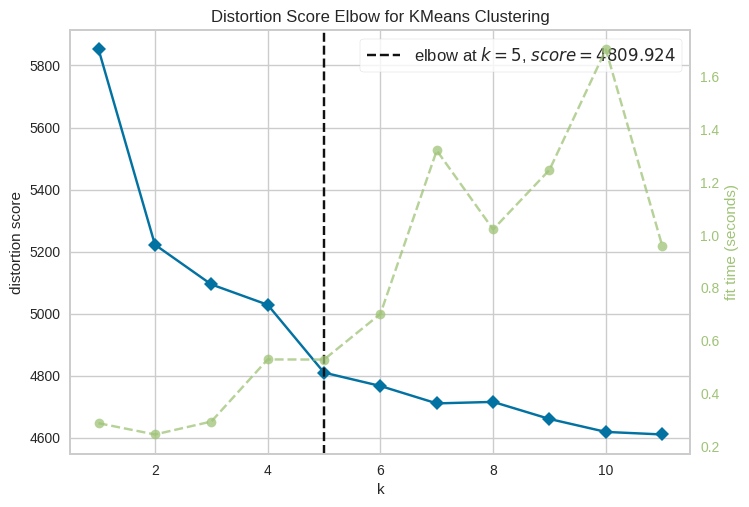

KElbowVisualizer(ax=<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>,
                 estimator=KMeans(n_clusters=11, random_state=12345),
                 k=(1, 12))

In [ ]:
# визуализировал оптимальное количеством кластеров методом локтя
kelbow_visualizer(model, features, k=(1,12))

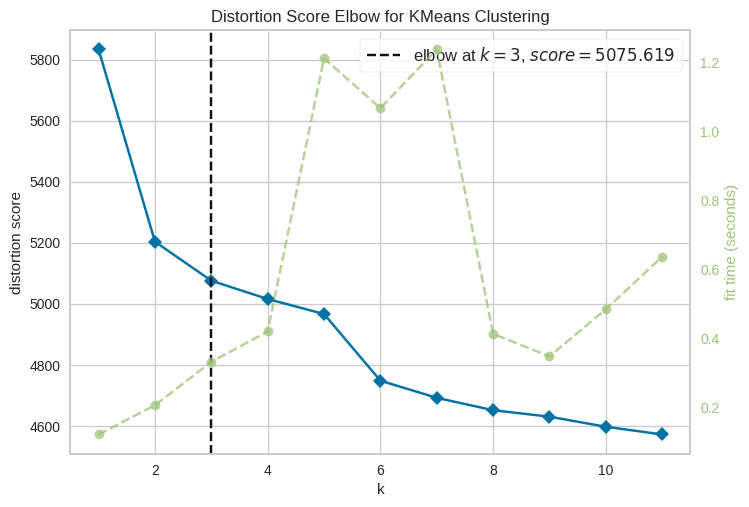

KElbowVisualizer(ax=<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>,
                 estimator=KMeans(n_clusters=11, random_state=12345),
                 k=(1, 12))

In [ ]:
# визуализировал оптимальное количеством кластеров методом локтя
kelbow_visualizer(model, techs_vec_pca, k=(1,12))

In [ ]:
# Обучил лучшую модель, с 4-я кластерами
best_model = KMeans(n_clusters=11, init="k-means++", random_state=12345).fit(features)

In [ ]:
# метки кластеров в список
labels = [str(x) for x in best_model.labels_]
# Добавил метки кластеров в датафрейм с названиями технологий
df['label'] = labels

In [ ]:
#сжал 768 до 2-х с помощью TSNE, чтобы изобразить точки кластеров в двухмерном пространстве
tsne = TSNE(n_components=2, random_state=12345)
techs_vec_tsne = tsne.fit_transform(techs_vec_pca)

In [ ]:
# список заголовков для графика
tt = list(df['tit_2'])
# список меток кластеров (для 4-х кластеров)
cl_2 = list(df.label)

## Bokeh

In [ ]:
!pip install bokeh
from bokeh.models import ColumnDataSource, LabelSet
from bokeh.plotting import figure, show, output_file
from bokeh.io import output_notebook
from bokeh.transform import factor_cmap, factor_mark

In [ ]:
import tqdm
from tqdm import tqdm

In [ ]:
# создам столбец который заполню названиями кластеров
df['cl'] = 'e'

In [ ]:
df.loc[df['label']=='0', 'cl'] = 'Короткие тексты'
df.loc[df['label']=='1', 'cl'] = 'Обзоры зарубеж книж инт Оборина'
df.loc[df['label']=='2', 'cl'] = 'Естественные науки'
df.loc[df['label']=='3', 'cl'] = 'Русская проза, лит премии'
df.loc[df['label']=='4', 'cl'] = 'ЖЗЛ, СССР и XIX в.'
df.loc[df['label']=='5', 'cl'] = 'Переводные книги, Азия'
df.loc[df['label']=='6', 'cl'] = 'Опасные темы'
df.loc[df['label']=='7', 'cl'] = 'Отчеч история, WWI, 1917'
df.loc[df['label']=='8', 'cl'] = 'ЖЗЛ, биогр., '
df.loc[df['label']=='9', 'cl'] = 'Ист соц, соц'
df.loc[df['label']=='10', 'cl'] = 'Фантастика, прикл,'

# список названий кластеров
cl = list(df.cl)

In [ ]:
# количество кластеров должно соответствовать количеству меток здесь 6

output_notebook()

SPECIES = sorted(df.label.unique())
MARKERS = ['plus', 'circle', 'triangle', 'square', 'star',
           'diamond', 'hex', 'triangle_pin', 'square_pin', 'asterisk',
           'inverted_triangle']

p = figure(tools="pan,wheel_zoom,reset,save",
           toolbar_location="above",
           title="Кластеры текстов Горького",
           background_fill_color="#fafafa",
           width=1500, height=1500)

p.xaxis.axis_label = 'TSNE_x'
p.yaxis.axis_label = 'TSNE_y'

source = ColumnDataSource(data=dict(x1=techs_vec_tsne[:,0],
                                    x2=techs_vec_tsne[:,1],
                                    names=tt,
                                    species=cl_2))

p.scatter(x="x1", y="x2", size=7, source=source,
          legend_group="species", fill_alpha=0.4,
          marker=factor_mark('species', MARKERS, SPECIES),
          color=factor_cmap('species', 'Category10_10', SPECIES))

labels = LabelSet(x="x1", y="x2", text="names", y_offset=6,
                  text_font_size="6pt", text_color="#555555",
                  source=source, text_align='center')
p.add_layout(labels)

p.legend.location = "top_left"
p.legend.title = "Clusters"

show(p)

In [ ]:
# количество кластеров должно соответствовать количеству меток здесь 6

output_notebook()

SPECIES = sorted(df.cl.unique())
MARKERS = ['plus', 'circle', 'triangle', 'square', 'star',
           'diamond', 'hex', 'triangle_pin', 'square_pin', 'asterisk',
           'inverted_triangle']

p = figure(tools="pan,wheel_zoom,reset,save",
           toolbar_location="above",
           title="Кластеры текстов Горького",
           background_fill_color="#fafafa",
           width=1500, height=1500)

p.xaxis.axis_label = 'TSNE_x'
p.yaxis.axis_label = 'TSNE_y'

source = ColumnDataSource(data=dict(x1=techs_vec_tsne[:,0],
                                    x2=techs_vec_tsne[:,1],
                                    names=tt,
                                    species=cl))

p.scatter(x="x1", y="x2", size=7, source=source,
          legend_group="species", fill_alpha=0.4,
          marker=factor_mark('species', MARKERS, SPECIES),
          color=factor_cmap('species', 'Category10_10', SPECIES))

labels = LabelSet(x="x1", y="x2", text="names", y_offset=6,
                  text_font_size="2pt", text_color="#555555",
                  source=source, text_align='center')
p.add_layout(labels)

p.legend.location = "top_left"
p.legend.title = "Clusters"

show(p)

- ось Y это кажется история: отрицательные значения - прошлое, положительные современка. (Поэтому нижняя часть оранжевого кластера с рецензиями про книги содержит Н. Проценко близкого историческому фиолетовому кластеру, но не в нем). <br>
-

In [ ]:
df.loc[(df['label']=='2') &
        (df['author']=='Надежда Проценко')] #&
       #(df['tit_2']=='Оборин Л. 2022-02-20')]['cl_text']]

,url,author,publ_date,title,subtitle,description,text,month_year,title_len,cl_text,text_len,rubric,year,lems,tit_1,tit_2,embb,label
3082,https://gorky.media/reviews/nuzhno-li-obyasnya...,Надежда Проценко,2021-04-28,"Нужно ли объяснять, если нужно объяснять",Надежда Проценко — о книге популяризатора физи...,"Мы переживаем время, когда наука опять «вышла ...",Игорь Иванов. Объясняя науку: Руководство для ...,2021-04,6,Игорь Иванов. Объясняя науку: Руководство для ...,979,reviews,2021,"['игорь', 'иванов', 'объяснять', 'наука', 'рук...","Нужно ли объяснять, если... 2021-04-28",Проценко Н. 2021-04-28,"[-0.04461669921875, -0.06292724609375, -0.0612...",2
3108,https://gorky.media/reviews/kogotok-uvyaz-vsej...,Надежда Проценко,2021-04-05,"«Коготок увяз, всей птичке пропасть»: зачем эв...",Надежда Проценко — о книге психофизиолога Серг...,"Все мы периодически испытываем стресс, а для н...","Сергей Парин. Стресс, боль и опиоиды. Об эндор...",2021-04,11,"Сергей Парин. Стресс, боль и опиоиды. Об эндор...",1175,reviews,2021,"['сергей', 'парин', 'стресс', 'боль', 'опиоид'...","«Коготок увяз, всей птичке... 2021-04-05",Проценко Н. 2021-04-05,"[-0.03076171875, 0.00243377685546875, -0.11883...",2
3143,https://gorky.media/reviews/kak-prorubit-okno-...,Надежда Проценко,2021-03-03,Как прорубить окно в комнату смерти,Надежда Проценко — о книге кардиолога Хайдера ...,"Сколько раз мы всерьез задумывались о смерти, ...",Хайдер Варрайч. Современная смерть. Как медици...,2021-03,6,Хайдер Варрайч. Современная смерть. Как медици...,1290,reviews,2021,"['хайдер', 'варрайч', 'современный', 'смерть',...",Как прорубить окно в... 2021-03-03,Проценко Н. 2021-03-03,"[0.016448974609375, -0.00931549072265625, 0.03...",2
3169,https://gorky.media/reviews/eto-ne-obman-chtob...,Надежда Проценко,2021-02-08,"Это не обман, чтобы набрать классы",Рецензия на книгу Пола Фассела «Класс. Путевод...,"Социальные классы в США существуют, утверждал ...",Пол Фассел. Класс. Путеводитель по статусной с...,2021-02,6,Пол Фассел. Класс. Путеводитель по статусной с...,1534,reviews,2021,"['фассесть', 'класс', 'путеводитель', 'статусн...","Это не обман, чтобы... 2021-02-08",Проценко Н. 2021-02-08,"[-0.020263671875, -0.023284912109375, 0.033721...",2
3248,https://gorky.media/reviews/s-bolnoj-golovy-na...,Надежда Проценко,2020-12-02,С больной головы на здоровую: как изучать мозг...,Надежда Проценко — о книге «Расстроенная психи...,"Это может звучать парадоксально, но больше все...",Эрик Кандель. Расстроенная психика. Что расска...,2020-12,11,Эрик Кандель. Расстроенная психика. Что расска...,1474,reviews,2020,"['эрик', 'кандель', 'расстроить', 'психика', '...",С больной головы на... 2020-12-02,Проценко Н. 2020-12-02,"[-0.0173187255859375, 0.035888671875, -0.01693...",2
3351,https://gorky.media/reviews/lyubov-vmesto-bess...,Надежда Проценко,2020-09-09,Любовь вместо бессмертия: как отсрочить старос...,Надежда Проценко — о книге «Против часовой стр...,В название книги московского журналиста Полины...,Полина Лосева. Против часовой стрелки. Что так...,2020-09,11,Полина Лосева. Против часовой стрелки. Что так...,1395,reviews,2020,"['полина', 'лосев', 'против', 'часовой', 'стре...",Любовь вместо бессмертия: как... 2020-09-09,Проценко Н. 2020-09-09,"[-0.09136962890625, -0.01016998291015625, 0.03...",2
3366,https://gorky.media/reviews/rasovyj-podhod-pro...,Надежда Проценко,2020-08-28,Расовый подход против рака простаты,Надежда Проценко — о книге ученого-генетика Дэ...,Американский генетик Дэвид Райх в своей дебютн...,Дэвид Райх. Кто мы и как сюда попали. Древняя ...,2020-08,5,Дэвид Райх. Кто мы и как сюда попали. Древняя ...,1508,reviews,2020,"['дэвид', 'райх', 'сюда', 'попасть', 'древний'...",Расовый подход против рака... 2020-08-28,Проценко Н. 2020-08-28,"[0.07177734375, 0.02935791015625, 0.0129165649...",2
3392,https://gorky.media/reviews/iskusstvo-byt-post...,Надежда Проценко,2020-08-03,Искусство быть посторонним,О книге Клиффорда Гирца «Постфактум. Две стран...,Книга известного американского ант

In [ ]:
[t for t in df.loc[(df['label']=='0')&
       (df['author']=='Анна Наринская')&
       (df['tit_2']=='Наринская А. 2016-12-21')]['cl_text']]

['Очевидно, что мы переживаем кризис языка любви: не только литературного, но и «человеческого». Правдивость высказывания Умберто Эко о современном читателе, с которым постмодернистская литература обращается как с «очень образованной женщиной» (ей нельзя сказать «люблю тебя безумно», потому что тот, кто хочет сказать это, понимает, что она понимает, что подобная фраза прежней литературой истощена и обессмыслена), становится особенно наглядной, если применить его непосредственно. То есть конкретно к словам «я люблю тебя безумно». К описанной Эко культурной ситуации давления прошлого, позволяющей сказать только «как говорится, я люблю тебя безумно» прибавились ситуация «цивилизационная»: чаты, эсэмэски, эмодзи и иже с ними — все это уводит от любовного высказывания к любовному жесту, то есть разъязычиванию чувства. И именно поэтому «люблю тебя безумно», написанное подробно и всерьез, причем нашими современными, ну или почти современными, словами, производит впечатление сенсационное. «Дор

In [ ]:
df.loc[(df['label']=='0')&
       (df['author']=='Стас Наранович')]['text_len'].mean()

743.9775280898876

- кл_0 (сколько бы не было кластеров он всегда 0 т.к. паддинг)
  - (ок. 10% Константин Мильчин: парагвай, Венесуэлла, Иран, Нидерланды, Мексика, "Заслужено забытые книги") тексты до 900 слов; средняя длинна текста 775 слов
  - Елена Макеенко средняя длинна текста 650
  - Анна Наринская 2016-17 гг. "Чтобы книга навсегда осталась в памяти" (Рим, франция) тексты до 900 слов; средняя длинна 718 слов
  - Incognito средняя длинна текста 602
  - Стас Наранович; средняя длинна текста 775 слов
<br><br>
- кл_1 (Лев Оборин 50%)
  - Лев Оборин Самое интересное в зарубежном книжном интеренете и поэтические новинки
  - Мария Нестеренко читательские биографии и интервью (2%, 9 текстов)

- кл_2 (обзоры естественнонаучной литературы)
  - Игорь Перников (11%) физиология, биология
  - Дмитрий Борисов (7%) астрономия, физика,
  - Надежда Проценко (5%) физиология,
<br><br>
-кл_3 (русская проза и литературные премии)
  - Эдуард Лукоянов (10%) Комиксы, кино, музыка
  - Константин Мильчин (6%) Пелевин, Прилепин
  - Артём Роганов (6%)
  - Дмитрий Самойлов Шорт-листы премии "Национальный бестселлер"
<br><br>
- кл_4 (нижний правый; читательские биографии интервью с издателями; о критиках 19 в.; о СССР)
  - Иван Мартов (10%)
  - Мария Нестеренко (5%)
<br><br>
- кл_5 (обзоры зарубежных переводных книг книг или книг об азии, истории)
  - Иван Напреенко (ок 10%) что спрашивать в книжных, лучшее по мнению горького на темы близким к историческим и азии (корея, Иран, )
  - Эдуард Лукоянов (8%)
  - Виталий Нуриев о французской литературе
  - Артём Роганов о перводных японских книгах
<br><br>
- кл_6 ( феминистская тема, убийства, смерть, война, тюрьма, Булгаков, суеверия)
  - Лев оборин (20%) Главное в литературном интернете поэзия
  - Эдуард Лукоянов (6%) Об отечественных писателях во время их годовщин рождения (обзор на фейковую книгу "Кто такая Убон Эппл и почему ее на самом деле нет")
  - Мария Нестеренко (5%) феминистская тема
<br><br>
- кл_7 (отчечественная история разных периодов, интелектуальная история, история революции 1917 г., о первой мировой войне)
  - книги из раздела "Что спрашивать в книжных" на тему истории
  - Дмитрий СТрахов (7%)
  - Алеша Рогожин (5%)
<br><br>
- кл_8 (ЖЗЛ, биографии, читательская биография, научная биография, интервью с историков, о персоналии)
  - Мария Нестеренко 5%
  - Иван Мартов 5%
<br><br>
- кл_9 (ист соц соц, сюда попали книги по Д. Борисова обзоры на естестве науки)
  - Н. Проценко (10%)
<br><br>
- кл_10 (переводная фантастика + остров Владимир Харитонов наверху + переводные романы)
  - Василий Владимирский (17%)
  - Лиза Биргер (5%)
  - Сергей Сдобнов (2%) аудиокниги






In [ ]:
df.loc[df['label']=='2']['author'].value_counts(normalize=True)[0:10]

,proportion
author,
Игорь Перников,0.114206
Дмитрий Борисов,0.072423
Incognito,0.069638
Надежда Проценко,0.058496
Эдуард Лукоянов,0.044568
Иван Напреенко,0.044568
Мария Елифeрова,0.041783
Валерий Шлыков,0.036212
Мария Нестеренко,0.036212


## Plotly + Aglomerative

In [ ]:
!pip install -U plotly
import plotly.express as px

In [ ]:
# threshold придется поподбирать


clustering = AgglomerativeClustering(n_clusters=None,
                                     distance_threshold=0.55, # threshold
                                     metric='cosine',
                                     linkage='average').fit(features) # обучаемя на techs_vec_pca - сж до 64 эмбб

In [ ]:
pca = PCA(n_components=2, random_state=42)
emb_2d = pd.DataFrame(pca.fit_transform(techs_vec_pca), columns=['x1', 'x2']) # обучаемя на techs_vec_pca - сж до 64 эмбб
emb_2d['label'] = clustering.labels_

In [ ]:
# чтобы понять сколько кластеров выделяются смотри

emb_2d['label_5'] = clustering.labels_
emb_2d['label_5'].nunique()

In [ ]:
fig = px.scatter(emb_2d, x='x1', y='x2', color='label_4', width=1200, height=1000) # 'label_4' в цвета кластера
fig.show()

### 3d scatter

- при пороге 0,98 - кластер 1
- при пороге 0,80 - 1
- при пороге 0,7 - 1 - label_2
- ghb пороге 0,6 - 4 - label_3 (но это не то, что нужно)
- при пороге 0,5 - 58

In [ ]:
pca = PCA(n_components=3, random_state=42)
emb_3d = pd.DataFrame(pca.fit_transform(features), columns=['x1', 'x2', 'x3']) # обучаемя на techs_vec_pca - сж до 64 эмбб
emb_3d['label'] = clustering.labels_

In [ ]:
emb_3d['label'].nunique()

58

In [ ]:
#
emb_3d['label_4'] = clustering.labels_
emb_3d['label_4'].nunique()

12

In [ ]:
fig = px.scatter_3d(emb_3d, x='x1', y='x2', z='x3', color='label', width=1200, height=1000) # 'label_4' в цвета кластера
fig.show()

In [ ]:
plotly.express.scatter_3d(data_frame=None, #
                          x=None, #
                          y=None, #
                          z=None, #
                          color=None, #
                          symbol=None,
                          size=None,
                          text=None,
                          hover_name=None,
                          hover_data=None,
                          custom_data=None,
                          error_x=None,
                          error_x_minus=None,
                          error_y=None,
                          error_y_minus=None,
                          error_z=None,
                          error_z_minus=None,
                          animation_frame=None,
                          animation_group=None,
                          category_orders=None,
                          labels=None,
                          size_max=None,
                          color_discrete_sequence=None,
                          color_discrete_map=None,
                          color_continuous_scale=None,
                          range_color=None,
                          color_continuous_midpoint=None,
                          symbol_sequence=None,
                          symbol_map=None,
                          opacity=None,
                          log_x=False,
                          log_y=False,
                          log_z=False,
                          range_x=None,
                          range_y=None,
                          range_z=None,
                          title=None, #
                          template=None, #
                          width=None, #
                          height=None) #

### Сожмем эмбеддинги

In [ ]:
pca = PCA(n_components=512, random_state=42)
techs_vec_pca = pca.fit_transform(arr)

In [ ]:
clustering = AgglomerativeClustering(n_clusters=None,
                                     distance_threshold=0.92, # threshold
                                     metric='cosine',
                                     linkage='average').fit(techs_vec_pca) # обучаемя на techs_vec_pca - сж до 512 эмбб YaGPT

- порог 0.8 - 203 кластера - label_5
- порог 0.9 - 14 кластеров - label_6
- порог 0.915 - 9 кластеров - label_9
- порог 0.925 - 7 кластеров - label_8
- порог 0.95 - 5 кластеров - label_6 (плохой результат)

In [ ]:
emb_3d['label_11'] = clustering.labels_
emb_3d['label_11'].nunique()

9

In [ ]:
fig = px.scatter_3d(emb_3d, x='x1', y='x2', z='x3', color='label_11', width=1200, height=1000) # 'label_4' в цвета кластера
fig.show()

- кластер (жетный, 8) ЖЗЛ, СССР и XIX в. 95%
- кл (фиолетовый, 1) по 30% ЖЗЛ, биогр., бзоры зарубеж книж инт Оборина, Ист соц, соц
- кл (2) по 20% Переводные книги, Азия; Фантастика, прикл,; Естественные науки; 10% Опасные темы
- кл (3 розовый) по 30% Русская проза, лит премии; Опасные темы; 20 % Отчеч история, WWI, 1917; 10% Переводные книги, Азия
- кл (0) короткие тексты
- кл (6) три текста о демонизме
- кл (7) 6 текстов о Лотмане, алфавите, письме
- кл (4) 6 текстов о Мишель Уэльбек и Джонатан Коу (реклама их книг)

In [ ]:
df[(df['agl']==4)]

,url,author,publ_date,title,subtitle,description,text,month_year,title_len,cl_text,text_len,rubric,year,lems,tit_1,tit_2,embb,label,cl,agl
1114,https://gorky.media/context/samyj-merzkij-pisa...,Василий Владимирский,2019-10-28,Самый мерзкий писатель,"Спорная книга: Мишель Уэльбек, «Серотонин»",Василий Владимирский следит за рецензиями на в...,"Мишель Уэльбек. Серотонин. М.: АСТ, Corpus, 20...",2019-10,3,"Мишель Уэльбек. Серотонин. М.: АСТ, Corpus, 20...",1955,context,2019,"['мишель', 'уэльбек', 'серотонин', 'аста', 'пе...",Самый мерзкий писатель 2019-10-28,Владимирский В. 2019-10-28,"[0.034027099609375, 0.0362548828125, -0.108703...",1,Обзоры зарубеж книж инт Оборина,4
1335,https://gorky.media/context/na-puti-k-brekzitu/,Василий Владимирский,2019-04-01,На пути к брекзиту,Спорная книга: Джонатан Коу «Срединная Англия»,Постоянный автор «Горького» Василий Владимирск...,Джонатан Коу. Срединная Англия. М.: Фантом Пре...,2019-04,4,Джонатан Коу. Срединная Англия. М.: Фантом Пре...,1061,context,2019,"['джонатан', 'срединный', 'англия', 'фантом', ...",На пути к брекзиту... 2019-04-01,Владимирский В. 2019-04-01,"[0.02789306640625, 0.005886077880859375, 0.053...",10,"Фантастика, прикл,",4
2433,https://gorky.media/reviews/interesnaya-kniga/,Эдуард Лукоянов,2023-07-11,Интересная книга*,Эдуард Лукоянов — об «Уничтожить» Мишеля Уэльбека,Вышедший в 2022 году роман Мишеля Уэльбека «Ун...,"\nМишель Уэльбек. Уничтожить. М.: Corpus, 202...",2023-07,2,"Мишель Уэльбек. Уничтожить. М.: Corpus, 2023...",1135,reviews,2023,"['мишель', 'уэльбек', 'уничтожить', 'перевод',...",Интересная книга* 2023-07-11,Лукоянов Э. 2023-07-11,"[0.004390716552734375, -0.03680419921875, -0.0...",5,"Переводные книги, Азия",4
3598,https://gorky.media/reviews/chichikov-na-antid...,Эдуард Лукоянов,2019-10-24,Чичиков на антидепрессантах: «Серотонин» Мишел...,Почему новый роман французского мизантропа осо...,Издательство Corpus перевело и выпустило роман...,"Мишель Уэльбек. Серотонин. М.: Corpus, 2019. П...",2019-10,6,"Мишель Уэльбек. Серотонин. М.: Corpus, 2019. П...",1517,reviews,2019,"['мишель', 'уэльбек', 'серотонин', 'перевод', ...",Чичиков на антидепрессантах: «Серотонин»... 20...,Лукоянов Э. 2019-10-24,"[-0.027252197265625, 0.0251312255859375, -0.08...",5,"Переводные книги, Азия",4
3692,https://gorky.media/reviews/pisal-pro-brekzit-...,Incognito,2019-06-29,Писал про Брекзит — написал про нас,Блогеры читают иностранный список премии «Ясна...,Книжные блогеры из телеграма решили объединить...,Джонатан Коу. Срединная Англия. М.: Фантом Пре...,2019-06,7,Джонатан Коу. Срединная Англия. М.: Фантом Пре...,1909,reviews,2019,"['джонатан', 'срединный', 'англия', 'фантом', ...",Писал про Брекзит —... 2019-06-29,Incognito 2019-06-29,"[0.05389404296875, -0.029144287109375, 0.04315...",1,Обзоры зарубеж книж инт Оборина,4
3838,https://gorky.media/reviews/uelbek-na-dne/,Зинаида Пронченко,2019-01-09,Уэльбек на дне,Рецензия на новый роман Мишеля Уэльбека «Серот...,Предсказание бунта «желтых жилетов» и приговор...,Michel Houellebecq. Sérotonine. Paris: Flammar...,2019-01,3,Michel Houellebecq. Sérotonine. Paris: Flammar...,1111,reviews,2019,"['сюжет', 'седьмой', 'роман', 'мишель', 'уэльб...",Уэльбек на дне 2019-01-09,Пронченко З. 2019-01-09,"[-0.04498291015625, 0.0211639404296875, -0.067...",10,"Фантастика, прикл,",4


In [ ]:
df['agl'] = clustering.labels_

In [ ]:
df[df['agl']==6]['author'].value_counts(normalize=True)[0:10]

,proportion
author,
Владимир Максаков,0.333333
Антон Прокопчук,0.333333
Иван Напреенко,0.333333


## Работаем с большим df gorky_top_natasha
#### почуму-то в gorky_top_natasha слишком мало строк


In [ ]:
df = pd.read_csv(r"gorky_join_lemms_df.csv")

In [ ]:
df = df.drop(['Unnamed: 0'], axis=1)

In [ ]:
from tqdm import notebook

In [ ]:
# почистим cl_text от лишних знаков
notebook.tqdm.pandas()

df['cl_text'] = df['cl_text'].progress_apply(lambda x: clear_text(x))


  0%|          | 0/1554 [00:00<?, ?it/s]

In [ ]:
len(df)

1554

In [ ]:
df['publ_date'] = pd.to_datetime(df['publ_date'], format='%Y-%m-%d')

In [ ]:
# сделаем столбец Автор + Дата для названия
# сделаем столбец первые 4 слова заголовка + дата
notebook.tqdm.pandas()

df = df.progress_apply(tit_maker, axis=1)

  0%|          | 0/1554 [00:00<?, ?it/s]

In [ ]:
df.sample(5)

,url,author,publ_date,title,subtitle,description,text,month_year,title_len,cl_text,...,rubric,year,text_NOUN,text_ent_PER,text_ent_LOC,text_ent_ORG,text_ADJ,key_words,tit_1,tit_2
1382,https://gorky.media/reviews/muchenik-ot-iskuss...,Эдуард Лукоянов,2019-07-09,Мученик от искусства,О «Современной природе» Дерека Джармена,На русском языке вышла книга Дерека Джармена «...,Дерек Джармен. Современная природа. М.: Ад Мар...,2019-07,3,Дерек Джармен. Современная природа. М. Ад Марг...,...,reviews,2019,"['чума', 'гражданин', 'приступ', 'коллега', 'с...","['Тэтчер', 'Ярузельский', 'Томас Мор', 'Дева М...","['Джармен', 'Соединенное Королевство', 'Англия...","['The Guardian', 'Музей современного искусства...","['унылый', 'статистический', 'консервативный',...","['природа', 'художник', 'современный природа',...",Мученик от искусства 2019-07-09,Лукоянов Э. 2019-07-09
1173,https://gorky.media/reviews/iz-ognya-da-v-poly...,Игорь Перников,2020-12-14,Из огня да в полымя: полезный гид по преисподней,Игорь Перников — о книге «Ад. История идеи и е...,Мало в чем человечество оказывается столь же и...,Скотт Брюс. Ад. История идеи и ее земные вопло...,2020-12,9,Скотт Брюс. Ад. История идеи и ее земные вопло...,...,reviews,2020,"['указание', 'начало', 'инструкция', 'воплощен...","['Скотт Брюс', 'Эвридикой', 'Харон', 'Геенна',...","['Тундала', 'Регенсбург', 'Хинном', 'Греция', ...","['Иезуитов', 'Фордхемский университет', 'Катол...","['поздний', 'жестокий', 'старший', 'значительн...","['ад', 'идея', 'идея ад', 'посмертный существо...",Из огня да в... 2020-12-14,Перников И. 2020-12-14
896,https://gorky.media/reviews/obektno-orientirov...,Эдуард Лукоянов,2022-12-20,Объектно ориентированная эсхатология,Перечитываем «Лед» Анны Каван,«Ад Маргинем» переиздало роман Анны Каван «Лед...,"\nАнна Каван. Лед. М.: Ад Маргинем Пресс, 202...",2022-12,3,Анна Каван. Лед. М. Ад Маргинем Пресс . Перево...,...,reviews,2022,"['картина', 'клоун', 'творчество', 'уверенност...","['Анна Каван', 'Моник Виттиг', 'Хелен Эмили Ву...",['Каван'],"['Страшный суд', 'Current 93']","['великий', 'буквальный', 'неожиданный', 'драг...","['книга', 'лед', 'ее проза', 'следующий образ'...",Объектно ориентированная эсхатология 2022-12-20,Лукоянов Э. 2022-12-20
176,https://gorky.media/context/koltso-vsevlastya-...,Лев Оборин,2021-04-11,Кольцо Всевластья из туалетной бумаги,Лучшее в литературном интернете: 11 ссылок недели,Жители Петербурга вновь спасают граффити на до...,1. Несколько русских публикаций к 200-летию Ша...,2021-04,5,. Несколько русских публикаций к летию Шарля Б...,...,context,2021,"['стать', 'отчет', 'сторонюсь', 'переводчик', ...","['Ольга Балла-Гертман', 'Оливия Рутильяно', 'Д...","['Великобритания', 'Петербург', 'Россия', 'Дик...","['Рана', 'Совпадение', 'Прочтение', 'Change.or...","['бодлеровский', 'душевный', 'жестокий', 'несп...","['книга', 'роман', 'творческий личность', 'час...",Кольцо Всевластья из туалетной... 2021-04-11,Оборин Л. 2021-04-11
676,https://gorky.media/context/vozvrashhenie-pite...,Лев Оборин,2017-08-06,Возвращение Питера Пэна и женщины-убийцы,Лучшее в литературном интернете: 12 самых инте...,Каждую неделю поэт и критик Лев Оборин пристра...,1. Снова здравствуйте и приступим. Литераторы ...,2017-08,5,. Снова здравствуйте и приступим. Литераторы и...,...,context,2017,"['стать', 'картина', 'четверг', 'потепление', ...","['Мэри Шелли', 'Валерий Нугатов', 'Конан Дойла...","['Приангарья', 'Кентукки', 'Юго-Запад', 'Техас...","['Новый мир', 'The Daily Storm', 'Phaidon', 'С...","['великий', 'рутинный', 'свободный', 'немецкий...","['стих', 'роман', 'советский текст', 'убийца ж...",Возвращение Питера Пэна и... 2017-08-06,Оборин Л. 2017-08-06


In [ ]:
# получим эмбеддинги cl_text

notebook.tqdm.pandas()

df['embb'] = notebook.tqdm(df['cl_text'].progress_apply(lambda x: embb(x)))

#from google.colab import files
#df.to_csv('gorky_embeddings.csv')
#files.download('gorky_embeddings.csv')

  0%|          | 0/1554 [00:00<?, ?it/s]

  0%|          | 0/1554 [00:00<?, ?it/s]

In [ ]:
from google.colab import files
files.download('gorky_embeddings.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
arr = pd.DataFrame(df['embb'].tolist()).values
# Сделаем из списка списков датафрейм и заполним пропуски (темы, которых в документе нет) 0
# и затем df в массив .values (можно также через df.as_matrix())

In [ ]:
# заполнили nan  в массиве 0 вместа паддинга
arr[np.isnan(arr)] = 0
print(arr.shape)

In [ ]:
print(arr.shape)

(1554, 196096)


In [ ]:
features = arr

In [ ]:
gorky_top_embeddings_64 = pd.DataFrame(techs_vec_pca)

In [ ]:
gorky_top_embeddings_64[['url', 'author', 'publ_date', 'title', 'subtitle', 'description', 'tit_1', 'tit_2']] = df[['url', 'author', 'publ_date', 'title', 'subtitle', 'description', 'tit_1', 'tit_2']]

In [ ]:
from google.colab import files
gorky_top_embeddings_64.to_csv('gorky_top_embeddings_64.csv')


In [ ]:
files.download('gorky_top_embeddings_64.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## Кластеры

In [ ]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.cluster import AgglomerativeClustering
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA

In [ ]:
#сжал 768 до 2-х с помощью TSNE, чтобы изобразить точки кластеров в двухмерном пространстве
tsne = TSNE(n_components=2, random_state=12345)
techs_vec_tsne = tsne.fit_transform(features)

In [ ]:
pca = PCA(n_components=64, random_state=42)
techs_vec_pca = pca.fit_transform(arr)

In [ ]:
features = techs_vec_tsne

In [ ]:
features_pca = techs_vec_pca

In [ ]:
# Обучил лучшую модель, с 4-я кластерами
best_model = KMeans(n_clusters=6, init="k-means++", random_state=12345).fit(techs_vec_tsne)

In [ ]:
# Обучим модели для каждого количества кластеров от 2-х до 12-и
kmeans_per_k = [KMeans(n_clusters=k, random_state=12345).fit(features)
                for k in range(1, 13)]

# посчитал silhouette_scores для каждого количества кластеров от 2-х до 9-и
silhouette_scores = [silhouette_score(features, model.labels_)
                     for model in kmeans_per_k[1:]]

In [ ]:
# то же самое но с 64 измерение pca

# Обучим модели для каждого количества кластеров от 2-х до 12-и
kmeans_per_k = [KMeans(n_clusters=k, random_state=12345).fit(features_pca)
                for k in range(1, 13)]

# посчитал silhouette_scores для каждого количества кластеров от 2-х до 9-и
silhouette_scores = [silhouette_score(features_pca, model.labels_)
                     for model in kmeans_per_k[1:]]

In [ ]:
silhouette_scores

[0.4923566220722905,
 0.11288843493198708,
 0.11246028095862047,
 0.08248657927480248,
 0.08033263059569834,
 0.09770473704599703,
 0.08314075096785056,
 0.04709851901537081,
 0.055871984981368555,
 0.05461240761610055,
 0.05188953413362037]

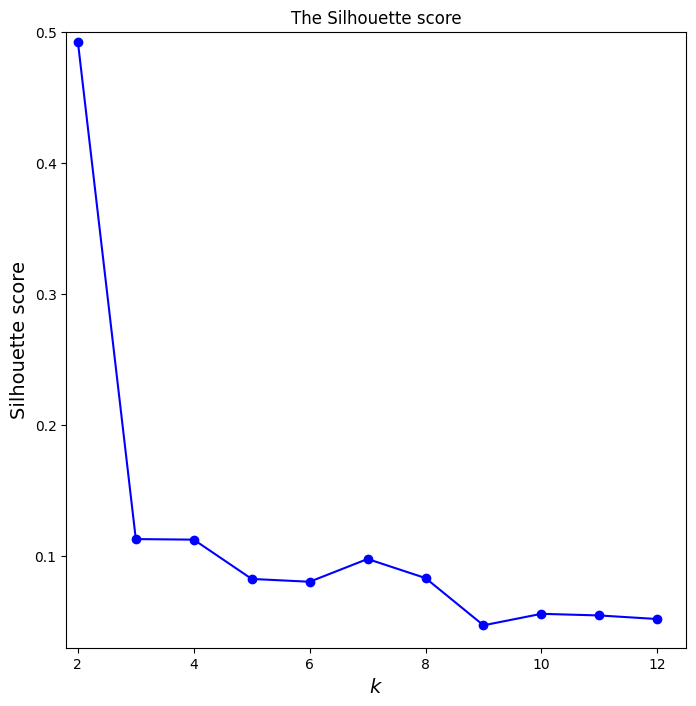

In [ ]:
# график silhouette_score для каждого количество кластеров
plt.figure(figsize=(8,8))
plt.plot(range(2, 13), silhouette_scores, "bo-")
plt.xlabel("$k$", fontsize=14)
plt.ylabel("Silhouette score", fontsize=14)
plt.axis([1.8, 12.5, 0.03, 0.5])
plt.title('The Silhouette score')
plt.show()

In [ ]:
# Обучил лучшую модель, с 4-я кластерами
best_model = KMeans(n_clusters=6, init="k-means++", random_state=12345).fit(features)

In [ ]:
# метки кластеров в список
labels = [str(x) for x in best_model.labels_]
# Добавил метки кластеров в датафрейм с названиями технологий
df['label'] = labels

In [ ]:
#сжал 768 до 2-х с помощью TSNE, чтобы изобразить точки кластеров в двухмерном пространстве
tsne = TSNE(n_components=2, random_state=12345)
techs_vec_tsne = tsne.fit_transform(features)

In [ ]:
# список заголовков для графика
tt = list(df['tit_2'])
# список меток кластеров (для 4-х кластеров)
cl_2 = list(df.label)

In [ ]:
!pip install bokeh
from bokeh.models import ColumnDataSource, LabelSet
from bokeh.plotting import figure, show, output_file
from bokeh.io import output_notebook
from bokeh.transform import factor_cmap, factor_mark

In [ ]:
output_notebook()

SPECIES = sorted(df.label.unique())
MARKERS = ['plus', 'circle', 'triangle', 'square', 'star', 'diamond']

p = figure(tools="pan,wheel_zoom,reset,save",
           toolbar_location="above",
           title="Кластеры текстов топовх авторов Горького",
           background_fill_color="#fafafa",
           width=1500, height=1500)

p.xaxis.axis_label = 'TSNE_x'
p.yaxis.axis_label = 'TSNE_y'

source = ColumnDataSource(data=dict(x1=techs_vec_tsne[:,0],
                                    x2=techs_vec_tsne[:,1],
                                    names=tt,
                                    species=cl_2))

p.scatter(x="x1", y="x2", size=8, source=source,
          legend_group="species", fill_alpha=0.4,
          marker=factor_mark('species', MARKERS, SPECIES),
          color=factor_cmap('species', 'Category10_6', SPECIES))

labels = LabelSet(x="x1", y="x2", text="names", y_offset=6,
                  text_font_size="3pt", text_color="#555555",
                  source=source, text_align='center')
p.add_layout(labels)

p.legend.location = "top_left"
p.legend.title = "Clusters"

show(p)

In [ ]:
df[df['label']== '0'].sample(10)

,url,author,publ_date,title,subtitle,description,text,month_year,title_len,cl_text,...,text_NOUN,text_ent_PER,text_ent_LOC,text_ent_ORG,text_ADJ,key_words,tit_1,tit_2,embb,label
865,https://gorky.media/reviews/mat-atomnyh-slez/,Эдуард Лукоянов,2023-05-17,Мать атомных слез,О книге «Fallout. Хроники создания легендарной...,Игровая вселенная Fallout существует уже четве...,\nЭрван Лафлериэль. Fallout. Хроники создания...,2023-05,3,Эрван Лафлериэль. . Хроники создания легендарн...,...,"['ультимативный', 'баланс', 'обесценивание', '...","['Волт-Бой', 'Пустоши', 'Терри Гиллиам', 'Эрва...","['Советский Союз', 'США', 'Америка', 'Пустошь'...","['Новости', 'Interplay', 'Oblivion', 'The Ink ...","['великий', 'вступительный', 'недавний', 'взаи...","['игра', 'год', 'создание легендарный', 'леген...",Мать атомных слез 2023-05-17,Лукоянов Э. 2023-05-17,"[-0.05499523505568504, 0.008065409027040005, -...",0
354,https://gorky.media/context/institut-telekinez...,Лев Оборин,2019-09-08,Институт телекинеза имени Стивена Кинга,Лучшее в литературном интернете: 11 самых инте...,Похвала Изумрудному городу и откровения Стивен...,"1. 31 августа в возрасте 88 лет умер социолог,...",2019-09,5,. августа в возрасте лет умер социолог историк...,...,"['оканчиваться', 'отчет', 'покойный', 'приятел...","['Ольга Тимофеева', 'Брюллов', 'Василий Бороди...","['Жуковский', 'Америка', 'Канзас', 'Петербург'...","['The Guardian', 'Взгляд', 'Новое издательство...","['великий', 'неожиданный', 'сибирский', '1962'...","['книга', 'роман', 'мир-системный анализ', 'то...",Институт телекинеза имени Стивена... 2019-09-08,Оборин Л. 2019-09-08,"[-0.009325025603175163, -0.10678242892026901, ...",0
965,https://gorky.media/reviews/daj-mne-svoi-glaza/,Иван Напреенко,2022-04-22,Дай мне свои глаза,Иван Напреенко — о книге «Империя наций»,«Империя наций» Франсин Хирш вышла в 2005 году...,\nФрансин Хирш. Империя наций. Этнографическо...,2022-04,4,Франсин Хирш. Империя наций. Этнографическое з...,...,"['коллега', 'установка', 'кампания', 'японец',...","['Рюрик', 'Владимир Старовский', 'Роберт Ибату...","['Советский Союз', 'Советское государство', 'С...","['Бюро переписи', 'КИПС', 'Академия наук и этн...","['великий', '1926', 'правильный', 'сибирский',...","['этнограф', 'нация', 'любой цена', 'националь...",Дай мне свои глаза... 2022-04-22,Напреенко И. 2022-04-22,"[-0.0012801343109458685, 0.09299025684595108, ...",0
181,https://gorky.media/context/nina-ne-terpela-li...,Константин Мильчин,2021-03-25,"«Нина не терпела лизанья, и я сдерживалась»","Пять аудиокниг, которые стоит послушать",«Горький» и сервис Storytel продолжают совмест...,Константин Циолковский. Философия Вселенной. Э...,2021-03,7,Константин Циолковский. Философия Вселенной. Э...,...,"['гостиница', 'коллега', 'документ', 'по-добро...","['Эли Винтен', 'Вим Дегравэ', 'Ирочку', 'Лидия...","['Российская Федерация', 'Темза', 'Петербург',...","['Институте царящие интриги', 'Институт благор...","['великий', 'старший', 'узкий', 'молодой', 'го...","['человек', 'книга', 'записка институтка', 'кн...","«Нина не терпела лизанья,... 2021-03-25",Мильчин К. 2021-03-25,"[-0.02801164798438549, 0.06017906963825226, 0....",0
6,https://gorky.media/context/korabl-na-polnom-h...,Эдуард Лукоянов,2023-10-20,"Корабль, на полном ходу перестраиваемый в завод",Павел Арсеньев — о Сергее Третьякове и литерат...,В «Новом литературном обозрении» вышла моногра...,\nПавел Арсеньев. Литература факта и проект л...,2023-10,7,Павел Арсеньев. Литература факта и проект лите...,...,"['перелет', 'переводчик', 'каталогизация', 'об...","['Сергей Третьяков', 'Вальтер Беньямин', 'Герт...","['Советский Союз', 'Коммаяк', 'М', 'Запад', 'Ш...","['Исправительная колония', 'Современник', 'ЛЕФ...","['поздний', 'транспонировать', 'xix', 'последо...","['факт', 'литература', 'литература факт', 'нов...","Корабль, на полном ходу... 2023-10-20",Лукоянов Э. 2023-10-20,"[-0.08266355842351913, 0.07651376724243164, 0....",0
184,https://gorky.media/context/ischezayushhie-bab...,Лев Оборин,202

In [ ]:
clustering = AgglomerativeClustering(n_clusters=None,
                                     distance_threshold=0.98,
                                     metric='cosine',
                                     linkage='average').fit(techs_vec_pca)

In [ ]:
pca = PCA(n_components=2, random_state=42)

emb_2d = pd.DataFrame(pca.fit_transform(techs_vec_pca), columns=['x1', 'x2'])
emb_2d['label'] = clustering.labels_

- для порого в 0.9 выделяет 39 тем
- для порога в 0.95 выделяет 21 тему (label_4)
- для порога в 1 всего 3 темы (label_3)
-  

In [ ]:
emb_2d['label_5'] = clustering.labels_
emb_2d['label_5'].nunique()

5

In [ ]:
gorky_top_embeddings_64['label_4'] = emb_2d['label_4']

In [ ]:
fig = px.scatter(emb_2d, x='x1', y='x2', color='label_4', width=1200, height=1000)
fig.show()

In [ ]:
gorky_top_embeddings_64[(gorky_top_embeddings_64['label_3']==1)&
 (gorky_top_embeddings_64['author']=='Иван Напреенко')^
  (gorky_top_embeddings_64['subtitle'].str.contains(r"\bЧто спрашивать", case=False, na=False))^
   (gorky_top_embeddings_64['subtitle'].str.contains(r"\bСамые", case=False, na=False))][['subtitle', 'author']].sample(20)

,subtitle,author
981,Иван Напреенко — о книге Джеймса Лавлока «Нова...,Иван Напреенко
1210,Что спрашивать в книжных,Иван Напреенко
1417,"Шесть книжных новинок, на которые стоит обрати...",Иван Напреенко
1233,"Новинки, на которые стоит обратить внимание",Иван Напреенко
1077,Что спрашивать в книжных,Эдуард Лукоянов
949,Что почитать о звуке и музыке,Иван Напреенко
957,Иван Напреенко — о книге «Minima Moralia. Разм...,Иван Напреенко
1284,Пять заметных книг недели по мнению «Горького»,Иван Напреенко
1421,"Шесть книжных новинок, заслуживающих особого в...",Иван Напреенко
1290,Поток книжных новинок все еще слаб — перелисты...,Иван Напреенко


In [ ]:
[i for i in gorky_top_embeddings_64[(gorky_top_embeddings_64['label_5']==3)&
 (gorky_top_embeddings_64['author']=='Дмитрий Борисов')]['description']]

['Книга «Праведный палач. Жизнь, смерть, честь и позор в XVI веке» основана на дневнике Франца Шмидта, жителя Нюрнберга, которого должность обязывала казнить и калечить людей. Дмитрий Борисов изучил эту книгу для совместного проекта «Горького» и «Просветителя» и выбрал нетривиальный способ разговора о ней, сравнив Шмидта с другим известным персонажем Средневековья — кровавым маршалом Жилем де Рэ. Эта фигура представляется полной противоположностью «праведному палачу» — тем интереснее обнаружить структурные параллели в биографиях двух этих героев, у каждого из которых руки по локоть в крови — пусть и совершенно по разным причинам.']

In [ ]:
gorky_top_embeddings_64[(gorky_top_embeddings_64['label_4']==5)][['subtitle', 'author']]

,subtitle,author
2,Борис Куприянов — к 110‑летию Виктора Драгунского,Борис Куприянов
7,Самое интересное в зарубежном книжном интернете,Лев Оборин
9,Самое интересное в зарубежном книжном интернете,Лев Оборин
12,«Ротонда» Ильи Сургучева и ее забытый автор,Эдуард Лукоянов
13,Самое интересное в зарубежном книжном интернете,Лев Оборин
...,...,...
1454,Пять новых книг о рок-музыке,Эдуард Лукоянов
1457,Пять поэтических книг ноября,Лев Оборин
1531,Сборник стихов Марии Степановой «Против лирики»,Лев Оборин
1547,«Патриот» Алексея Колышевского как учебник по ...,Константин Мильчин


- кластер 2 238 обзоров литературных новинок и зарубежный литературный интернет (в 80% случаев за авторством Льва Оборина; по 3 % у Э. Лукоянова, И. Мартова, М. Нестеренко у остальных ок. 1%)<br><br>
- кластер 1 893 обзорf на отдельные книги (20% Э. Лукоянов и ок 10% у И. Напреенко, К. Мильчина и В. Владимирского). У Н. Проенко здесь книги по исторической социологии и политэкономии. У И. Напреенко - что спрашивать в книжных и самые интересные Новинки по мнению редакции. У Э. Лукоянова о художественной литературе, антропологии.
<br><br>
- кластер 0 это 333 интервью, читательские или научные биографии, об издательствах и рецензии (ок 25% И. Мартов и М. Нестеренко, 10% Б. Куприянов; ок. 5% у И. Напреенко, Э. Лукоянова, С. Нарановича, К. Митрошенкова, Д. Борисова)
<br><br>
- если взять 5 кластеров, то в отдельный выделяются 6 текстов И. Мартова и Д. Борисова, И. Напреенко Б. Куприянова о революции 1917 г. и связанных с ней. И Какой-то странный кластер из 3 текстов Д. Борисов и И. Мартова.
<br><br>
- если больше кластеров (21 в 'label_4') то появляются немногочисленные тематические кластеры по филосовии и социологии (12)

In [ ]:
gorky_top_embeddings_64[gorky_top_embeddings_64['label_3']==2]['author'].value_counts(normalize=True)

,proportion
author,
Лев Оборин,0.795732
Эдуард Лукоянов,0.039634
Иван Мартов,0.030488
Мария Нестеренко,0.030488
Константин Митрошенков,0.018293
Игорь Перников,0.015244
Борис Куприянов,0.015244
Иван Напреенко,0.015244
Константин Мильчин,0.012195


In [ ]:
len(gorky_top_embeddings_64[gorky_top_embeddings_64['label_3']==2])

328

In [ ]:
# отключение предупреждений
import warnings
warnings.filterwarnings("ignore")

### SentenceTransformer

In [ ]:
import random
import requests
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd
import time as t
import re # Регулярные выражения
# для рандомизации времени засыпания
from random import randint
from tqdm import tqdm_notebook
from tqdm import notebook
# отключение предупреждений
import warnings
warnings.filterwarnings("ignore")

In [ ]:
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.decomposition import PCA

In [ ]:
pip install -U plotly
import plotly.express as px

In [ ]:
import plotly.express as px

In [ ]:
!pip install bokeh
from bokeh.models import ColumnDataSource, LabelSet
from bokeh.plotting import figure, show, output_file
from bokeh.io import output_notebook
from bokeh.transform import factor_cmap, factor_mark

In [ ]:
pip install -U sentence-transformers

In [ ]:
from sentence_transformers import SentenceTransformer

In [ ]:
sentences = ["Это тестовый документ1", "Песня это совсем другой"]

In [ ]:
model = SentenceTransformer('sentence-transformers/distiluse-base-multilingual-cased-v1')
#embeddings = model.encode(sentences)
#print(embeddings)

In [ ]:
def clear_text(t):
    #t = str(t).lower()llear
    t = t.replace('\n', ' ')
    #t = t.replace('.', '. ')
    #t = t.replace(',', ', ')
    t = t.replace('***', ' ')
    t = re.sub(r'[^а-яА-ЯёЁ.?!]', ' ', t).split()
    cl_text = " ".join(t)

    return cl_text

In [ ]:
# функция для добавленеи столбцов с загловками
def tit_maker(row, li = None, li_t = None, key_words_list = None):

  if len(row['title'].split(' ')) >= 4:
    row['tit_1'] = ' '.join(row['title'].split(' ')[0:4]) + '...' + ' ' + str(row['publ_date'])[:10]
  else:
    row['tit_1'] = row['title'] + ' ' + str(row['publ_date'])[:10]

  if len(row['author'].split(' ')) > 1:
    row['tit_2'] = row['author'].split(' ')[1] + ' ' + row['author'].split(' ')[0][0] + '.' + ' ' + str(row['publ_date'])[:10]
  else:
    row['tit_2'] = row['author'] + ' ' + str(row['publ_date'])[:10]

  return row

In [ ]:
def embb(string, li = None):
  li = [] if li is None else li
  li = [s + '.' for s in string.split('. ') if len(s)>20]
  return model.encode(li).ravel().tolist()

In [ ]:
df = pd.read_csv(r'gorky_top_natasha.csv')

In [ ]:
d10 = df.sample(5)

In [ ]:
# почистим cl_text от лишних знаков
notebook.tqdm.pandas()

d10['cl_text'] = d10['cl_text'].progress_apply(lambda x: clear_text(x))

  0%|          | 0/5 [00:00<?, ?it/s]

In [ ]:
arr = embb('В первую очередь я хочу рассказать о серии «Эпоха войн и революций», в которой вышло уже более десяти книг. Ее замысел — писать о войне в широком смысле этого слова. Не совсем понятно, когда началась Первая мировая, хотя вроде бы эта дата фиксированная. Если бы я затевал эту серию сейчас, то расширил бы ее рамки, потому что непонятно и то, когда эта война закончилась. В этой серии мы стараемся посмотреть на Первую мировую войну не только через участие в ней России — нас интересует нечто более глобальное. Сегодня я остановлюсь лишь на нескольких новых книгах из этой серии. Джей Уинтер, «Места памяти, места скорби. Первая мировая война в культурной истории Европы».')

In [ ]:
display(arr)
print(arr.shape)

[-0.019671093672513962,
 0.02296888269484043,
 -0.011678406968712807,
 0.006662609986960888,
 -0.024954594671726227,
 -0.0051278239116072655,
 -0.0048451353795826435,
 0.0034193063620477915,
 0.012239497154951096,
 -0.02672674134373665,
 0.07120665907859802,
 -0.054688338190317154,
 -0.048952240496873856,
 0.020681312307715416,
 -0.008518289774656296,
 0.007143575232475996,
 -0.12262264639139175,
 -0.028894148766994476,
 -0.003063316224142909,
 0.02327112853527069,
 -0.07240699231624603,
 -0.021480457857251167,
 0.08470828086137772,
 0.03597676008939743,
 -0.015449361875653267,
 -0.01689060404896736,
 -0.05102721229195595,
 -0.002783415373414755,
 0.0004090293950866908,
 0.03428575024008751,
 0.014818506315350533,
 0.0492972806096077,
 0.05645303055644035,
 -0.08058323711156845,
 0.03222272917628288,
 0.03608124703168869,
 0.07285314053297043,
 0.02301768586039543,
 -0.018609194085001945,
 0.029112281277775764,
 -0.01310151070356369,
 -0.0748625248670578,
 -0.014134415425360203,
 0.006

AttributeError: 'list' object has no attribute 'shape'

In [ ]:
len(arr.ravel().tolist())

4096

In [ ]:
512*8

4096

## Экссперимент с d10

In [ ]:
# получим эмбеддинги cl_text

notebook.tqdm.pandas()

d10['embb'] = notebook.tqdm(d10['cl_text'].progress_apply(lambda x: embb(x)))

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

In [ ]:
d10['cl_text'] = d10['cl_text'].apply(lambda x: clear_text(x))

In [ ]:
d10

,Unnamed: 0,url,author,publ_date,title,subtitle,description,text,month_year,title_len,cl_text,text_len,rubric,year,embb,tit_1,tit_2
922,949,https://gorky.media/context/pohorony-seledok-i...,Лидия Стародубцева,2020-06-24,Похороны селедок и мамаши-одиночки: как шведск...,Лидия Стародубцева — о книжных иллюстраторах Ш...,"Имена Эвы Эриксон, Анны Хёглунд, Пии Линденбау...",Мы говорим «литература» и подразумеваем «буквы...,2020-06,10,Мы говорим литература и подразумеваем буквы . ...,1406,context,2020,"[0.017333984375, -0.036651611328125, 0.0119934...",Похороны селедок и мамаши-одиночки:... 2020-06-24,Стародубцева Л. 2020-06-24
2364,2403,https://gorky.media/reviews/smert-vedet-k-bytiyu/,Арен Ванян,2023-10-24,Смерть ведет к бытию,Арен Ванян — о «Всевышнем» Мориса Бланшо,"Морис Бланшо известен как философ и автор, мяг...",\nМорис Бланшо. Всевышний. СПб.: Издательство...,2023-10,4,Морис Бланшо. Всевышний. СПб. Издательство Ива...,2042,reviews,2023,"[0.036773681640625, -0.039306640625, 0.0231475...",Смерть ведет к бытию... 2023-10-24,Ванян А. 2023-10-24
630,648,https://gorky.media/context/arhangelsk-v-ogne-...,Константин Мильчин,2021-05-20,"Архангельск в огне, деполитизированные лесбиян...","Пять аудиокниг, которые стоит послушать",«Горький» и сервис Storytel продолжают совмест...,Евгений Богучарский. Поджигая хворост. Storyte...,2021-05,9,Евгений Богучарский. Поджигая хворост. . Читае...,1122,context,2021,"[0.053863525390625, 0.040283203125, 0.04217529...","Архангельск в огне, деполитизированные... 2021...",Мильчин К. 2021-05-20
3300,3341,https://gorky.media/reviews/ya-byl-zdes-dnevni...,Константин Митрошенков,2020-10-20,Я был здесь: «Дневник алтайского крестьянина К...,О записках одного советского обывателя,Когда алтайский крестьянин Константин Измайлов...,Дневник алтайского крестьянина К. Ф. Измайлова...,2020-10,9,Дневник алтайского крестьянина К. Ф. Измайлова...,1541,reviews,2020,"[0.044342041015625, 0.02618408203125, 0.055847...",Я был здесь: «Дневник... 2020-10-20,Митрошенков К. 2020-10-20
102,105,https://gorky.media/context/evroatlanticheskij...,Лев Оборин,2023-07-10,Евроатлантический кавай и литературная карта А...,Самое интересное в зарубежном книжном интернете,После полуторалетнего перерыва «Горький» решил...,\n1. 13 июня не стало Кормака Маккарти — одно...,2023-07,6,. июня не стало Кормака Маккарти одного из вел...,1745,context,2023,"[0.060150146484375, 0.0618896484375, 0.0546569...",Евроатлантический кавай и литературная... 2023...,Оборин Л. 2023-07-10
29,30,https://gorky.media/context/vse-slavisty-sejch...,Ксения Филимонова,2023-11-24,«Все слависты сейчас переживают ощущение велик...,Микела Вендитти — о восприятии русской литерат...,"Микела Вендитти — славистка, исследовательница...",\n— Традиционный для всех зарубежных слависто...,2023-11,7,Традиционный для всех зарубежных славистов но ...,1573,context,2023,"[0.06939697265625, 0.0250701904296875, 0.03140...",«Все слависты сейчас переживают... 2023-11-24,Филимонова К. 2023-11-24
431,445,https://gorky.media/context/v-peredelkine-nuzh...,Иван Мартов,2021-12-16,«В Переделкине нужно выращивать новых великих»,Интервью с поэтом Мариной Кудимовой. Часть вторая,"В чем была польза советского книжного голода, ...",— Как вы впервые попали в Переделкино?\n— Я пр...,2021-12,6,Как вы впервые попали в Переделкино? Я приехал...,2054,context,2021,"[0.080078125, 0.03729248046875, 0.063049316406...",«В Переделкине нужно выращивать... 2021-12-16,Мартов И. 2021-12-16
2711,2751,https://gorky.media/reviews/i-nazvali-ego-lavk...,Эдуард Лукоянов,2022-06-06,И назвали его Лавкрафтом,Об одном сюжете из книги С. Т. Джоши «Я — Пров...,"То, что один из величайших авторов литературы ...",\nС. Т. Джоши. Лавкрафт. Я — Провиденс. Книга...,2022-06,4,С. Т. Джоши. Лавкрафт. Я Провиденс. Книга . М....,1793,reviews,2022,"[0.04278564453125, 0.020599365234375, 0.008361...",И назвали его Лавкрафтом... 2022-06-06,Лукоянов Э. 2022-06-06
3720,3761,https://gorky.media/reviews/prezident-v-promez...,Incognito,2019-06-02,П

In [ ]:
# Функция для эмбеддингов

def embb(string, li = None):
  li = [] if li is None else li
  li = [s + '.' for s in string.split('. ') if len(s)>12]
  return sum(embeddings.embed_documents(li), [])


In [ ]:
from tqdm import notebook

In [ ]:
notebook.tqdm.pandas()

d10['embb'] = notebook.tqdm(d10['cl_text'].progress_apply(lambda x: embb(x)))

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

In [ ]:
arr = pd.DataFrame(d10['embb'].tolist()).values
# Сделаем из списка списков датафрейм и заполним пропуски (темы, которых в документе нет) 0
# и затем df в массив .values (можно также через df.as_matrix())
arr

array([[ 0.01733398, -0.03665161,  0.01199341, ...,         nan,
                nan,         nan],
       [ 0.03677368, -0.03930664,  0.02314758, ...,         nan,
                nan,         nan],
       [ 0.05386353,  0.0402832 ,  0.04217529, ...,         nan,
                nan,         nan],
       ...,
       [ 0.04278564,  0.02059937,  0.00836182, ...,         nan,
                nan,         nan],
       [ 0.078125  , -0.01939392, -0.04653931, ...,         nan,
                nan,         nan],
       [ 0.01879883, -0.01390839,  0.01954651, ...,         nan,
                nan,         nan]])

In [ ]:
# заполнили nan  в массиве 0 вместа паддинга
arr[np.isnan(arr)] = 0

In [ ]:
arr

array([[ 0.01733398, -0.03665161,  0.01199341, ...,  0.        ,
         0.        ,  0.        ],
       [ 0.03677368, -0.03930664,  0.02314758, ...,  0.        ,
         0.        ,  0.        ],
       [ 0.05386353,  0.0402832 ,  0.04217529, ...,  0.        ,
         0.        ,  0.        ],
       ...,
       [ 0.04278564,  0.02059937,  0.00836182, ...,  0.        ,
         0.        ,  0.        ],
       [ 0.078125  , -0.01939392, -0.04653931, ...,  0.        ,
         0.        ,  0.        ],
       [ 0.01879883, -0.01390839,  0.01954651, ...,  0.        ,
         0.        ,  0.        ]])

In [ ]:
d10['publ_date'] = pd.to_datetime(d10['publ_date'], format='%Y-%m-%d')

In [ ]:
# список названий для текстов

' '.join(d10['title'][3720].split(' ')[0:4]) + '...'


'Президент в промежуточном состоянии...'

In [ ]:
d10['author'][431].split(' ')[1] + ' ' + d10['author'][431].split(' ')[0][0] + '.'

'Мартов И.'

In [ ]:
len(d10['author'][431].split(' '))

2

In [ ]:
str(d10['publ_date'][3720])[:10]

'2019-06-02'

In [ ]:
print(arr.shape)

(10, 30720)


In [ ]:
display(arr)
print(arr.shape)

array([[ 0.01733398, -0.03665161,  0.01199341, ...,  0.        ,
         0.        ,  0.        ],
       [ 0.03677368, -0.03930664,  0.02314758, ...,  0.        ,
         0.        ,  0.        ],
       [ 0.05386353,  0.0402832 ,  0.04217529, ...,  0.        ,
         0.        ,  0.        ],
       ...,
       [ 0.04278564,  0.02059937,  0.00836182, ...,  0.        ,
         0.        ,  0.        ],
       [ 0.078125  , -0.01939392, -0.04653931, ...,  0.        ,
         0.        ,  0.        ],
       [ 0.01879883, -0.01390839,  0.01954651, ...,  0.        ,
         0.        ,  0.        ]])

(10, 30720)


In [ ]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

In [ ]:
# Обучим модели для каждого количества кластеров от 2-х до 9-и
kmeans_per_k = [KMeans(n_clusters=k, random_state=12345).fit(arr)
                for k in range(1, 4)]

# посчитал silhouette_scores для каждого количества кластеров от 2-х до 9-и
silhouette_scores = [silhouette_score(arr, model.labels_)
                     for model in kmeans_per_k[1:]]

In [ ]:
silhouette_scores

[0.03203394766762903, 0.05791897503157763]

In [ ]:
# инициализируем модель с каким-либо количеством кластеров методом k-means++
# чтобы получить исходные центроиды
model = KMeans(n_clusters=2, init="k-means++", random_state=12345).fit(arr)

In [ ]:
m[p6]

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 0], dtype=int32)

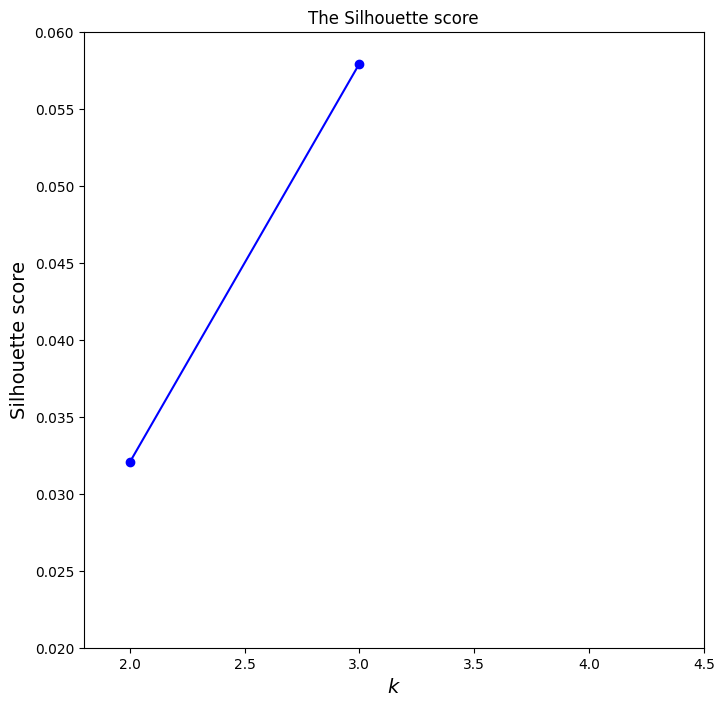

In [ ]:
# график silhouette_score для каждого количество кластеров
plt.figure(figsize=(8,8))
plt.plot(range(2, 4), silhouette_scores, "bo-")
plt.xlabel("$k$", fontsize=14)
plt.ylabel("Silhouette score", fontsize=14)
plt.axis([1.8, 4.5, 0.02, 0.06]) # переписать в зависимости от значений
plt.title('The Silhouette score')
plt.show()

TypeError: 'tuple' object is not callable

In [ ]:
embb(d10['cl_text'][29])

[0.06939697265625,
 0.0250701904296875,
 0.031402587890625,
 -0.0323486328125,
 -0.0960693359375,
 -0.06072998046875,
 0.04833984375,
 -0.059478759765625,
 0.0185699462890625,
 -0.045379638671875,
 0.060028076171875,
 -0.0207061767578125,
 -0.05108642578125,
 0.06158447265625,
 -0.1583251953125,
 0.06915283203125,
 0.1146240234375,
 -0.02655029296875,
 -0.052459716796875,
 -0.058380126953125,
 0.03839111328125,
 -0.01471710205078125,
 -0.043243408203125,
 0.0467529296875,
 0.0333251953125,
 -0.0212249755859375,
 -0.030731201171875,
 -0.0369873046875,
 0.1689453125,
 -0.01049041748046875,
 -0.1082763671875,
 0.0259552001953125,
 0.061187744140625,
 0.060089111328125,
 0.0006475448608398438,
 -0.03240966796875,
 0.038818359375,
 0.024932861328125,
 0.035736083984375,
 -0.0195465087890625,
 -0.0684814453125,
 0.043609619140625,
 0.0252685546875,
 0.01806640625,
 0.038604736328125,
 0.03875732421875,
 -0.08251953125,
 0.0732421875,
 -0.03326416015625,
 0.08380126953125,
 0.06207275390625,


In [ ]:
li = [s + '.' for s in d10['cl_text'][922].split('. ')]

In [ ]:
embeddings.embed_documents(li)

[[0.017333984375,
  -0.036651611328125,
  0.011993408203125,
  -0.0218505859375,
  0.05419921875,
  -0.01177215576171875,
  0.0283050537109375,
  -0.06500244140625,
  -0.01450347900390625,
  -0.1058349609375,
  0.06146240234375,
  -0.0460205078125,
  -0.053497314453125,
  -0.01459503173828125,
  -0.0482177734375,
  0.037200927734375,
  -0.06378173828125,
  -0.083984375,
  -0.049957275390625,
  0.004161834716796875,
  0.016632080078125,
  -0.038421630859375,
  -0.11212158203125,
  -0.0002827644348144531,
  0.0936279296875,
  0.0643310546875,
  -0.00113677978515625,
  -0.004741668701171875,
  0.10968017578125,
  0.04998779296875,
  -0.09600830078125,
  0.10205078125,
  -0.003753662109375,
  0.0017404556274414062,
  0.051422119140625,
  0.007068634033203125,
  -0.01491546630859375,
  -0.09381103515625,
  0.04620361328125,
  0.01299285888671875,
  -0.0606689453125,
  0.100341796875,
  -0.0218048095703125,
  0.0160675048828125,
  -0.0386962890625,
  -0.0016469955444335938,
  -0.066955566406

In [ ]:
embeddings_model = YandexGPTEmbeddings()

In [ ]:
text = "В аннотации к вашей книге сказано, что вы предлагаете новый взгляд на «сущность денег»."
query_result = embeddings.embed_query(text)

In [ ]:
query_result

[0.00455474853515625,
 0.09619140625,
 -0.036224365234375,
 0.0272216796875,
 -0.10418701171875,
 -0.05364990234375,
 -0.02362060546875,
 -0.11090087890625,
 0.038055419921875,
 -0.006778717041015625,
 0.042266845703125,
 -0.013519287109375,
 -0.01279449462890625,
 0.06622314453125,
 -0.017059326171875,
 0.0176239013671875,
 -0.0023860931396484375,
 -0.06304931640625,
 -0.042572021484375,
 -0.14208984375,
 -0.0196380615234375,
 0.01641845703125,
 -0.145263671875,
 -0.01253509521484375,
 0.01229095458984375,
 0.01238250732421875,
 0.007080078125,
 0.0313720703125,
 0.10211181640625,
 -0.038726806640625,
 -0.038787841796875,
 -0.0118560791015625,
 0.0060577392578125,
 0.044464111328125,
 0.0255889892578125,
 0.048004150390625,
 -0.067138671875,
 -0.0144500732421875,
 0.03076171875,
 -0.054443359375,
 -0.1207275390625,
 0.07391357421875,
 -0.0007843971252441406,
 -0.06768798828125,
 -0.0189361572265625,
 0.07708740234375,
 0.0182037353515625,
 0.054901123046875,
 0.156494140625,
 0.021133

In [ ]:
doc_result = embeddings.embed_documents(["Это тестовый документ1", "Песня это совсем другой"])

In [ ]:
doc_result

[[0.032501220703125,
  0.035186767578125,
  0.0221710205078125,
  -0.058807373046875,
  0.0086517333984375,
  0.005687713623046875,
  -0.028350830078125,
  0.01093292236328125,
  0.06256103515625,
  -0.09954833984375,
  0.05328369140625,
  -0.042816162109375,
  -0.0253143310546875,
  -0.03363037109375,
  -0.07452392578125,
  0.15771484375,
  0.023468017578125,
  -0.04620361328125,
  -0.035797119140625,
  -0.01137542724609375,
  0.046875,
  -0.0838623046875,
  0.0288543701171875,
  -0.03515625,
  0.07464599609375,
  0.0675048828125,
  0.0171966552734375,
  -0.0450439453125,
  0.0743408203125,
  -0.02740478515625,
  -0.1575927734375,
  -0.1180419921875,
  -0.09246826171875,
  0.046234130859375,
  0.0262298583984375,
  -0.08538818359375,
  0.0208587646484375,
  0.0160064697265625,
  0.0882568359375,
  0.05078125,
  -0.031768798828125,
  0.0204925537109375,
  -0.04632568359375,
  -0.0462646484375,
  -0.0299224853515625,
  0.0830078125,
  -0.072021484375,
  0.006488800048828125,
  -0.049835

In [ ]:
l = d10['cl_text'].tolist()

In [ ]:
l[9]

'Разговор о китайской классике и о том какие смыслы она в себе хранит проще начать с начала с первого взгляда на китайское иероглифическое письмо Мы увидим пляску штрихов змеек уголков и точек линий толстых и тонких выгнутых и свернутых Эти живые дебри подчиняются высшему закону жизни закону бесконечного разнообразия где ничего не повторяется но все вечно возвращается Письмо это рассеивание утверждается в древнейшем китайском сочинении о каллиграфии появившемся во веке Графически знак иероглиф в китайском языке являет картину детей под крышей и древние китайцы конечно видели в нем идею множащегося потомства Весь людской род происходит от одного предка Но превращение не имеет ни образа ни идеи ни сущности Оно дает о себе знать в следе отсвете тени знаках бесследного Недаром древние китайцы возводили письмена к следам драконов и птиц Поистине древние мудрецы писали как курица лапой и надо очень постараться чтобы прочитать их заветы Мы имеем дело с миропониманием кардинально отличающимся 

In [ ]:
le = [len(t.split(' ')) for t in l]

In [ ]:
le

[1250, 2131, 1614, 692, 1477, 3065, 2691, 925, 1956, 2742]

In [ ]:
d10['emb'] = d10['cl_text'].apply(lambda x: embeddings.embed_query(x))


	status = StatusCode.INVALID_ARGUMENT
	details = "Error in session internal_id=f99203dd-e65399fd-5760321a-b5dd604&request_id=854566a9-59f9-4cd3-9f18-3829eba8b0ff&client_request_id=undefined&folder_id=b1ga5etrebst6oj2c9ca: number of input tokens must be no more than 2048, got 3521"
	debug_error_string = "UNKNOWN:Error received from peer ipv4:158.160.54.160:443 {created_time:"2024-11-16T15:53:17.59314887+00:00", grpc_status:3, grpc_message:"Error in session internal_id=f99203dd-e65399fd-5760321a-b5dd604&request_id=854566a9-59f9-4cd3-9f18-3829eba8b0ff&client_request_id=undefined&folder_id=b1ga5etrebst6oj2c9ca: number of input tokens must be no more than 2048, got 3521"}"
>.
	status = StatusCode.INVALID_ARGUMENT
	details = "Error in session internal_id=d7619935-4c75244d-a4500bc4-5f2f5416&request_id=5fcc8192-ecb6-4282-ab7c-71674664f15c&client_request_id=undefined&folder_id=b1ga5etrebst6oj2c9ca: number of input tokens must be no more than 2048, got 3521"
	debug_error_string = "UNKNOWN:Error 

_InactiveRpcError: <_InactiveRpcError of RPC that terminated with:
	status = StatusCode.INVALID_ARGUMENT
	details = "Error in session internal_id=9da043d-52296c20-9d52665-796e4e08&request_id=a54afa3a-01dc-4b39-8c4e-c21b817f4057&client_request_id=undefined&folder_id=b1ga5etrebst6oj2c9ca: number of input tokens must be no more than 2048, got 3521"
	debug_error_string = "UNKNOWN:Error received from peer ipv4:158.160.54.160:443 {created_time:"2024-11-16T15:53:53.746744609+00:00", grpc_status:3, grpc_message:"Error in session internal_id=9da043d-52296c20-9d52665-796e4e08&request_id=a54afa3a-01dc-4b39-8c4e-c21b817f4057&client_request_id=undefined&folder_id=b1ga5etrebst6oj2c9ca: number of input tokens must be no more than 2048, got 3521"}"
>

In [ ]:
l[2]
#le = embeddings.embed_documents(l)

'Наконец можно подвести итоги прошлого года: Книжная палата опубликовала статистику выпуска книг, а самое большое издательство страны провело пресс-конференцию по итогам своей обширной деятельности. Впрочем, есть и более интересные новости. Привет, застой Почти каждый год со времен кризиса 2008 года чиновники, отвечающие за российскую книжную индустрию, подводя итоги минувшего периода, говорили что-то типа «в следующем году заживем». Следующий год, правда, оказывался обычно хуже предыдущего. Производство книг падало, падало, и никакого дна не было видно. Но теперь, кажется, вот оно: Совокупный тираж книг и брошюр, выпущенных в прошлом году, составил 435 млн экземпляров. В позапрошлом году Книжная палата насчитала 432 млн экземпляров. То есть можно, если очень хочется, порадоваться росту почти в 0,7 %. Ничего катастрофического в таком тираже и правда нет — примерно столько же книг тридцать лет назад, в самом начале 1990-х годов, выпускала только-только освобождавшаяся от партийной цензу

In [ ]:
embeddings = []
for i in range(l):
  embeddings.append(embeddings.embed_query(l[i]).numpy())

TypeError: 'list' object cannot be interpreted as an integer

In [ ]:
def emb(text):
  return embeddings.embed_query(text)

In [ ]:
le = [embeddings.embed_query(t) for t in l]

	status = StatusCode.INVALID_ARGUMENT
	details = "Error in session internal_id=20608910-21c45478-c906f4ee-c390e79e&request_id=49ea27e5-b2e2-45e4-93d6-7ee9da199b68&client_request_id=undefined&folder_id=b1ga5etrebst6oj2c9ca: number of input tokens must be no more than 2048, got 2662"
	debug_error_string = "UNKNOWN:Error received from peer ipv4:158.160.54.160:443 {grpc_message:"Error in session internal_id=20608910-21c45478-c906f4ee-c390e79e&request_id=49ea27e5-b2e2-45e4-93d6-7ee9da199b68&client_request_id=undefined&folder_id=b1ga5etrebst6oj2c9ca: number of input tokens must be no more than 2048, got 2662", grpc_status:3, created_time:"2024-11-17T06:47:58.697252082+00:00"}"
>.
	status = StatusCode.INVALID_ARGUMENT
	details = "Error in session internal_id=f202cf09-af442a4b-89b734c0-1081dd42&request_id=97a3ccf7-0a90-45cb-b5f8-8d157b331f70&client_request_id=undefined&folder_id=b1ga5etrebst6oj2c9ca: number of input tokens must be no more than 2048, got 2662"
	debug_error_string = "UNKNOWN:Err

KeyboardInterrupt: 

In [ ]:
l[0]

'Генрих Август Винклер Веймар История первой немецкой демократии М РОССПЭН За четырнадцатилетний промежуток между Германской империей и Третьим рейхом в Германии происходят заметные сдвиги в культуре и эмансипация от реакционной имперской морали Впрочем триумф авангарда и становление экспериментальных наук мало волнуют немецкое население страдающее от гиперинфляции безработицы и национального унижения Отношение к демократии в массовом сознании постепенно дрейфует ближе к отвращению и стыду эта форма правления ассоциируется с непрекращающейся руганью в парламенте чередой правительственных кризисов оскорбительными условиями Версальского договора аннексией Рурской области и расцветом радикальных политических программ справа и слева Основной вопрос которым задается историк Генрих Август Винклер в своей книге выпущенной на русском языке несправедливо скромным тиражом Веймар История первой немецкой демократии как немецкая демократия сделала возможным приход Гитлера к власти На первый план св

In [ ]:
embeddings.embed_query(l[0])

	status = StatusCode.INVALID_ARGUMENT
	details = "Error in session internal_id=3aac2241-70f1a07-50aa6bd0-fa04d9ae&request_id=09eade32-1009-41ae-bfcb-6757ce83aaef&client_request_id=undefined&folder_id=b1ga5etrebst6oj2c9ca: number of input tokens must be no more than 2048, got 2662"
	debug_error_string = "UNKNOWN:Error received from peer ipv4:158.160.54.160:443 {grpc_message:"Error in session internal_id=3aac2241-70f1a07-50aa6bd0-fa04d9ae&request_id=09eade32-1009-41ae-bfcb-6757ce83aaef&client_request_id=undefined&folder_id=b1ga5etrebst6oj2c9ca: number of input tokens must be no more than 2048, got 2662", grpc_status:3, created_time:"2024-11-17T06:48:10.862952511+00:00"}"
>.
	status = StatusCode.INVALID_ARGUMENT
	details = "Error in session internal_id=6c0378b8-17a617ca-88a57051-f54cfec4&request_id=eef4f92e-64ad-44fb-9975-541cf082996b&client_request_id=undefined&folder_id=b1ga5etrebst6oj2c9ca: number of input tokens must be no more than 2048, got 2662"
	debug_error_string = "UNKNOWN:Error

KeyboardInterrupt: 

In [ ]:
l[0]

'Daisy Dunn. In the Shadow of Vesuvius: A Life of Pliny. HarperCollins Publishers, 2019 Дэйзи Данн, молодая звезда английских Classical Studies, автор остроумной биографии Катулла «Catullus’ Bedspread: The Life of Rome’s Most Erotic Poet» («Покрывало Катулла: жизнь самого эротического поэта Рима», 2016), опубликовала в 2019 году второе жизнеописание знаменитого римлянина, а именно Плиния Младшего. Эта компактная и эрудированная работа под названием «In the Shadow of Vesuvius: A Life of Pliny» («В тени Везувия: жизнь Плиния»; в американской версии — «The Shadow of Vesuvius», «Тень Везувия») уже успела получить престижную премию британских классицистов The Classical Association Prize и наверняка соберет еще немало ученых наград. При этом книга написана для широкой аудитории, и читать ее — большое удовольствие. Плиний Младший (61 — ок. 113) — римский юрист и магистрат, друг историка Тацита и легат императора Траяна, оставивший потомству две с половиной сотни писем. Из плиниевых «Epistulae

In [ ]:
long_text = 'В первую очередь я хочу рассказать о серии «Эпоха войн и революций», в которой вышло уже более десяти книг. Ее замысел — писать о войне в широком смысле этого слова. Не совсем понятно, когда началась Первая мировая, хотя вроде бы эта дата фиксированная. Если бы я затевал эту серию сейчас, то расширил бы ее рамки, потому что непонятно и то, когда эта война закончилась. В этой серии мы стараемся посмотреть на Первую мировую войну не только через участие в ней России — нас интересует нечто более глобальное. Сегодня я остановлюсь лишь на нескольких новых книгах из этой серии. Джей Уинтер, «Места памяти, места скорби. Первая мировая война в культурной истории Европы». Содержание. Фрагмент В последние несколько десятилетий возникла интеллектуальная мода на memory studies. У гуманитарных «исследований памяти» уже существует международная ассоциация со своим каноном — но оспариваемым, потому что у кого-то один канон, у кого-то другой. Эта мода докатилась и до России. Хотя у нас это скорее переводные сборники статей, а не собственные отечественные монографии. Тут пока мало чем хвастаться, хотя кое-что свое у нас есть: в Европейском университете несколько лет функционирует Центр изучения культурной памяти и символической политики, которым руководят Владимир Викентьевич Лапин и Алексей Миллер. Бум memory studies обычно связывают с серединой 1980-х — это в первую очередь проект Пьера Нора «Места памяти» и творчество Яна и Алейды Ассманов. Какие-то вещи начались раньше, и в значительной степени начались они с памяти о Первой мировой. Прорывная книга, опубликованная в 1975 году, — «Великая война и современная память» историка литературы Пола Фассела. Согласно Фасселу, Первая мировая война была «невиданной войной»: невиданной по масштабам, по массовым убийствам и языку описания вооруженных конфликтов. Язык, который существовал, до этого принадлежал к романтической или реалистической традиции, но его не хватало для описания Первой мировой. Возник совершенно новый язык описания, где очень важны сарказм, абсурд и так далее. Историку не всегда просто читать книгу Фассела. Местами она очень провокативна и написана совершенно не так, как пишут историки. Она во многих отношениях уязвима, но тем не менее с 1975 года выдержала несколько десятков изданий. Это редкая судьба для научной книги, которая живет уже почти пятьдесят лет и переиздается снова и снова. Работа Фассела спровоцировала многих других историков, одним из которых был Джей Уинтер. Если отбирать сборную мира по изучению Первой мировой войны, то англо-американский историк Джей Уинтер безусловно войдет в нее. Его «Места памяти, места скорби» — отчасти ответ на книгу Фассела, которого он лично знал. В описании Первой мировой часто используются сравнения, компаративистика там работает очень серьезно. Один из проектов, в котором Уинтер участвовал наряду с французскими и другими коллегами, — это огромный двухтомник «Париж, Лондон, Берлин». Историки из разных стран брали какой-то сюжет (например, людей, которые наживаются на войне) и раскрывали его на примере каждой из трех столиц, вынесенных в заглавие. Очень интересный интеллектуальный вызов. Это было сложно, потому что источники разных стран иногда совершенно несопоставимы. Где-то сильна местная история, местные архивы, и архивная, источниковая база получается очень разная. Уинтер спорит с Фасселом. Он говорит: да, Фассел сделал отличные вещи, но его важнейший источник — это в первую очередь творчество англоязычных поэтов времен Первой мировой войны. Вы знаете, что для англичан военная поэзия — особая тема коллективной памяти, восприятия войны. У нас после Второй мировой возникла лейтенантская проза, а у них была лейтенантская поэзия. Кому из английских писателей посвящено наибольшее количество исследований филологов и историков литературы? Шекспиру. Шекспир — это их все. А на втором месте по количеству статей, книг и исследований — Уилфред Оуэн, поэт, погибший незадолго до окончания войны. И его поэзия многим англичанам хорошо известна. Уинтер пишет: Фассел провел важное исследование, но оно не позволяет понять очень многое. С точки зрения Уинтера, колоссальная проблема, с которой должны были столкнуться люди, — проблема скорби об ушедших. Чтобы понять, как люди пытались преодолеть утрату, скорбь, потерю, Уинтер вновь сравнивает немецкие, английские, французские случаи, иногда привлекая примеры из литературы, кино, искусства, а один параграф посвящен спиритизму... Для тех, кто интересуется культурой Первой мировой войны и проблемами памяти, эта книга очень важна. Исследования Уинтера могут дать импульс развитию российской историографии, в том числе изучению поднятых им тем на российском материале. «Слова и конфликты. Язык противостояния, эскалация Гражданской войны в России». Содержание. Рецензия Этот сборник статей возник как результат коллективной работы. Мы с группой моих коллег, в большей степени так или иначе связанных с Европейским университетом в Санкт-Петербурге, пытались изучать культурные предпосылки Гражданской войны в России. Начать Гражданскую войну непросто, ее нужно подготовить, в том числе в культурном отношении: сформировать образ врага, сделать легитимным массовое насилие и прочее. Большая часть статей в сборнике посвящена языку Гражданской войны. У Анатолия Шмелева есть книга «Внешняя политика правительства адмирала Колчака (1918—1919)». Он написал для нас статью, которая посвящена описаниям революции и Гражданской войны как смуты. Не все люди были готовы назвать революцию революцией. Некоторые по разным причинам табуировали это слово или связывали революцию с идеями прогресса, у некоторых термин «революция» имел позитивную эмоциональную коннотацию, и они не готовы были описывать то, что происходило, как революцию. Так что слово «смута» употреблялось очень часто и вошло в историографию и мемуаристику, например — «Очерки русской смуты» Деникина. Некоторые историки и сейчас по разным причинам предпочитают называть события революции и Гражданской войны смутой, например Владимир Булдаков делает это в своей книге «Красная смута». Есть еще два интересных, на мой взгляд, сюжета. В разной степени их затрагивают Михаил Разиньков и Иван Саблин, автор книги «Дальневосточная республика. От идеи до ликвидации». Их мысль кажется мне очень здравой: наше видение революции и Гражданской войны очень телеологично, но мы знаем, что произошло, и все предшествующее этому является необходимой предпосылкой, что свидетельствует о некоторой безальтернативности сценария. У Разинькова есть книга «Социально-политический диалог в России (1917—1918 гг.). Тенденции, механизм, региональные особенности», которую он написал в соавторстве с Ольгой Морозовой, очень талантливой ростовской исследовательницей, но эта книга, на мой взгляд, очень уязвимая, и его статья из сборника «Слова и конфликты» меня удовлетворяет больше. Он пытается показать такие ситуации, когда были попытки предотвращения или локализации Гражданской войны. Это очень интересно. Иван Саблин тоже говорит об идее и практике парламентаризма как локальных попытках сдержать или прекратить Гражданскую войну. По итогу они оказались не очень удачными, но служили векторами, которые нужно было учитывать. Дмитрий Иванов опубликовал в нашем сборнике две статьи. Одна из них посвящена понятию «республика», использованию этого слова во времена революции и Гражданской войны. Республик тогда был очень много, был «парад суверенитетов». Иванов специально занимался Шлиссельбургской республикой, власти которой бросили вызов центральной власти. После нее возникли Кронштадская, Кирсановская, Царицынская республики, которые не всегда руководились большевиками, но бросали вызов центральной власти. Он анализирует слово «анархия», которое использовалось в негативном смысле: все друг друга обвиняли в анархизме, кроме самих анархистов. Ёсиро Икэда, японский исследователь, написал про понятие «гражданин», которое тоже было немаловажным для Гражданской войны. Константин Тарасов подготовил две статьи, посвященные понятию «большевик». Казалось бы, какой смысл: большевики — они и есть большевики. Но дело в том, что это слово использовалось в самых разных значениях и приобретало самые разные смыслы. Иногда так маркировались люди, которые не имели ничего общего между собой и даже не были членами партии большевиков. Иногда это был синоним некоего политического радикализма. Так, украинских национальных активистов, например, называли украинскими большевиками, хотя, конечно, никакими большевиками они не являлись. Еще более парадоксально эта тема развита в статье Павла Рогозного про церковный большевизм. Рогозный занимается политической историей РПЦ, у него есть хорошая книга — «Церковная революция 1917 года». Словосочетание, которое кажется странным, непривычным, но на самом деле это словосочетание эпохи, и оно точно отражает смысл того, что происходило во многих епархиях РПЦ, где бросали вызов власти епископов: иногда свергали, иногда избирали новых, применяя совершенно разные политические технологии. Конечно, в церкви большевиков не было. Это не то, что потом называли «церковным большевизмом», имея в виду течения обновленцев, которые в той или иной степени были организованы советским аппаратом или спецслужбами. Речь идет об использовании понятия в 1917 году. Сторонников радикального обновления православной церкви их политические противники именовали церковными большевиками. Это разговор о том, как гиперполитизация общества и политический язык вникает в конфликты, где, казалось бы, им нет места. С одной стороны, одни именуют других церковными большевиками, а с другой стороны — некоторые радикалы именуют своих оппонентов церковной буржуазией. Некоторые нижние церковные служащие говорят: мы являемся церковным пролетариатом. Культурная гегемония социалистов, которая проявилась почти сразу же после Февральской революции, влияла на язык вот этих конфликтов. Александр Резник написал про влияние культуры Гражданской войны на формирование культа вождя. Вообще, несколько людей в нашей команде занимаются тем, что можно было бы назвать культурой вождизма в годы Гражданской войны, это одно из наших направлений. Но более актуальным является другой проект, и о нем статья Константина Годунова. Кстати, одна из его книг тоже выйдет в нашей серии. Она посвящена празднованиям 7 ноября во время Гражданской войны: как и что там было. Мне кажется, она немного корректирует представление историографии на этот счет. В будущем мы хотим сделать книгу, посвященную политическому использованию понятия гражданской войны в различных конфликтах — когда и кем оно использовалось, какие цели ставились, как это понималось, какие слова использовались вместо слов «гражданская война». Забегая вперед, говоря о ненаписанной книге, но уже написанных некоторых статьях: мне всегда приятно, когда источники опровергают первоначальную гипотезу. Потому что гипотеза основана на каком-то общем представлении, а когда выводы оказываются контринтуитивными, это кажется доказательством того, что мы нашли что-то верное и интересное. И с понятием «гражданская война» тоже нашлись неожиданные вещи. Существует огромное количество дискуссий, иногда идеологизированных, иногда более-менее академических по поводу того, когда и как началась Гражданская война. Мы не претендуем на то, чтобы ответить на этот вопрос окончательно, но для полного и объемного ответа, мне кажется, нам необходимо изучать язык того времени, давать переводы и интерпретировать его. Этот сборник демонстрирует наше движение. Так что, с одной стороны, это некоторый финал, но с другой — промежуточный этап работы. Так что это не конец. Вопросы из зала — В серии «Эпоха войн и революций» выходил сборник статей «Культуры патриотизма в период Первой мировой войны». Насколько в книжке Уинтера схожие сюжеты, пишет ли он про коммеморацию патриотизма? — Прямо по патриотизму, конечно, нет. Но есть общий знаменатель — соединение политической и культурной истории, это есть во многих статьях сборника. Вроде бы книга здорово разошлась, по-моему, она уже распродана. В серии выйдет еще несколько книг. Я уже говорил о том, что мы ждем книгу Константина Годунова, еще готовится книга Петра Николаевича Гордеева, посвященная Кронштадту в 1917 году. Кронштадт — совершенно особое место. Гордеев его знаток, он уточнял все по разным архивам, нашел в том числе фото. Я его очень долго мучил, старался, чтобы он диссертацию превратил в книгу, отчасти я его убедил. Надеюсь, она тоже получится интересной. — Я услышал такое понятие — «церковная революция». Объясните подробнее, как его понимать? — После первой русской революции и во время первой революции возникали попытки соединения христианства и социализма, православия и революции. Было, например, создано «Христианское братство борьбы». Павел Рогозный пишет о том, что свержение монархии было для церкви и для верующих колоссальной проблемой и на уровне организации, и на уровне символики. На уровне символики: есть ежедневная церковная служба, на которой нужно поминать царскую фамилию. Сначала было вообще непонятно, что делать — кто-то опускал царскую фамилию, кто-то поминал, и иногда это кончалось очень жестокими конфликтами: священники рисковали иногда чуть ли не жизнью. Но самое главное не в этом. До революции царь был главой православной церкви. Царя нет. Как реорганизоваться православной церкви? Некоторые лоббировали реформы: кто-то был сторонником патриаршества, кто-то был сторонником чего-то другого. Церковь была в состоянии острого кризиса, который сопровождался еще и тем, что ни в какой сфере общественной жизни влияние Григория Распутина не было так сильно, как в управлении Православной церковью. И некоторые епископы Православной церкви имели репутацию распутинцев: иногда заслуженную, иногда нет. Пошла волна свержения епископов, в епархиях на разных уровнях разгорелись конфликты. Да, сейчас нам термин «церковная революция» кажется очень странным, но для некоторых современников он был вполне естественным, хотя при этом нужно помнить, что некоторые из тех, кто использовал это словосочетание, не рассматривали это явление со знаком плюс. — О выборе исследовательской оптики memory studies. Может быть, для вас как для исследователя, историка есть какие-то нюансы в исследовательской практике, которые вы приметили или, наоборот, не заметили. Есть пример того, что больше всего запомнилось при работе с источниками? — Тут скорее не работа с источниками, а возможность взглянуть на источники по-другому. У меня в жизни было одно такое историографическое озарение. Я тогда числился в Кембриджском университете и ходил на лекции Тима Бланнинга по французской революции. Тим Бланнинг — очень хороший методист, у него всегда замечательно были подготовлены хэндауты, слайды. Он пришел и говорит: сегодня я сомневаюсь, стоит ли вам читать литературу, которую вам рекомендуют, это что-то такое неоднозначное. Я думаю: ах так, неоднозначная! Естественно, в перерыве я побежал эту неоднозначную литературу искать. И прочитал книгу Линн Хант Politics, Culture, and Class in the French Revolution — о политической культуре французской революции, где достаточно много написано в том числе про политическую порнографию. Я подумал: а сколько до этого я выкидывал источников, потому что считал это только слухами, а не чем-то достоверным? И я занялся слухами. Кому-то это понравилось, а кому-то нет. Иногда люди верят слухам и действуют в соответствии со слухами, когда слухи овладевают миллионами или когда слухами руководствуются в генеральных штабах или министерствах. Война в Ираке, например. Причиной стал слух, пущенный, возможно, иранскими спецслужбами, как некоторые полагают. Роль слухов очень велика. С памятью немного другое. Борис Колоницкий   Потом я решил поставить эксперимент на самом себе. Я задумал статью, где попытался сравнить политику памяти в Гельсингфорсе и Севастополе в 1917 году. Почему я решил сравнивать Гельсингфорс и Севастополь? Мне кажется, они похожи. Гельсингфорс — главная база балтийского флота, Севастополь — черноморского. И там и там есть моряки, которые озабочены символикой, ритуалами, традициями, и там и там существует особая память о Первой русской революции. Там восстание в Свеаборге, в Севастополе — лейтенант Шмидт и броненосец «Потемкин». У меня была в голове гипотеза, которая отчасти подтвердилась. И я нашел там то, чего в наших представлениях прежде не было: Февральская революция и Севастопольский совет, чем они занимались. Идет Первая мировая война, идет революция. А они снаряжают специальный военный корабль на остров Березань для того, чтобы устроить там археологическую экспедицию — найти трупы лейтенанта Шмидта и его соратников. Они перекопали остров, нашли эти трупы, положили в шикарные гробы, провозили по черноморским портам — Очаков, Одесса... Привезли в Севастополь. В Севастополе это был общенациональный праздник: пушки палят, гидросамолеты летают, огромные толпы с красными знаменами, букетами цветов, венками. Первый человек на похоронах — адмирал Колчак, командующий черноморским флотом. В глубине души он ненавидел Шмидта и презирал его, но он должен был возглавлять похороны, потому что шла борьба за власть, а кто первый идет за гробом, тот и главный. Но дело в том, что многие сторонники Колчака описывали его как продолжателя идей лейтенанта Шмидта, и он особенно не возражал. Память о революционном прошлом была политическим ресурсом, который старались использовать люди, даже полные оборонщики. Если бы я не применил такую оптику, то не обнаружил бы этого. Ни один биограф Колчака, насколько мне известно, об этих эпизодах не пишет. Одни не пишут об этом, поскольку белый адмирал, нехорошо... Но очень многие белые стали лидерами белых потому, что в 1917 году какое-то время они побыли немножко красными, то есть использовали революционную символику. Не только Колчак, но и Корнилов с красным знаменем начинал наступление. Ему нужно было мобилизовать солдат, и для него не было никаких табу — все, что работало, он использовал. Почему я занимаюсь memory studies? Во-первых, многое в политической истории мы не поймем, если мы не будем этим заниматься, во-вторых, это дает историкам возможность подключить иные источники и позабавиться на территории смежников, потому что память дает возможность подключить то, что делали раньше, какие источники собрали филологи, историки искусства, антропологи. И третья причина — это мой личный путь, моя личная возможность отомстить обществу. Потому что общество на историков, как правило, плюет. Нашей экспертизой часто пренебрегают. Изучение того, как работала раньше память общества, показывает современное общество в зеркале. Потому что ошибки, которые совершались тогда, сейчас тоже совершаются. — Говорят, история движется по спирали. Первая мировая война, огромный кризис. Голод, Гражданская война, не только в России, но и в других местах, в Германии. Люди думают о безопасности, чтобы не повторялось ничего подобного. Создается Лига наций. К 1939 году она перестает справляться с обязанностями, опять кризис, повторяется все та же история, и появляется новая Лига наций в виде ООН. Сейчас тоже такой кризис, по-видимому. Как вы думаете, будет повторение того, что, может быть, ООН дадут больше полномочий, но на самом деле это не будет мерой безопасности, как в прошлом, но люди будут в такой эйфории, что мало не покажется? Потом произойдут некоторые «события». — Если я понял вопрос, речь идет о кризисе ООН, который ощущается очень многими. Я не такой уж большой специалист по современным международным отношениям, но, насколько понимаю, есть некоторый консенсус, что ООН нужно реформировать. А как ее реформировать? Тут начинается разлад: кого включать на правах постоянных членов в Совет безопасности? Насчет англо-американского мира, что тут сказать, посмотрим. Мир становится все более сложным с каждым днем, и вызовы становятся совершенно непредсказуемыми. Но, опять-таки, я плохой предсказатель и не обладаю компетенциями, я не анализирую так международные отношения. Хотя Лигу наций породил американский президент Вудро Вильсон, сами США в Лигу не вошли, то есть она была не универсальной. Она была еще менее эффективной, чем ООН. Наделят ли ООН дополнительными полномочиями? Нет, не наделят, потому что в этом не заинтересован никто из главных международных игроков. Тут я готов предсказывать.'

In [ ]:
cl_text(ll[0][0])

['академический',
 'проект',
 'петербургский',
 'издательство',
 'организовать',
 'игорь',
 'немировский',
 '1993',
 'путать',
 'одноименный',
 'московский',
 'издательство',
 'основать',
 '1997-м',
 'более',
 'десятилетний',
 'история',
 'свой',
 'существование',
 'выпустить',
 'целый',
 'классический',
 'труд',
 'вадим',
 'вацуро',
 'борис',
 'бухштаб',
 'другой',
 'прорубить',
 'российский',
 'читатель',
 'окно',
 'европа',
 'серия',
 'современный',
 'западный',
 'русистика',
 'реанимировать',
 'легендарный',
 'серия',
 'библиотека',
 'поэт',
 'спустя',
 'четверть',
 'проще',
 'оценить',
 'масштаб',
 'культурный',
 'задача',
 'который',
 'взять',
 'себя',
 'академический',
 'проект',
 'который',
 'тогда',
 'казаться',
 'невыполнимый',
 'восполнить',
 'множество',
 'пробел',
 'отечественный',
 'гуманитаристика',
 'сформировать',
 'собственный',
 'профиль',
 'отличный',
 'другой',
 'издательство',
 'заниматься',
 'интеллектуальный',
 'литература',
 'игорь',
 'немировский',
 'ныне',
 '

In [ ]:
text = 'Юрию Нагибину нужно временно растворяться в природе'
doc = Doc(text)
doc.segment(segmenter)
 22%|██▏       | 951/4253 [27:25<1:38:33,  1.79s/it]
 22%|██▏       | 952/4253 [27:26<1:33:10,  1.69s/it]
 22%|██▏       | 953/4253 [27:28<1:40:27,  1.83s/it]
 22%|██▏       | 954/4253 [27:31<1:47:50,  1.96s/it]
 22%|██▏       | 955/4253 [27:32<1:37:10,  1.77s/it]
 22%|██▏       | 956/4253 [27:33<1:30:37,  1.65s/it]
 23%|██▎       | 957/4253 [27:35<1:40:25,  1.83s/it]
 23%|██▎       | 958/4253 [27:38<1:52:37,  2.05s/it]
 23%|██▎       | 959/4253 [27:39<1:40:32,  1.83s/it]
 23%|██▎       | 960/4253 [27:40<1:28:22,  1.61s/it]
 23%|██▎       | 961/4253 [27:43<1:44:01,  1.90s/it]
 23%|██▎       | 962/4253 [27:45<1:40:12,  1.83s/it]
 23%|██▎       | 963/4253 [27:47<1:51:27,  2.03s/it]

[ ]

doc.tag_morph(morph_tagger)
doc.parse_syntax(syntax_parser)
doc.tag_ner(ner_tagger)

for token in doc.tokens:
  token.lemmatize(morph_vocab)
for span in doc.spans:
  span.normalize(morph_vocab)

In [ ]:
ll2 = [t.lemma for t in doc.tokens if t not in stop_words]
[t for t in ll2 if len(t)>3]

['юрий', 'нагибин', 'нужный', 'временно', 'растворяться', 'природа']

In [ ]:
Юрию Нагибину нужно временно растворяться в природе

['и',
 'в',
 'во',
 'не',
 'что',
 'он',
 'на',
 'я',
 'с',
 'со',
 'как',
 'а',
 'то',
 'все',
 'она',
 'так',
 'его',
 'но',
 'да',
 'ты',
 'к',
 'у',
 'же',
 'вы',
 'за',
 'бы',
 'по',
 'только',
 'ее',
 'мне',
 'было',
 'вот',
 'от',
 'меня',
 'еще',
 'нет',
 'о',
 'из',
 'ему',
 'теперь',
 'когда',
 'даже',
 'ну',
 'вдруг',
 'ли',
 'если',
 'уже',
 'или',
 'ни',
 'быть',
 'был',
 'него',
 'до',
 'вас',
 'нибудь',
 'опять',
 'уж',
 'вам',
 'ведь',
 'там',
 'потом',
 'себя',
 'ничего',
 'ей',
 'может',
 'они',
 'тут',
 'где',
 'есть',
 'надо',
 'ней',
 'для',
 'мы',
 'тебя',
 'их',
 'чем',
 'была',
 'сам',
 'чтоб',
 'без',
 'будто',
 'чего',
 'раз',
 'тоже',
 'себе',
 'под',
 'будет',
 'ж',
 'тогда',
 'кто',
 'этот',
 'того',
 'потому',
 'этого',
 'какой',
 'совсем',
 'ним',
 'здесь',
 'этом',
 'один',
 'почти',
 'мой',
 'тем',
 'чтобы',
 'нее',
 'сейчас',
 'были',
 'куда',
 'зачем',
 'всех',
 'никогда',
 'можно',
 'при',
 'наконец',
 'два',
 'об',
 'другой',
 'хоть',
 'после',
 'на